# import packges

In [4]:
library(DESeq2)
library(data.table)
library(dplyr)
library(TxDb.Hsapiens.UCSC.hg38.knownGene)
library(clusterProfiler)
library(AnnotationDbi)
library(org.Hs.eg.db)
library(GSVA)
library(ggplot2)
library(gridExtra)
library(RColorBrewer)
library(IRdisplay)
library(GGally)
library(ChIPpeakAnno)
library(universalmotif)
library(IRdisplay)
library(ggpubr)
library(DiffBind)
library(kableExtra)
library(tidyverse)
library(ggraph)
library(tidygraph)
library(readxl)
library(corrplot)
library(ggrepel)
library(msigdbr)
library(fgsea)
library(ggvenn)
library(ComplexHeatmap)
library(ggVennDiagram)
library(venneuler)
library(sva)
library(DT)
library(tools)
library(tidyverse)
library(RSQLite)

library(edgeR)

txdb <- TxDb.Hsapiens.UCSC.hg38.knownGene

source('~/script/utils.r')
base_dir = '/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/pediatrics/'

data_dir = '/research/groups/jxugrp/home/common/Data_Public/StJude_Cloud/PanAML_n887_from_Jeff_Klco/' 
PP = 'beat'

setwd(base_dir)

In [5]:
aml_genes = c('TET2',  'DNMT3A',  'SF3B1',  'TP53',  'PPM1D',  'ASXL1',  'NRAS', 
  'JAK2',  'GNB1',  'KRAS',  'CBL',  'IDH1',  'IDH2') 


In [82]:
getwd()

[1] "/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/pediatrics"

# design table & bam file source

## original 887 list

In [83]:
dsn = as.data.table(read_xlsx('/research_jude/rgs01_jude/groups/jxugrp/home/common/Data_Public/StJude_Cloud/PanAML_n887_from_Jeff_Klco/PanAML_n887_from_Jeff_Klco_BAMinfo_TARGET-AMLNKD-blank_18MAR24.xlsx'))
head(dsn, 3)

CompBio sampleID,CompBio PatientID,TBID,sample source,SJUID,Subject SJUID,Molecular-class,Defining alteration,BAM location,RNA-seqStrandedness,EGA link for RNAseq,EGA link for WGS,EGA link for WES,Cloud link for RNAseq,Cloud link for WGS,Cloud link for WES,Paper_source_RNAseq,Paper_source_WGS,Paper_source_WES
<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
SJCBF022_D,SJ007022,TB-03-2566,Peripheral Blood,SJHBBBCNKJK,SJHBBBMXN,CBFB-MYH11,CBFB-MYH11,/rgs01/reference/restricted/PCGP/GRCh37-lite/TRANSCRIPTOME/SJCBF022_D.bam,Unstranded,https://ega-archive.org/datasets/EGAD00001002530,https://ega-archive.org/datasets/EGAD00001000268,no WES,https://permalinks.stjude.cloud/permalinks/PCGP,https://permalinks.stjude.cloud/permalinks/PCGP,no WES,"Core Binding Factor Leukemias; Faber, Z.J. et al. Nature Genetics, 2016","Core Binding Factor Leukemias; Faber, Z.J. et al. Nature Genetics, 2016",no WES
SJCBF030_D,SJ007030,TB-97-1197,Bone Marrow,SJHBBBHD3NS,SJHBBB4RY,RUNX1-RUNX1T1,RUNX1-RUNX1T1,/rgs01/reference/restricted/PCGP/GRCh37-lite/TRANSCRIPTOME/SJCBF030_D.bam,Unstranded,https://ega-archive.org/datasets/EGAD00001002530,no WGS,https://ega-archive.org/datasets/EGAD00001002667,https://permalinks.stjude.cloud/permalinks/PCGP,no WGS,https://permalinks.stjude.cloud/permalinks/PCGP,"Core Binding Factor Leukemias; Faber, Z.J. et al. Nature Genetics, 2016",no WGS,"Core Binding Factor Leukemias; Faber, Z.J. et al. Nature Genetics, 2016"
SJCBF034_D,SJ007034,TB-03-1660,Bone Marrow,SJHBBBJ96HD,SJHBJ7ZPP,RUNX1-RUNX1T1,RUNX1-RUNX1T1,/rgs01/reference/restricted/PCGP/GRCh37-lite/TRANSCRIPTOME/SJCBF034_D.bam,Unstranded,https://ega-archive.org/datasets/EGAD00001002530,no WGS,https://ega-archive.org/datasets/EGAD00001002667,https://permalinks.stjude.cloud/permalinks/PCGP,no WGS,https://permalinks.stjude.cloud/permalinks/PCGP,"Core Binding Factor Leukemias; Faber, Z.J. et al. Nature Genetics, 2016",no WGS,"Core Binding Factor Leukemias; Faber, Z.J. et al. Nature Genetics, 2016"


In [6]:
colnames(dsn)

[1] "CompBio sampleID"      "CompBio PatientID"     "TBID"                 
 [4] "sample source"         "SJUID"                 "Subject SJUID"        
 [7] "Molecular-class"       "Defining alteration"   "BAM location"         
[10] "RNA-seqStrandedness"   "EGA link for RNAseq"   "EGA link for WGS"     
[13] "EGA link for WES"      "Cloud link for RNAseq" "Cloud link for WGS"   
[16] "Cloud link for WES"    "Paper_source_RNAseq"   "Paper_source_WGS"     
[19] "Paper_source_WES"

In [7]:
table(dsn$egad_id)

< table of extent 0 >

In [84]:
dsn[, target_id := 'None']
dsn[, target_id := {
    tmp = unlist(strsplit(.SD$TBID, '-'))
    if(grepl('TARGET', .SD$TBID)){
        paste(tmp[1:3], collapse = '-')
    }else{
       '' 
    }} , by = 1:nrow(dsn)]

In [85]:
dsn[, bam_file := `BAM location`]
dsn[, ega_rnaseq_link := `EGA link for RNAseq`]
dsn[, egad_id := sub('.*(EGAD.*)', '\\1', ega_rnaseq_link)]
dsn[, sampleID := sub('_.*', '', `CompBio sampleID`) ]
dsn[, PatientID := sub('_.*', '', `CompBio PatientID`) ]
dsn[, sSJUID := `Subject SJUID` ]
dsn[, subtype := `Molecular-class` ]

In [86]:
table(dsn$subtype)


               APL             BCL11B           BCR-ABL1          CBFB-GDXY 
                 4                 13                  1                  4 
        CBFB-MYH11              CEBPA         DEK-NUP214          ETSfamily 
                96                 49                 16                 16 
             GATA1              GLISr               HOXr             KAT6Ar 
                23                 28                 17                  7 
         KMT2A-PTD             KMT2Ar       MECOM/PRDM16               MNX1 
                14                180                 10                  5 
              NPM1             NUP98r              Other      PICALM-MLLT10 
                76                 71                 76                  8 
        RBM15-MKL1      RUNX1-RUNX1T1 RUNX1-RUNX1T1-like               UBTF 
                10                110                  3                 50 

## directly available: 110 cases

In [11]:
dim(dsn[file.exists(bam_file), ])

[1] 110  27

In [87]:
dsn[file.exists(bam_file), bam_file_id := bam_file ]
dsn[file.exists(bam_file), source := 'direct']

## find bam files from clinical server: total 673 cases

In [10]:
tmp1 = paste0('/research/rgs01/reference/restricted/ClinicalGenomics/GRCh37-lite/', fread('bam2_list', header = F)$V1)
tmp2 = paste0('/research/rgs01/reference/restricted/ClinicalGenomics/GRCh38/', fread('bam3_list', header = F)$V1)
tmp3 = paste0(fread('bam5_list', header = F)$V1)
bam_list = data.table(bam_file = c(tmp1, tmp2, tmp3))
bam_list[, id := sub('_.*', '', basename(bam_file))] 
bam_list[grep('WHOLE_GENOME', bam_file), target := 'WHOLE_GENOME' ]
bam_list[grep('EXOME', bam_file), target := 'EXOME' ]
bam_list[grep('TRANSCRIPTOME', bam_file), target := 'TRANSCRIPTOME' ]

head(bam_list) 
dim(bam_list)
table(bam_list$target)


bam_file,id,target
<chr>,<chr>,<chr>
/research/rgs01/reference/restricted/ClinicalGenomics/GRCh37-lite/./Clinical/2018/SJ030832/SJBALL030832_D1/WHOLE_GENOME/bam/SJBALL030832_D1.bam,SJBALL030832,WHOLE_GENOME
/research/rgs01/reference/restricted/ClinicalGenomics/GRCh37-lite/./Clinical/2018/SJ030832/SJBALL030832_D1/TRANSCRIPTOME/bam/SJBALL030832_D1.bam,SJBALL030832,TRANSCRIPTOME
/research/rgs01/reference/restricted/ClinicalGenomics/GRCh37-lite/./Clinical/2018/SJ030832/SJBALL030832_D1/EXOME/bam/SJBALL030832_D1.bam,SJBALL030832,EXOME
/research/rgs01/reference/restricted/ClinicalGenomics/GRCh37-lite/./Clinical/2018/SJ030832/SJBALL030832_G1/WHOLE_GENOME/bam/SJBALL030832_G1.bam,SJBALL030832,WHOLE_GENOME
/research/rgs01/reference/restricted/ClinicalGenomics/GRCh37-lite/./Clinical/2018/SJ030832/SJBALL030832_G1/EXOME/bam/SJBALL030832_G1.bam,SJBALL030832,EXOME
/research/rgs01/reference/restricted/ClinicalGenomics/GRCh37-lite/./Clinical/2018/SJ030889/SJBALL030889_D1/WHOLE_GENOME/bam/SJBALL030889_D1.bam,SJBALL030889,WHOLE_GENOME


[1] 40581     3


        EXOME TRANSCRIPTOME  WHOLE_GENOME 
        16545         10053         13625 

In [11]:
table(bam_list[id %in% dsn$sampleID, target])


        EXOME TRANSCRIPTOME  WHOLE_GENOME 
         1134          1041          1011 

In [14]:
tmp = bam_list[grep('TRANSCRIPTOME', target), ]
tmp = tmp[!duplicated(id), ]
setkey(tmp, 'id')
dsn[is.na(bam_file_id) & sampleID %in% tmp$id, source := 'internal' ]
ids = dsn[is.na(bam_file_id), sampleID]
dsn$bam_file_id[is.na(dsn$bam_file_id)] = tmp[ids, bam_file]
head(dsn[, .(sampleID, bam_file, bam_file_id) ], 3)

sampleID,bam_file,bam_file_id
<chr>,<chr>,<chr>
SJCBF022,/rgs01/reference/restricted/PCGP/GRCh37-lite/TRANSCRIPTOME/SJCBF022_D.bam,/rgs01/reference/restricted/PCGP/GRCh37-lite/TRANSCRIPTOME/SJCBF022_D.bam
SJCBF030,/rgs01/reference/restricted/PCGP/GRCh37-lite/TRANSCRIPTOME/SJCBF030_D.bam,/rgs01/reference/restricted/PCGP/GRCh37-lite/TRANSCRIPTOME/SJCBF030_D.bam
SJCBF034,/rgs01/reference/restricted/PCGP/GRCh37-lite/TRANSCRIPTOME/SJCBF034_D.bam,/rgs01/reference/restricted/PCGP/GRCh37-lite/TRANSCRIPTOME/SJCBF034_D.bam


In [15]:
table(dsn$source)


  direct internal 
     110      563 

In [16]:
dim(dsn[file.exists(bam_file_id), ])

[1] 673  29

In [17]:
datatable(dsn[source == 'internal', ])

HTML widgets cannot be represented in plain text (need html)

## dbGaP: 187 cases, total: 860 cases

In [18]:
dim(dsn[is.na(source) & ega_rnaseq_link == 'dbGaP', ]) 

[1] 187  29

In [19]:
673+187

[1] 860

In [20]:
dsn[is.na(source) & ega_rnaseq_link == 'dbGaP', source := 'dbGaP']

In [25]:
datatable(dsn[ega_rnaseq_link  == 'dbGaP', ])

HTML widgets cannot be represented in plain text (need html)

## left IDs: 27

In [26]:
table(dsn[is.na(source), egad_id])


EGAD00001003412 EGAD00001003782 EGAD00001008407   Not Available 
             14               2               2               9 

In [27]:
# former PI Sharyn Baker, /research/groups/formerPI/projects/SharynBaker/common/tartan/SharynBaker, 9
datatable(dsn[egad_id == 'Not Available' & is.na(source), .(sampleID, subtype, bam_file)])


HTML widgets cannot be represented in plain text (need html)

In [28]:
datatable(dsn[is.na(source) & egad_id == 'EGAD00001008407', .(sampleID, subtype, bam_file)])

HTML widgets cannot be represented in plain text (need html)

In [29]:
datatable(dsn[is.na(source) & egad_id == 'EGAD00001003782', .(sampleID, subtype, bam_file)])

HTML widgets cannot be represented in plain text (need html)

In [30]:
datatable(dsn[is.na(source) & egad_id == 'EGAD00001003412', .(sampleID, subtype, bam_file)])

HTML widgets cannot be represented in plain text (need html)

## additional bam file of internal access

In [31]:
tmp = fread('.clingen.index.orig')
datatable(head(tmp))

HTML widgets cannot be represented in plain text (need html)

In [32]:
dim(tmp)

[1] 43385    10

# clinical data

## GDC 

In [33]:
# from GDC
clin = as.data.table(readRDS('/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/collab_JinWang/bcat/data/target_aml_clin.rds') )
dim(clin)


[1] 2181  104

In [34]:
colnames(clin)

[1] "project"                                 
  [2] "submitter_id"                            
  [3] "disease_type"                            
  [4] "primary_site"                            
  [5] "submitter_id"                            
  [6] "irs_stage"                               
  [7] "iss_stage"                               
  [8] "ajcc_pathologic_stage"                   
  [9] "ann_arbor_clinical_stage"                
 [10] "created_datetime"                        
 [11] "enneking_msts_stage"                     
 [12] "treatments"                              
 [13] "inrg_stage"                              
 [14] "enneking_msts_metastasis"                
 [15] "tissue_or_organ_of_origin"               
 [16] "age_at_diagnosis"                        
 [17] "esophageal_columnar_dysplasia_degree"    
 [18] "cog_liver_stage"                         
 [19] "child_pugh_classification"               
 [20] "metastasis_at_diagnosis_site"            
 [21] "state"                                   
 [22] "prior_treatment"                         
 [23] "cog_rhabdomyosarcoma_risk_group"         
 [24] "days_to_last_known_disease_status"       
 [25] "primary_gleason_grade"                   
 [26] "inpc_grade"                              
 [27] "ajcc_pathologic_t"                       
 [28] "morphology"                              
 [29] "ajcc_pathologic_n"                       
 [30] "ajcc_pathologic_m"                       
 [31] "irs_group"                               
 [32] "medulloblastoma_molecular_classification"
 [33] "wilms_tumor_histologic_subtype"          
 [34] "residual_disease"                        
 [35] "weiss_assessment_score"                  
 [36] "classification_of_tumor"                 
 [37] "tumor_focality"                          
 [38] "ann_arbor_b_symptoms"                    
 [39] "icd_10_code"                             
 [40] "cog_renal_stage"                         
 [41] "figo_stage"                              
 [42] "synchronous_malignancy"                  
 [43] "burkitt_lymphoma_clinical_variant"       
 [44] "days_to_best_overall_response"           
 [45] "inss_stage"                              
 [46] "supratentorial_localization"             
 [47] "ishak_fibrosis_score"                    
 [48] "tumor_confined_to_organ_of_origin"       
 [49] "gleason_grade_group"                     
 [50] "days_to_diagnosis"                       
 [51] "goblet_cells_columnar_mucosa_present"    
 [52] "laterality"                              
 [53] "last_known_disease_status"               
 [54] "days_to_last_follow_up"                  
 [55] "primary_diagnosis"                       
 [56] "ajcc_clinical_stage"                     
 [57] "cog_neuroblastoma_risk_group"            
 [58] "updated_datetime"                        
 [59] "metastasis_at_diagnosis"                 
 [60] "enneking_msts_tumor_site"                
 [61] "prior_malignancy"                        
 [62] "year_of_diagnosis"                       
 [63] "secondary_gleason_grade"                 
 [64] "best_overall_response"                   
 [65] "ann_arbor_pathologic_stage"              
 [66] "ann_arbor_extranodal_involvement"        
 [67] "method_of_diagnosis"                     
 [68] "mitosis_karyorrhexis_index"              
 [69] "ajcc_staging_system_edition"             
 [70] "days_to_recurrence"                      
 [71] "esophageal_columnar_metaplasia_present"  
 [72] "ajcc_clinical_m"                         
 [73] "ajcc_clinical_n"                         
 [74] "ajcc_clinical_t"                         
 [75] "inpc_histologic_group"                   
 [76] "masaoka_stage"                           
 [77] "micropapillary_features"                 
 [78] "diagnosis_id"                            
 [79] "igcccg_stage"                            
 [80] "tumor_regression_grade"                  
 [81] "site_of_resection_or_biopsy"             
 [82] "first_symptom_prior_to_dia

In [35]:
head(clin[, .(submitter_id, disease_type)])

submitter_id,disease_type
<chr>,<chr>
TARGET-20-PAVWRR,Myeloid Leukemias
TARGET-20-PAVAFA,Myeloid Leukemias
TARGET-20-PAWACC,Myeloid Leukemias
TARGET-20-THP1,Myeloid Leukemias
TARGET-20-PAWWWM,Myeloid Leukemias
TARGET-00-RO02327,Not Applicable


In [36]:
table(clin$disease_type)


Myeloid Leukemias    Not Applicable 
             2119                62 

In [37]:
dim(clin[!duplicated(submitter_id),])

[1] 2181  104

In [38]:
dim(dsn[target_id %in% clin$submitter_id, ])
187 - 158

[1] 158  29

[1] 29

In [39]:
datatable(dsn[!(target_id %in% clin$submitter_id) & target_id != '', ])

HTML widgets cannot be represented in plain text (need html)

In [178]:
sel = unique(deg_telocal_MEPCMP[batch == 'CMP' & logFC > 2 & FDR < 0.01 & class_id == 'LTR', rn])
length(sel)


[1] 662

In [182]:
plotdat = gsva(expr = logcpm_beat_, list(CMP_up = sel))
plotdat = as.data.table(t(plotdat), keep.rownames = T)
head(plotdat)


Warning message in .filterFeatures(expr, method):
"12 genes with constant expression values throuhgout the samples."
Warning message in .filterFeatures(expr, method):
"Since argument method!="ssgsea", genes with constant expression values are discarded."


ERROR: Error in .mapGeneSetsToFeatures(gset.idx.list, rownames(expr)): No identifiers in the gene sets could be matched to the identifiers in the expression data.


## data shared from Gang

In [ ]:
fnames = c('TARGET_AML_ClinicalData_20160714.xlsx', 
           'TARGET_AML_SampleMatrix_Discovery_20160921.xlsx', 
           'TARGET_AML_SampleMatrix_InductionFailure_Discovery_20160923.xlsx', 
           'TARGET_AML_SampleMatrix_Validation_20160926.xlsx') 
gang1 = read_xlsx(paste0('/research/groups/jxugrp/home/common/Data_Public/TARGET_AML_Clinical_Data_from_GangWu/', fnames[1])) 
gang2 = read_xlsx(paste0('/research/groups/jxugrp/home/common/Data_Public/TARGET_AML_Clinical_Data_from_GangWu/', fnames[2])) 
gang3 = read_xlsx(paste0('/research/groups/jxugrp/home/common/Data_Public/TARGET_AML_Clinical_Data_from_GangWu/', fnames[3])) 
gang4 = read_xlsx(paste0('/research/groups/jxugrp/home/common/Data_Public/TARGET_AML_Clinical_Data_from_GangWu/', fnames[4])) 


In [321]:
dim(gang1)
dim(gang2)
dim(gang3)
dim(gang4)

[1] 993  63

[1] 446 100

[1] 32 64

[1] 627  20

In [322]:
range(gang1$`Year of Last Follow Up`)

[1] 1997 2015

In [323]:
dim(dsn[target_id %in% gang1$`TARGET USI`, ])

[1] 187  29

In [311]:
datatable(gang1)

HTML widgets cannot be represented in plain text (need html)

In [327]:
datatable(gang3)

HTML widgets cannot be represented in plain text (need html)

# explore St Jude genomic server 

In [ ]:
# https://platform.stjude.cloud/

In [329]:
mtx = fread('SAMPLE_INFO.tsv')
dim(mtx)

[1] 133579     38

In [331]:
datatable(mtx[1:5, ])

HTML widgets cannot be represented in plain text (need html)

# get manifest

In [337]:
library(TCGAbiolinks)

In [ ]:
query <- GDCquery(
    experimental.strategy = 'RNA-Seq',
    project = "TARGET-AML",
    data.category = "Sequencing Reads",
    data.type = "Aligned Reads",
    workflow.type = 'STAR 2-Pass Transcriptome',
    data.format = 'bam'
)
res = getManifest(query)

In [415]:
res = getResults(query)
dim(res)
head(res)


[1] 3225   31

,id,data_format,cases,access,file_name,wgs_coverage,submitter_id,data_category,type,platform,⋯,analysis_id,analysis_state,analysis_submitter_id,analysis_workflow_link,analysis_workflow_type,analysis_workflow_version,sample_type,is_ffpe,cases.submitter_id,sample.submitter_id
,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,⋯,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<lgl>,<chr>,<chr>
1,fc77614f-29a8-4b96-911f-7226eca2a9cd,BAM,TARGET-20-PASNIY-09A-02R,controlled,3f3a4e6b-a372-4e92-b38c-cf2283a4ed8d.rna_seq.transcriptome.gdc_realn.bam,Not Applicable,af4fa508-92db-4db9-a2bb-e8ef550c71ba,Sequencing Reads,aligned_reads,Illumina,⋯,9857e629-c7de-4811-bc97-8c3ce43aed82,released,3f3a4e6b-a372-4e92-b38c-cf2283a4ed8d_star_2pass_transcriptome,quay.io/ncigdc,STAR 2-Pass Transcriptome,61fd5ef8ab410a784da2e89eca063ca3c66998ec,Primary Blood Derived Cancer - Bone Marrow,NA,TARGET-20-PASNIY,TARGET-20-PASNIY-09A
2,519dc789-0d7b-4eee-9122-e890f642af7a,BAM,TARGET-20-PASNKC-09A-01R,controlled,4437f783-96e7-43a8-87ef-5fed5b4c91ab.rna_seq.transcriptome.gdc_realn.bam,Not Applicable,a62d34f5-ce24-4b2a-84d4-2fb3cdf12e79,Sequencing Reads,aligned_reads,Illumina,⋯,d2cb9715-670e-406e-8e7b-c4b521382fd3,released,4437f783-96e7-43a8-87ef-5fed5b4c91ab_star_2pass_transcriptome,quay.io/ncigdc,STAR 2-Pass Transcriptome,61fd5ef8ab410a784da2e89eca063ca3c66998ec,Primary Blood Derived Cancer - Bone Marrow,NA,TARGET-20-PASNKC,TARGET-20-PASNKC-09A
3,67052575-b8b9-489a-8c16-1f787167e2e0,BAM,TARGET-20-PASNLR-03A-01R,controlled,84bba567-4acc-4ee6-8f19-e15b7a87ed08.rna_seq.transcriptome.gdc_realn.bam,Not Applicable,ce7e87cd-4af5-43c4-8889-236e44929cd7,Sequencing Reads,aligned_reads,Illumina,⋯,d6d20a79-6562-47df-89de-5aa85b23dfc7,released,84bba567-4acc-4ee6-8f19-e15b7a87ed08_star_2pass_transcriptome,quay.io/ncigdc,STAR 2-Pass Transcriptome,61fd5ef8ab410a784da2e89eca063ca3c66998ec,Primary Blood Derived Cancer - Peripheral Blood,NA,TARGET-20-PASNLR,TARGET-20-PASNLR-03A
4,b087fa47-1236-42cf-a458-18cd0fdb8391,BAM,TARGET-20-PASNAL-09A-01R,controlled,039a1e3a-b7b6-4bc8-8c52-1c7f82cbaa62.rna_seq.transcriptome.gdc_realn.bam,Not Applicable,eb2ada28-91ae-444c-837f-baab8c44e5b4,Sequencing Reads,aligned_reads,Illumina,⋯,9d4ddfc1-4c8d-4cce-9db8-f1a8a9378e90,released,039a1e3a-b7b6-4bc8-8c52-1c7f82cbaa62_star_2pass_transcriptome,quay.io/ncigdc,STAR 2-Pass Transcriptome,61fd5ef8ab410a784da2e89eca063ca3c66998ec,Primary Blood Derived Cancer - Bone Marrow,NA,TARGET-20-PASNAL,TARGET-20-PASNAL-09A
5,ccb3a827-4ed0-47f8-9f1a-63aa31ba0e26,BAM,TARGET-20-PASNDA-09A-01R,controlled,5887ccad-c7a4-454a-9c50-d223bb144c78.rna_seq.transcriptome.gdc_realn.bam,Not Applicable,b9a58bce-5460-4730-83df-a366352e07f2,Sequencing Reads,aligned_reads,Illumina,⋯,8c232f2d-8c2f-4efb-a5d8-e575ad6553d3,released,5887ccad-c7a4-454a-9c50-d223bb144c78_star_2pass_transcriptome,quay.io/ncigdc,STAR 2-Pass Transcriptome,61fd5ef8ab410a784da2e89eca063ca3c66998ec,Primary Blood Derived Cancer - Bone Marrow,NA,TARGET-20-PASNDA,TARGET-20-PASNDA-09A
6,e4cf8d24-02f8-4aae-8f7c-a5c9868ca35a,BAM,TARGET-20-PASNYB-09A-01R,controlled,e0a2b8e3-f8fb-480c-96e6-bfca08f09934.rna_seq.transcriptome.gdc_realn.bam,Not Applicable,5790ada6-d1fd-42f4-b8a3-53fbb27dae50,Sequencing Reads,aligned_reads,Illumina,⋯,45617ee1-03e1-4886-8e99-b6891302f87c,released,e0a2b8e3-f8fb-480c-96e6-bfca08f09934_star_2pass_transcriptome,quay.io/ncigdc,STAR 2-Pass Transcriptome,61fd5ef8ab410a784da2e89eca063ca3c66998ec,Primary Blood Derived Cancer - Bone Marrow,NA,TARGET-20-PASNYB,TARGET-20-PASNYB-09A


In [418]:
saveRDS(query, file = 'target_aml_tcgabiolinks_gdcquery.rds')
saveRDS(res, file = 'target_aml_tcgabiolinks_gdcquery_res.rds')

In [416]:
tmp = query$results[[1]]
tmp = tmp[tmp$cases.submitter_id %in% dsn$target_id, ]
tmp = tmp[grep('rna_seq.transcriptome', tmp$file_name), ]
query2 = copy(query)
query2$results[[1]] = tmp
dim(tmp)

[1] 388  31

In [ ]:
# GDCdownload(query2, method = 'client')

In [ ]:
datatable(tmp)

In [389]:
fwrite(tmp, file = 'manifest_target_aml_rnaseq_transcriptome.tsv', sep = '\t')


In [ ]:
singularity run /research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/images/gdc-client_latest.sif gdc-client download -m ../manifest_left.tsv -t ~/gdc-user-token.2024-08-27T02_39_51.215Z.txt


In [ ]:
# download by gdc-client
# windows version works with gdc-tt by using remote desktop

In [471]:
dsn_gdc = as.data.table(copy(tmp))
dsn_gdc[, bam_file := paste0(data_dir, 'GDCdata/', id, '/', file_name) ] 
dsn_gdc = dsn_gdc[file.exists(bam_file), ]
dim(dsn_gdc)
# 388 -349 = 39 samples failed to download 
# an example of error 
# ERROR: f61709f4-da83-4a7e-b054-afc1d3003b61: 451 Client Error: 
# UNAVAILABLE FOR LEGAL REASONS for url: 
# https://api.gdc.cancer.gov/data/f61709f4-da83-4a7e-b054-afc1d3003b61: 
# {"message":"Request contains a redacted file(s): ['f61709f4-da83-4a7e-b054-afc1d3003b61'], action not allowed"}


[1] 349  32

In [476]:
dsn_gdc$bam_file[1]

[1] "/research/groups/jxugrp/home/common/Data_Public/StJude_Cloud/PanAML_n887_from_Jeff_Klco/GDCdata/1b49d8ae-99c5-4c3c-a8bd-c02c9b6f17d1/f1ff06b4-7c51-4bc0-9cd5-bde1eb1fdc33.rna_seq.transcriptome.gdc_realn.bam"

In [433]:
# left 32 bam files saved
tmp2 = dsn_gdc[!file.exists(bam_file), ]
fwrite(tmp2, file = 'manifest_left.tsv', sep = '\t')

In [524]:
dsn[grepl('TARGET', TBID), bam_file_id :=  dsn_gdc[dsn[grep('TARGET', TBID), target_id], bam_file] ]

In [526]:
file.exists(dsn_gdc[dsn[grep('TARGET', TBID), target_id], bam_file])

[1]  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE
 [13]  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE
 [25]  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE
 [37]  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE
 [49]  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE
 [61]  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE
 [73]  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE
 [85]  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE
 [97]  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE
[109]  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE
[121]  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE FALSE  TRUE
[133]  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE
[145]  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE
[157]  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE
[169]  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE
[181]  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE  TRUE

In [522]:
head(dsn[grepl('TARGET', TBID), bam_file_id])
head(dsn[, bam_file_id])

[1] "/research/groups/jxugrp/home/common/Data_Public/StJude_Cloud/PanAML_n887_from_Jeff_Klco/data//research/groups/jxugrp/home/common/Data_Public/StJude_Cloud/PanAML_n887_from_Jeff_Klco/GDCdata/3809a016-6c1b-4739-9951-6629682b36f0/5f025c7f-544c-414b-b7a8-85f54fd48731.rna_seq.transcriptome.gdc_realn.bam"
[2] "/research/groups/jxugrp/home/common/Data_Public/StJude_Cloud/PanAML_n887_from_Jeff_Klco/data//research/groups/jxugrp/home/common/Data_Public/StJude_Cloud/PanAML_n887_from_Jeff_Klco/GDCdata/b6161e32-8ef8-406e-8813-7ca08c486083/47e1b07e-5e7c-4285-a6ec-93a148e5a99f.rna_seq.transcriptome.gdc_realn.bam"
[3] "/research/groups/jxugrp/home/common/Data_Public/StJude_Cloud/PanAML_n887_from_Jeff_Klco/data//research/groups/jxugrp/home/common/Data_Public/StJude_Cloud/PanAML_n887_from_Jeff_Klco/GDCdata/0fd3fef8-c846-43d8-b94c-a26c4597c8d3/c3d9bcc9-9dce-4d46-92c8-5c1775e71354.rna_seq.transcriptome.gdc_realn.bam"
[4] "/research/groups/jxugrp/home/common/Data_Public/StJude_Cloud/PanAML_n887_from_Jeff_Klco/data//research/groups/jxugrp/home/common/Data_Public/StJude_Cloud/PanAML_n887_from_Jeff_Klco/GDCdata/dd6b9b74-fcdc-45e8-90a6-92d3f655d88a/fc1bf82f-6f66-4345-9a82-41c8c6371745.rna_seq.transcriptome.gdc_realn.bam"
[5] "/research/groups/jxugrp/home/common/Data_Public/StJude_Cloud/PanAML_n887_from_Jeff_Klco/data//research/groups/jxugrp/home/common/Data_Public/StJude_Cloud/PanAML_n887_from_Jeff_Klco/GDCdata/05de1780-aee0-4d6d-99fd-3de790b4af65/0c8bad99-ec20-4b12-8dc8-e7f9ec63305a.rna_seq.transcriptome.gdc_realn.bam"
[6] "/research/groups/jxugrp/home/common/Data_Public/StJude_Cloud/PanAML_n887_from_Jeff_Klco/data//research/groups/jxugrp/home/common/Data_Public/StJude_Cloud/PanAML_n887_from_Jeff_Klco/GDCdata/d5c2f55e-11af-4771-845b-1d0058f5f5cd/7510d09a-92a9-4825-ba5e-a86fd705295b.rna_seq.transcriptome.gdc_realn.bam"

[1] "/rgs01/reference/restricted/PCGP/GRCh37-lite/TRANSCRIPTOME/SJCBF022_D.bam"                                                                     
[2] "/rgs01/reference/restricted/PCGP/GRCh37-lite/TRANSCRIPTOME/SJCBF030_D.bam"                                                                     
[3] "/rgs01/reference/restricted/PCGP/GRCh37-lite/TRANSCRIPTOME/SJCBF034_D.bam"                                                                     
[4] "/rgs01/reference/restricted/PCGP/GRCh38/PanpAML/FINAL/TRANSCRIPTOME/v2.0.0/BAM/SJAML007110_D1.RNA-Seq.bam"                                     
[5] "/rgs01/reference/restricted/PCGP/GRCh38/PanpAML/FINAL/TRANSCRIPTOME/v2.0.0/BAM/SJAML007122_D1.RNA-Seq.bam"                                     
[6] "/research/rgs01/reference/restricted/ClinicalGenomics/GRCh37-lite/./Clinical/2016/SJ030118/SJAML030118_D1/TRANSCRIPTOME/bam/SJAML030118_D1.bam"

In [512]:
setkey(dsn_gdc, 'sample_name')

In [527]:
sum(file.exists(dsn$bam_file_id))

[1] 859

# sort bam files by name

In [639]:
setwd(base_dir)

In [21]:
dsn[, sample_name := sub('/', '_', PatientID)]
dsn[grep('TARGET', TBID), sample_name := target_id]
dsn[, sample_dir := paste0(base_dir, 'data/', sample_name, '/') ]
dsn[, sample_pre := paste0(sample_dir, sample_name) ]

In [42]:
base_dir

[1] "/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/pediatrics/"

In [1]:
head(dsn)

ERROR: Error: object 'dsn' not found


In [ ]:
# inv = dsn[, {dir.create(sample_dir, recursive = T)}, by = 1:nrow(dsn) ]


In [46]:
dim(dsn)

[1] 887  32

In [47]:
dim(dsn[file.exists(bam_file_id), ])

[1] 673  32

In [48]:
head(dsn$sampleID)

[1] "SJCBF022"    "SJCBF030"    "SJCBF034"    "SJAML007110" "SJAML007122"
[6] "SJAML030118"

In [22]:
dsn[, sorted_bam_file := paste0(sample_pre, '_nameSorted.bam') ]
dsn[, sortBam_jobname := paste0('sortBam_', sample_name) ]
dsn[, sortBam_oo := paste0(sample_pre, '_sortBam.out')]
dsn[, sortBam_er := paste0(sample_pre, '_sortBam.err')]
dsn[, sortBam_cmd := paste0('bsub -J ', sortBam_jobname, ' -o ', sortBam_oo, ' -e ', sortBam_er, ' -P pedi -n 5 -R "rusage[mem=10GB]" ')]
dsn[, sortBam_cmd := paste0(sortBam_cmd, ' -R "span[hosts=1]" -W 100:00 ') ]
dsn[, sortBam_cmd := paste0(sortBam_cmd, ' " singularity exec /research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/images/depot.galaxyproject.org-singularity-picard-3.0.0--hdfd78af_1.img ')]
# dsn[, sortBam_cmd := paste0(sortBam_cmd, 'java -jar /usr/local/bin/picard picard SortSam -I ', bam_file, ' -O ', sorted_bam_file, ' -SORT_ORDER queryname " ') ]
dsn[, sortBam_cmd := paste0(sortBam_cmd, 'java -Xmx30g -XX:ParallelGCThreads=5 -Djava.io.tmpdir=/scratch_space/whu78 ') ]
dsn[, sortBam_cmd := paste0(sortBam_cmd, ' -jar /usr/local/share/picard-3.0.0-1/picard.jar SortSam ') ]
dsn[, sortBam_cmd := paste0(sortBam_cmd, ' -I ', bam_file_id, ' --MAX_RECORDS_IN_RAM 5000000 -O ', sorted_bam_file, ' -SORT_ORDER queryname ') ]
dsn[, sortBam_cmd := paste0(sortBam_cmd, ' --VALIDATION_STRINGENCY LENIENT --VERBOSITY DEBUG"') ]

write(dsn[!file.exists(sorted_bam_file) & file.exists(bam_file_id), sortBam_cmd], file = 'run_sortbam.sh')


In [651]:
file.exists(dsn[grep('SJ011246', sorted_bam_file), sorted_bam_file]) 
(dsn[grep('SJ011246', sorted_bam_file), sorted_bam_file]) 

[1] TRUE

[1] "/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/pediatrics/data/SJ011246/SJ010964/SJ011246_SJ010964__nameSorted.bam"

# bam to fastq

In [23]:
dsn[, fq_1 := paste0(sample_pre, '_r1.fastq')]
dsn[, fq_2 := paste0(sample_pre, '_r2.fastq')]

dsn[, bam2fq_jobname := paste0('bam2fq_', sample_name) ]
dsn[, bam2fq_oo := paste0(sample_pre, '_bam2fq.out')]
dsn[, bam2fq_er := paste0(sample_pre, '_bam2fq.err')]
dsn[, bam2fq_cmd := paste0('bsub -J ', bam2fq_jobname, ' -o ', bam2fq_oo, ' -e ', bam2fq_er, ' -P beat -R "rusage[mem=5GB]" -R "span[hosts=1]" ')]
dsn[, bam2fq_cmd := paste0(bam2fq_cmd, ' " singularity exec /research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/images/depot.galaxyproject.org-singularity-picard-3.0.0--hdfd78af_1.img ')]
dsn[, bam2fq_cmd := paste0(bam2fq_cmd, ' java -Xmx10g -XX:ParallelGCThreads=2 -Djava.io.tmpdir=/scratch_space/whu78 ') ]
dsn[, bam2fq_cmd := paste0(bam2fq_cmd, ' -jar /usr/local/share/picard-3.0.0-1/picard.jar ') ]
dsn[, bam2fq_cmd := paste0(bam2fq_cmd, ' SamToFastq -INPUT ', sorted_bam_file, ' --FASTQ ', fq_1, ' --SECOND_END_FASTQ ', fq_2, ' ' ) ]
dsn[, bam2fq_cmd := paste0(bam2fq_cmd, ' --VALIDATION_STRINGENCY SILENT " ') ]

write(dsn[file.exists(sorted_bam_file), bam2fq_cmd], file = 'run_bam2fq.sh')


# compress fastq files

In [24]:
dsn[, fq_1_gz := paste0(sample_pre, '_r1.fastq.gz')]
dsn[, fq_2_gz := paste0(sample_pre, '_r2.fastq.gz')]


In [25]:
dsn[, sorted_bam_file := paste0(sample_pre, '_nameSorted.bam') ]
dsn[, fq1_gzip_jobname := paste0('fq1_gzip_', sample_name) ]
dsn[, fq1_gzip_oo := paste0(sample_pre, '_fq1_gzip.out')]
dsn[, fq1_gzip_er := paste0(sample_pre, '_fq1_gzip.err')]
dsn[, fq1_gzip_cmd := paste0('bsub -J ', fq1_gzip_jobname, ' -o ', fq1_gzip_oo, ' -e ', fq1_gzip_er, ' -P beat -n 2 -R "rusage[mem=5GB]" -R "span[hosts=1]" ')]
dsn[, fq1_gzip_cmd := paste0(fq1_gzip_cmd, ' " gzip ', fq_1, ' "')]
write(dsn[, fq1_gzip_cmd], file = 'run_fq1_gzip.sh')
dsn[1, fq1_gzip_cmd]


[1] "bsub -J fq1_gzip_SJ007022 -o /research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/pediatrics/data/SJ007022/SJ007022_fq1_gzip.out -e /research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/pediatrics/data/SJ007022/SJ007022_fq1_gzip.err -P beat -n 2 -R \"rusage[mem=5GB]\" -R \"span[hosts=1]\"  \" gzip /research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/pediatrics/data/SJ007022/SJ007022_r1.fastq \""

In [26]:
dsn[, sorted_bam_file := paste0(sample_pre, '_nameSorted.bam') ]
dsn[, fq2_gzip_jobname := paste0('fq2_gzip_', sample_name) ]
dsn[, fq2_gzip_oo := paste0(sample_pre, '_fq2_gzip.out')]
dsn[, fq2_gzip_er := paste0(sample_pre, '_fq2_gzip.err')]
dsn[, fq2_gzip_cmd := paste0('bsub -J ', fq2_gzip_jobname, ' -o ', fq1_gzip_oo, ' -e ', fq1_gzip_er, ' -P beat -n 2 -R "rusage[mem=5GB]" -R "span[hosts=1]" ')]
dsn[, fq2_gzip_cmd := paste0(fq2_gzip_cmd, ' " gzip ', fq_2, ' "')]
write(dsn[, fq2_gzip_cmd], file = 'run_fq2_gzip.sh')
dsn[1, fq2_gzip_cmd] 


[1] "bsub -J fq2_gzip_SJ007022 -o /research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/pediatrics/data/SJ007022/SJ007022_fq1_gzip.out -e /research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/pediatrics/data/SJ007022/SJ007022_fq1_gzip.err -P beat -n 2 -R \"rusage[mem=5GB]\" -R \"span[hosts=1]\"  \" gzip /research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/pediatrics/data/SJ007022/SJ007022_r2.fastq \""

In [54]:
sum(file.size(dsn$fq_1_gz)> 1000000000, na.rm = T)

[1] 0

# alignment

In [27]:
# module load star/2.7.10a
REFERENCE_GENOME="/research/groups/jxugrp/home/common/Lab_Members/SyedAhmad/Projects_Main_Farhan/trimmed_copy_leukemia_samples/testig_new_T2T_GTF"
REFERENCE_GENOME_FASTA='/research/groups/jxugrp/home/common/Lab_Members/SyedAhmad/Projects_Main_Farhan/trimmed_copy_leukemia_samples/testig_new_T2T_GTF/hs1.fa'
GTF_FILE="/research/groups/jxugrp/home/common/Lab_Members/SyedAhmad/Projects_Main_Farhan/trimmed_copy_leukemia_samples/testig_new_T2T_GTF/hs1.ncbiRefSeq.gtf"
TE_GTF_FILE="/research/groups/jxugrp/home/common/Lab_Members/SyedAhmad/Projects_Main_Farhan/trimmed_copy_leukemia_samples/testig_new_T2T_GTF/T2T_CHM13_v2_rmsk_TE.gtf"


dsn[, star_jobname := paste0('star_', sample_name)]
dsn[, star_oo := paste0(sample_pre, 'star_out')]
dsn[, star_eo := paste0(sample_pre, 'star_err')]
dsn[, bam_prefix := paste0(sample_pre, '_')]
dsn[, bam_file := paste0(bam_prefix, 'Aligned.sortedByCoord.out.bam')]
#alignments/A549_0_1 Aligned.sortedByCoord.out.bam

dsn[, star_cmd := paste0('bsub -J ', star_jobname, ' -o ', star_oo, ' -e ', star_eo, ' -P ', PP, ' -n 30 -R "rusage[mem=5GB]"  ')]
#dsn[, star_cmd := paste0(star_cmd, ' -w ', cutadapt_jobname)]
dsn[, star_cmd := paste0(star_cmd, ' -R span[hosts=1] -W 290')]
dsn[, star_cmd := paste0(star_cmd, ' " STAR --genomeDir ', REFERENCE_GENOME)] 
dsn[, star_cmd := paste0(star_cmd, ' --runThreadN 28 --outSAMtype BAM SortedByCoordinate --outFilterMultimapNmax 1000 --outSAMmultNmax 1 ')]
dsn[, star_cmd := paste0(star_cmd, ' --outFilterMismatchNmax 3 --outMultimapperOrder Random --winAnchorMultimapNmax 1000 --alignEndsType EndToEnd ')]
dsn[, star_cmd := paste0(star_cmd, ' --alignIntronMax 1 --alignMatesGapMax 350 --quantMode TranscriptomeSAM --readFilesIn ', fq_1_gz, ' ', fq_2_gz, ' ')]
#dsn[, star_cmd := paste0(star_cmd, ' --alignIntronMax 1 --alignMatesGapMax 350 --quantMode TranscriptomeSAM --readFilesIn ', fastq_r1_trimmed, ' ', fastq_r2_trimmed, ' ')]
dsn[, star_cmd := paste0(star_cmd, ' --readFilesCommand zcat --outFileNamePrefix ', bam_prefix, '"')]

write(dsn[file.exists(fq_1_gz), star_cmd], file = paste0(base_dir, 'run_star.sh'))

#STAR --genomeDir $REFERENCE_GENOME \
#                --runThreadN 28 --outSAMtype BAM SortedByCoordinate --outFilterMultimapNmax 1000 --outSAMmultNmax 1 \
#                --outFilterMismatchNmax 3 --outMultimapperOrder Random --winAnchorMultimapNmax 1000 --alignEndsType EndToEnd \
#                --alignIntronMax 1 --alignMatesGapMax 350 --quantMode TranscriptomeSAM --readFilesIn "$R1_FILE" "$R2_FILE" --readFilesCommand zcat \
#                --outFileNamePrefix "$OUTPUT_DIR/${SAMPLE_NAME}_"


# flagstat

In [174]:
dsn[, flagstat_jobname := paste0('flagstat_', sample_name)]
dsn[, flagstat_oo := paste0(sample_pre, 'flagstat_out')]
dsn[, flagstat_eo := paste0(sample_pre, 'flagstat_err')]
dsn[, flagstat_out := paste0(sample_pre, '_flagstat')]

dsn[, flagstat_cmd := paste0('bsub -J ', flagstat_jobname, ' -o ', flagstat_oo, ' -e ', flagstat_eo, ' -P ', PP, ' -n 30 -R "rusage[mem=5GB]"  ')]
dsn[, flagstat_cmd := paste0(flagstat_cmd, ' -R span[hosts=1] -W 1:00 ')]
dsn[, flagstat_cmd := paste0(flagstat_cmd, ' " samtools flagstat ', bam_file_id, ' > ', flagstat_out, ' "')]

write(dsn[file.exists(bam_file_id), flagstat_cmd], file = paste0(base_dir, 'run_flagstat.sh'))


In [182]:
dsn[, read_nn := {system(paste0('cat ', flagstat_out, ' | grep "total" | awk "{print $1}" '), intern = T)}, by = 1:nrow(dsn)]

In [ ]:
dsn[, read_n := as.numeric(sub(' .*', '', read_nn)) ]

# TEcount 

In [28]:
dsn[, tecount_file := paste0(sample_dir, 'tecount.cntTable')]

GTF_FILE="/research/groups/jxugrp/home/common/Lab_Members/SyedAhmad/Projects_Main_Farhan/trimmed_copy_leukemia_samples/testig_new_T2T_GTF/hs1.ncbiRefSeq.gtf"
TE_GTF_FILE="/research/groups/jxugrp/home/common/Lab_Members/SyedAhmad/Projects_Main_Farhan/trimmed_copy_leukemia_samples/testig_new_T2T_GTF/T2T_CHM13_v2_rmsk_TE.gtf"
bin_tecount = '/home/whu78/conda3/envs/te/bin/'

dsn[, tecount_jobname := paste0('tecount_', sample_name)]
dsn[, tecount_oo := paste0(sample_pre, '_tecount_out')]
dsn[, tecount_eo := paste0(sample_pre, '_tecount_err')]

dsn[, tecount_cmd := paste0('bsub -J ', tecount_jobname, ' -n 10 -o ', tecount_oo, ' -e ', tecount_eo, ' -P ', PP, ' -R "rusage[mem=5GB]" ')]
dsn[, tecount_cmd := paste0(tecount_cmd, ' -W 999:00')]
dsn[, tecount_cmd := paste0(tecount_cmd, ' " cd ', sample_dir, ' && ', bin_tecount, 'TEcount --sortByPos --format BAM --mode multi -b ', bam_file)] 
dsn[, tecount_cmd := paste0(tecount_cmd, ' --GTF ', GTF_FILE, ' --TE ', TE_GTF_FILE, ' --project tecount "')] 

write(dsn[file.size(bam_file) > 100, tecount_cmd], file = paste0(base_dir, 'run_tecount.sh'))


# TElocal

In [29]:
GTF_FILE="/research/groups/jxugrp/home/common/Lab_Members/SyedAhmad/Projects_Main_Farhan/trimmed_copy_leukemia_samples/testig_new_T2T_GTF/hs1.ncbiRefSeq.gtf"
TE_GTF_FILE = '/research/groups/jxugrp/home/common/Lab_Members/SyedAhmad/Projects_Main_Farhan/trimmed_copy_leukemia_samples/testig_new_T2T_GTF/T2T_CHM13_v2_rmsk_TE.gtf'
TE_loc_GTF_FILE = '/research/groups/jxugrp/home/common/Data_Public/RNA_seq/Blueprint_EGA_Data_EGAD00001000745_Transcriptional_Diversity_Human_Blood_progenitors_Chen_etal_Science_2014/T2T_CHM13_v2_rmsk_TE.gtf.locInd'

sif_telocal = '/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/images/telocal.sif'
bin_telocal = '/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/conda3/envs/snap/bin/'
exe_telocal = '/home/whu78/repos/TElocal/TElocal'
exe_telocal = '/home/whu78/conda3/envs/te/bin/TElocal'

dsn[, telocal_jobname := paste0('telocal_', sample_name)]
dsn[, telocal_oo := paste0(sample_pre, '_telocal_out')]
dsn[, telocal_eo := paste0(sample_pre, '_telocal_err')]

dsn[, telocal_cmd := paste0('bsub -J ', telocal_jobname, ' -n 10 -o ', telocal_oo, ' -e ', telocal_eo, ' -P ', PP, ' -R "rusage[mem=5GB]" ')]
dsn[, telocal_cmd := paste0(telocal_cmd, ' -W 999:00')]
dsn[, telocal_cmd := paste0(telocal_cmd, ' " cd ', sample_dir, ' && ', exe_telocal, ' --sortByPos -b ', bam_file)] 
dsn[, telocal_cmd := paste0(telocal_cmd, ' --GTF ', GTF_FILE, ' --TE ', TE_loc_GTF_FILE, ' --stranded reverse --project telocal "')] 

#write(dsn[, telocal_cmd], file = paste0(base_dir, 'run_beat_telocal.sh'))
write(dsn[file.size(bam_file) > 1000, telocal_cmd], file = paste0(base_dir, 'run_telocal.sh'))


In [653]:
dsn[, telocal_file := paste0(sample_dir, 'telocal.cntTable')]


In [104]:
#fwrite(dsn, file = 'jude_dsn_sept4.tsv', sep = '\t')
dsn = fread(file = '/research/groups/jxugrp/home/common/Data_Public/StJude_Cloud/PanAML_n887_from_Jeff_Klco/jude_dsn_sept4.tsv') 

# load TEcount 

In [105]:
dsn_sel = dsn[file.exists(tecount_file) & file.size(tecount_file) > 1000, ]
dim(dsn_sel) 

[1] 856  73

In [106]:
count_list = lapply(dsn_sel$tecount_file, function(fname){
    tmp = fread(fname)
    sname = sub('_Aligned.sortedByCoord.out.bam', '', basename(colnames(tmp)[2]))
    setnames(tmp, 1, 'gene') 
    setnames(tmp, 2, 'value')
    tmp
})


In [107]:
length(count_list)

[1] 856

In [56]:
names(count_list) =dsn_sel$sample_name
count_dt = rbindlist(count_list, idcol = T)
count_dt = dcast(formula = gene ~ .id, value.var = 'value', count_dt) 
count_df = setDF(count_dt[, 2:ncol(count_dt)], rownames = count_dt$gene)
head(count_df)
saveRDS(count_df, file = 'pediatrics_count_df_tecount.rds')


,SJ000089,SJ001018,SJ001408,SJ001409,SJ001414,SJ001417,SJ001427,SJ001428,SJ001430,SJ001440,⋯,TARGET-21-PASVJS,TARGET-21-PASYEJ,TARGET-21-PASYWA,TARGET-21-PATAIJ,TARGET-21-PATHIU,TARGET-21-PATISD,TARGET-21-PATJMY,TARGET-21-PATKBK,TARGET-21-PATKKJ,TARGET-21-PATKWH
,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,⋯,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>
(CATTC)n:Satellite:Satellite,20,15,17312,1547,146,42,699,90,12,69,⋯,0,1,1,0,15,0,0,0,0,0
(GAATG)n:Satellite:Satellite,34,37,32410,2452,325,83,1458,158,26,164,⋯,0,2,2,1,41,0,0,0,0,0
7SLRNA:srpRNA:srpRNA,6,3,8,4,6,21,15,7,5,3,⋯,0,0,0,0,0,0,0,0,0,0
A-rich:Low_complexity:Low_complexity,1,0,41,2,0,3,10,0,0,1,⋯,0,0,0,0,0,0,0,0,0,0
A1BG,19,195,51,241,224,130,173,88,60,115,⋯,180,93,482,251,250,675,145,198,360,396
A1BG-AS1,15,104,39,147,176,108,148,88,57,93,⋯,36,18,68,20,69,269,55,105,105,74


In [111]:
coding_genes = read.table('/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/collab_Farhan/coding_gene_list', header = F)$V1
head(coding_genes) 


[1] "A1BG"     "A1BG-AS1" "A1CF"     "A2M"      "A2M-AS1"  "A2ML1"

In [108]:
count_df = readRDS(file = 'pediatrics_count_df_tecount.rds')


In [112]:
count_df_te = count_df[!rownames(count_df) %in% coding_genes, ]

In [113]:
count_df_coding = count_df[rownames(count_df) %in% coding_genes, ]

In [114]:
dim(count_df_te)

[1] 1310  856

# PCA & batch correct

In [320]:
dim(logcpm_jude_te)

[1] 1310  856

In [435]:

#pc = prcomp(t(mtx), center = TRUE, scale = TRUE)
#lblx = paste0('PC1 ', round(100 * pc$sdev[1]^2/sum(pc$sdev^2), 1), '% explained')
#lbly = paste0('PC2 ', round(100 * pc$sdev[2]^2/sum(pc$sdev^2), 1), '% explained') 
#plotdat = as.data.table(pc$x, keep.rownames = T)
#plotdat


(CATTC)n:Satellite:Satellite         (GAATG)n:Satellite:Satellite                 7SLRNA:srpRNA:srpRNA A-rich:Low_complexity:Low_complexity 
                          5412.85426                          11211.07552                             22.45468                             24.90375 
                ACRO1:acro:Satellite            ALR/Alpha:centr:Satellite 
                           383.00036                          29305.25325

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
 0.0000  0.6593  1.0531  1.1210  1.5092  3.2550 

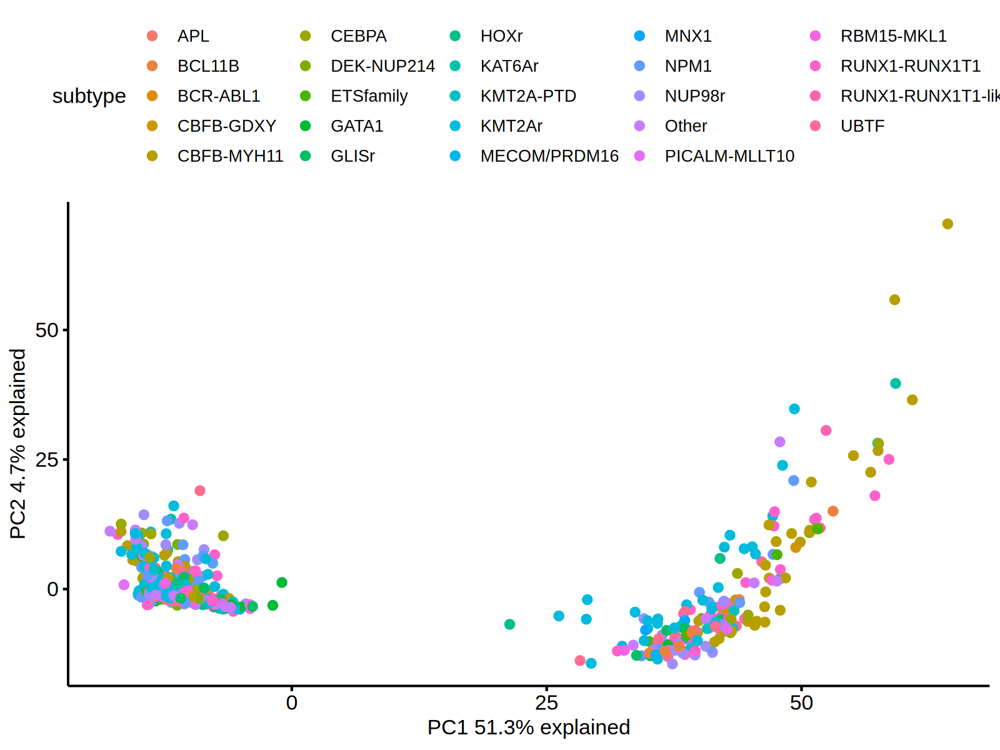

In [324]:
dge = DGEList(counts = count_df_te_combat)
dge = calcNormFactors(dge)
dge = normLibSizes(dge)
logcpm_jude_te = cpm(dge, normalized.lib.sizes = T, log = F)
logcpm_jude_te = log2(logcpm_jude_te + 1)
head2(logcpm_jude_te) 

row_sd = apply(logcpm_jude_te, 1, sd) 
summary(row_sd)
plotdat = logcpm_jude_te[row_sd > .65, ]

pc <- prcomp(t(plotdat), center = TRUE, scale = TRUE)
lblx = paste0('PC1 ', round(100 * pc$sdev[1]^2/sum(pc$sdev^2), 1), '% explained') 
lbly = paste0('PC2 ', round(100 * pc$sdev[2]^2/sum(pc$sdev^2), 1), '% explained') 
plotdat = as.data.table(pc$x, keep.rownames = T)
plotdat = merge(plotdat, dsn_sel[, .(sample_name, subtype)], by.x = 'rn', by.y = 'sample_name')
plotdat[, PC1 := - PC1 ]
options(repr.plot.width = 8, repr.plot.height = 6, repr.plot.res = 200)
ggscatter(plotdat, x = 'PC1', y = 'PC2', color = 'subtype') + xlab(lblx) + ylab(lbly)


In [358]:
table(dsn_sel$subtype_pca)


PC1_lo PC1_hi 
   663    193 

In [360]:
dsn_sel[, batch := 'unknown' ]
dsn_sel[grepl('TAR', sample_name), batch := 'target' ]


In [362]:
table(dsn_sel$batch, dsn_sel$subtype_pca)

         
          PC1_lo PC1_hi
  target       0    186
  unknown    663      7

In [340]:
dsn_sel[, subtype_pca := NULL ]
dsn_sel[, subtype_pca := 'PC1_lo' ]
dsn_sel[sample_name %in% plotdat[PC1 > -5, rn], subtype_pca := 'PC1_hi' ]
dsn_sel[, subtype_pca := factor(subtype_pca, levels = c('PC1_lo', 'PC1_hi')) ]


In [341]:
table(dsn_sel$subtype_pca, dsn_sel$subtype)
table(dsn_sel$subtype)
table(dsn_sel$subtype_pca)


        
         APL BCL11B BCR-ABL1 CBFB-GDXY CBFB-MYH11 CEBPA DEK-NUP214 ETSfamily GATA1 GLISr HOXr KAT6Ar KMT2A-PTD KMT2Ar MECOM/PRDM16 MNX1 NPM1 NUP98r Other PICALM-MLLT10
  PC1_lo   3      6        1         2         65    40         14        12    18    22   13      6         8    141            9    3   59     46    63             6
  PC1_hi   0      7        0         2         31     8          2         4     4     6    3      1         3     38            1    2   10     19     8             2
        
         RBM15-MKL1 RUNX1-RUNX1T1 RUNX1-RUNX1T1-like UBTF
  PC1_lo          7            82                  2   35
  PC1_hi          3            26                  1   12


               APL             BCL11B           BCR-ABL1          CBFB-GDXY         CBFB-MYH11              CEBPA         DEK-NUP214          ETSfamily              GATA1 
                 3                 13                  1                  4                 96                 48                 16                 16                 22 
             GLISr               HOXr             KAT6Ar          KMT2A-PTD             KMT2Ar       MECOM/PRDM16               MNX1               NPM1             NUP98r 
                28                 16                  7                 11                179                 10                  5                 69                 65 
             Other      PICALM-MLLT10         RBM15-MKL1      RUNX1-RUNX1T1 RUNX1-RUNX1T1-like               UBTF 
                71                  8                 10                108                  3                 47 


PC1_lo PC1_hi 
   663    193 

In [116]:
dim(count_df_te_combat)

[1] 1310  670

In [ ]:
count_df_te_combat <- ComBat_seq(as.matrix(count_df_te), batch=dsn_sel$subtype_pca)


In [438]:
count_df_coding_combat <- ComBat_seq(as.matrix(count_df_coding), batch=dsn_sel$subtype_pca)


Found 2 batches
Using null model in ComBat-seq.
Adjusting for 0 covariate(s) or covariate level(s)
Estimating dispersions
Fitting the GLM model
Shrinkage off - using GLM estimates for parameters
Adjusting the data


In [59]:
dge = DGEList(counts = count_df_te_combat)
dge = calcNormFactors(dge)
dge = normLibSizes(dge)
logcpm_jude_te_combat = cpm(dge, normalized.lib.sizes = T, log = F)
logcpm_jude_te_combat = log2(logcpm_jude_te_combat + 1)
head2(logcpm_jude_te_combat) 


,SJ007022,SJ007030,SJ007034,SJ007110,SJ007122
(CATTC)n:Satellite:Satellite,3.6968335,3.536201,0.0000000,2.07384173,3.880822
(GAATG)n:Satellite:Satellite,5.0915067,4.843135,2.3055023,3.30434996,5.013093
7SLRNA:srpRNA:srpRNA,0.1988053,0.000000,0.2720795,0.09531577,2.524359


,SJ007022,SJ007030,SJ007034,SJ007110,SJ007122
(CATTC)n:Satellite:Satellite,3.8084496,3.622567,0.0000000,2.1492661,3.895706
(GAATG)n:Satellite:Satellite,5.2086735,4.934205,2.3828929,3.3928514,5.028563
7SLRNA:srpRNA:srpRNA,0.2149019,0.000000,0.2891085,0.1017937,2.537558


   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
 0.0000  0.6285  1.0467  1.1357  1.6012  3.1825 

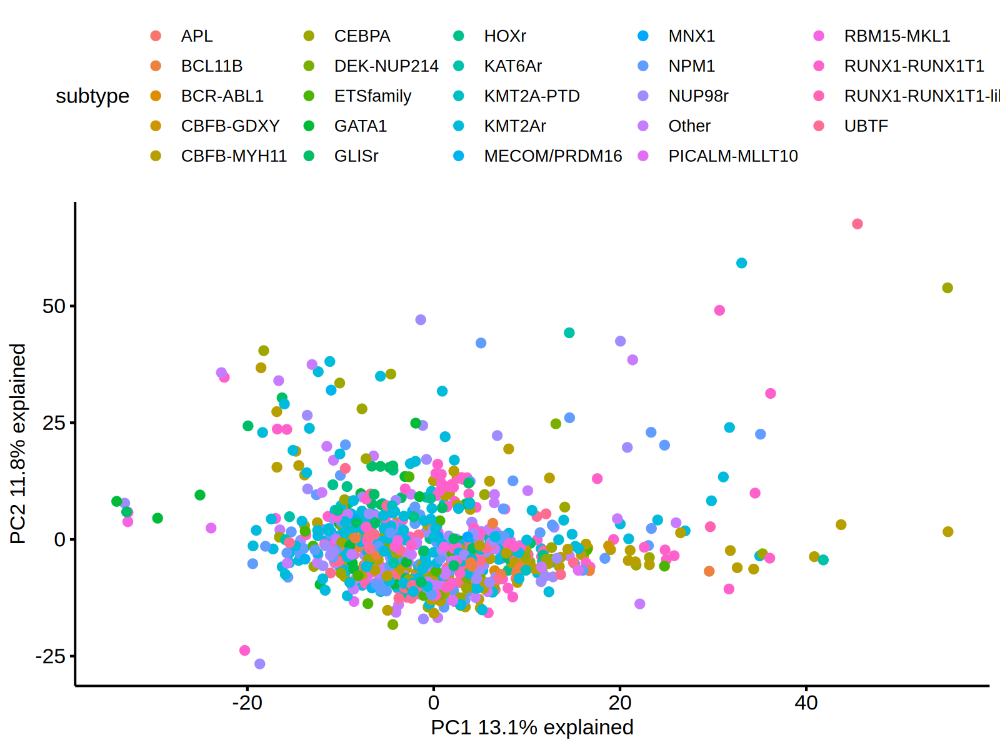

In [369]:

row_sd = apply(logcpm_jude_te_combat, 1, sd) 
summary(row_sd)
plotdat = logcpm_jude_te_combat[row_sd > .65, ]

pc <- prcomp(t(plotdat), center = TRUE, scale = TRUE)
lblx = paste0('PC1 ', round(100 * pc$sdev[1]^2/sum(pc$sdev^2), 1), '% explained') 
lbly = paste0('PC2 ', round(100 * pc$sdev[2]^2/sum(pc$sdev^2), 1), '% explained') 
plotdat = as.data.table(pc$x, keep.rownames = T)
plotdat = merge(plotdat, dsn_sel[, .(sample_name, subtype)], by.x = 'rn', by.y = 'sample_name')
plotdat[, PC1 := - PC1 ]
options(repr.plot.width = 8, repr.plot.height = 6, repr.plot.res = 200)
ggscatter(plotdat, x = 'PC1', y = 'PC2', color = 'subtype') + xlab(lblx) + ylab(lbly)


In [468]:
head2(logcpm_jude_te_combat)

,SJ007022,SJ007030,SJ007034,SJ007110,SJ007122
(CATTC)n:Satellite:Satellite,3.8084496,3.622567,0.0000000,2.1492661,3.895706
(GAATG)n:Satellite:Satellite,5.2086735,4.934205,2.3828929,3.3928514,5.028563
7SLRNA:srpRNA:srpRNA,0.2149019,0.000000,0.2891085,0.1017937,2.537558


   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
 0.0000  0.6285  1.0467  1.1357  1.6012  3.1825 

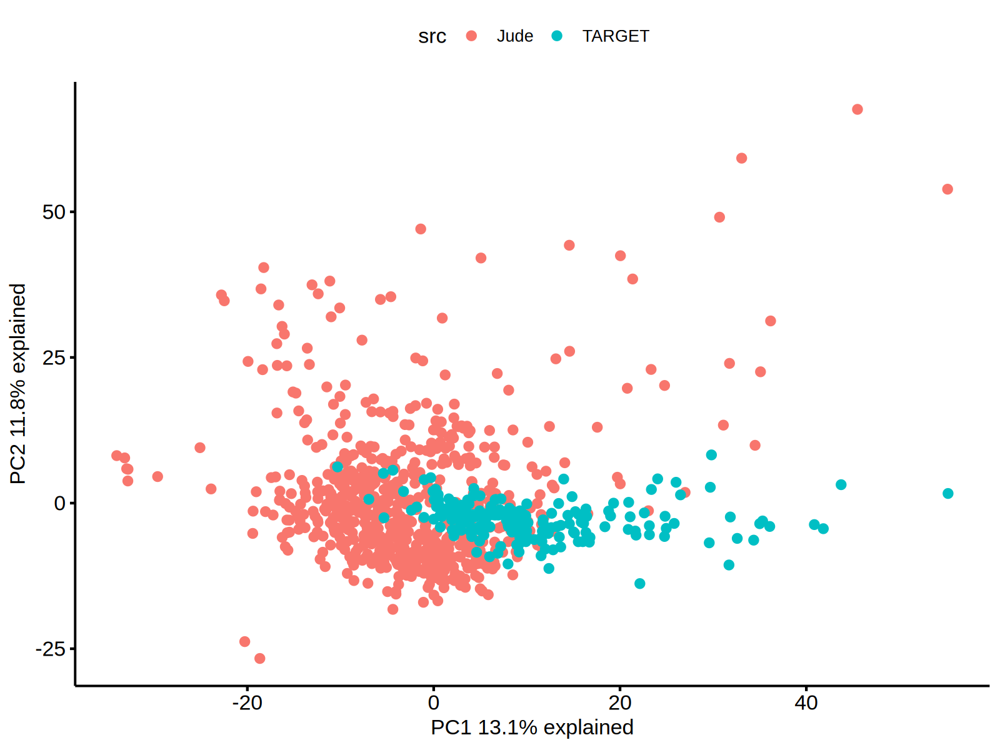

In [471]:
plot_ann = data.table(rn = colnames(logcpm_jude_te_combat))
plot_ann[, src := 'Jude']
plot_ann[grep('TARGET', rn), src := 'TARGET']
plot_ann_df = setDF(plot_ann[, 2:ncol(plot_ann)], rownames = plot_ann$rn) 

row_sd = apply(logcpm_jude_te_combat, 1, sd) 
summary(row_sd)
plot_dat = logcpm_jude_te_combat[row_sd > .65, ]

pc <- prcomp(t(plot_dat), center = TRUE, scale = TRUE)
lblx = paste0('PC1 ', round(100 * pc$sdev[1]^2/sum(pc$sdev^2), 1), '% explained') 
lbly = paste0('PC2 ', round(100 * pc$sdev[2]^2/sum(pc$sdev^2), 1), '% explained') 
plot_dat = as.data.table(pc$x, keep.rownames = T)
plot_dat = merge(plot_dat, plot_ann[, .(rn, src)], by.x = 'rn', by.y = 'rn')
plot_dat[, PC1 := - PC1 ]
options(repr.plot.width = 8, repr.plot.height = 6, repr.plot.res = 200)
ggscatter(plot_dat, x = 'PC1', y = 'PC2', color = 'src') + xlab(lblx) + ylab(lbly)


In [474]:
count_te_jude_combat = count_df_te_combat[, plot_ann[!grepl('TARGET', rn), rn]]
count_coding_jude_combat = count_df_coding_combat[, plot_ann[!grepl('TARGET', rn), rn]]
dim(count_df_jude)


[1] 1310  670

In [475]:
saveRDS(count_te_jude_combat, file = 'count_te_jude_combat.rds')
saveRDS(count_coding_jude_combat, file = 'count_coding_jude_combat.rds')


# DEG coding & TE subtype_pca (deprecated)

In [ ]:
dsn_sel[, group := subtype_pca ]
deg_subtypePCA_te = deg_fun2(dsn = dsn_sel, mtx = count_df_te)


In [346]:
deg_subtypePCA_te[, class_id  := unlist(strsplit(rn , ':'))[3], by = 1:nrow(deg_tmp)  ]
deg_subtypePCA_te[, family_id := unlist(strsplit(rn , ':'))[2], by = 1:nrow(deg_tmp)  ]
deg_subtypePCA_te[, gene_id   := unlist(strsplit(rn , ':'))[1], by = 1:nrow(deg_tmp)  ]
head(deg_subtypePCA_te) 


rn,logFC,logCPM,PValue,FDR,class_id,family_id,gene_id
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>
CER:Satellite:Satellite,-5.980719,6.832468,0,0,Satellite,Satellite,CER
L1P4d:L1:LINE,-5.178121,4.984672,0,0,LINE,L1,L1P4d
LTR46-int:ERV1:LTR,4.950854,7.292302,0,0,LTR,ERV1,LTR46-int
Eulor9C:DNA:DNA,-4.720437,5.257507,0,0,DNA,DNA,Eulor9C
COMP-subunit_FAM90A_rnd-6_family-7382:Unknown:Unknown,4.664655,5.411450,0,0,Unknown,Unknown,COMP-subunit_FAM90A_rnd-6_family-7382
MER21-int:ERVL:LTR,-4.612137,7.513428,0,0,LTR,ERVL,MER21-int


In [347]:
table(deg_subtypePCA_te[FDR < 0.05, class_id])



       DNA       DNA?       LINE        LTR         RC Retroposon  Satellite       SINE     srpRNA    Unknown 
       331          6        176        536          5          6         33         54          1         97 

In [350]:
count_df_coding = count_df_coding[, dsn_sel$sample_name] 


In [351]:
deg_subtypePCA_coding = deg_fun2(dsn = dsn_sel, mtx = count_df_coding)
head(deg_subtypePCA_coding) 


rn,logFC,logCPM,PValue,FDR
<chr>,<dbl>,<dbl>,<dbl>,<dbl>
SNORD133,-14.96009,7.372688,0,0
SCARNA28,-12.64034,5.220120,0,0
MIR3609,-12.09869,4.511128,0,0
LOC124900783,-11.74224,4.832167,0,0
LOC107987081,-11.49921,6.421180,0,0
LOC124900232,-11.41998,6.053399,0,0


[1] 785 856

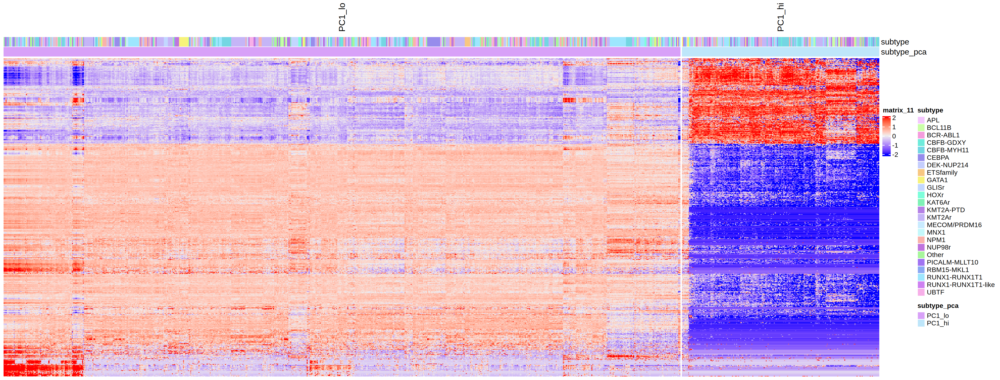

In [349]:
te_sel = unique(deg_subtypePCA_te[abs(logFC) > 1 & FDR < 0.05, rn]) 
dsn_sel_df = setDF(dsn_sel[, .(subtype, subtype_pca)], rownames = dsn_sel$sample_name)
plotdat = logcpm_jude_te[te_sel, rownames(dsn_sel_df)]
plotdat = scale_fun(plotdat)
plotdat[plotdat > 2] = 2
plotdat[plotdat < -2] = -2
dim(plotdat)
column_ha = HeatmapAnnotation(df = dsn_sel_df)
args = list(matrix = plotdat, top_annotation = column_ha, 
            column_split = factor(dsn_sel$subtype_pca), show_column_names = F, 
            show_row_names = F, show_column_dend = F, cluster_columns = T, 
            cluster_rows = T, row_names_gp = grid::gpar(fontsize = 7), 
            show_row_dend = F, column_title_rot = 90)
hp = do.call(Heatmap, args)
options(repr.plot.width = 21, repr.plot.height = 8, repr.plot.res = 200)
draw(hp)


[1] 785 856

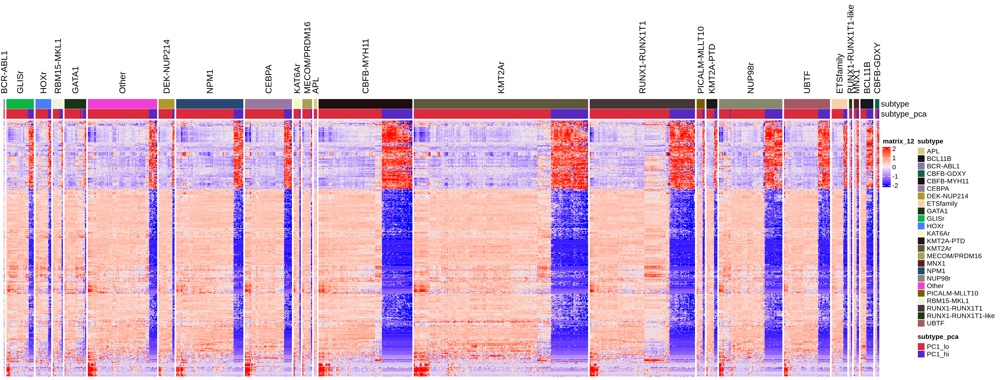

In [352]:
te_sel = unique(deg_subtypePCA_te[abs(logFC) > 1 & FDR < 0.05, rn]) 
dsn_sel_df = setDF(dsn_sel[, .(subtype, subtype_pca)], rownames = dsn_sel$sample_name)
plotdat = logcpm_jude_te[te_sel, rownames(dsn_sel_df)]
plotdat = scale_fun(plotdat)
plotdat[plotdat > 2] = 2
plotdat[plotdat < -2] = -2
dim(plotdat)
column_ha = HeatmapAnnotation(df = dsn_sel_df)
args = list(matrix = plotdat, top_annotation = column_ha, 
            column_split = factor(dsn_sel$subtype), show_column_names = F, 
            show_row_names = F, show_column_dend = F, cluster_columns = T, 
            cluster_rows = T, row_names_gp = grid::gpar(fontsize = 7), 
            show_row_dend = F, column_title_rot = 90)
hp = do.call(Heatmap, args)
options(repr.plot.width = 21, repr.plot.height = 8, repr.plot.res = 200)
draw(hp)


In [ ]:
head(deg_subtypePCA_coding)
tail(deg_subtypePCA_coding)

In [356]:
coding_sel = unique(deg_subtypePCA_coding[abs(logFC) > 1 & FDR < 0.05, rn]) 
dsn_sel_df = setDF(dsn_sel[, .(subtype, subtype_pca)], rownames = dsn_sel$sample_name)
plotdat = logcpm_jude_coding[coding_sel, rownames(dsn_sel_df)]
plotdat = scale_fun(plotdat)
plotdat[plotdat > 2] = 2
plotdat[plotdat < -2] = -2
dim(plotdat)
column_ha = HeatmapAnnotation(df = dsn_sel_df)
args = list(matrix = plotdat, top_annotation = column_ha, 
            column_split = factor(dsn_sel$subtype), show_column_names = F, 
            show_row_names = F, show_column_dend = F, cluster_columns = T, 
            cluster_rows = T, row_names_gp = grid::gpar(fontsize = 7), 
            show_row_dend = F, column_title_rot = 90)
hp = do.call(Heatmap, args)
options(repr.plot.width = 21, repr.plot.height = 8, repr.plot.res = 200)
draw(hp)


[1] 37357   856

`use_raster` is automatically set to TRUE for a matrix with more than 2000 rows. You can control `use_raster` argument by explicitly setting TRUE/FALSE to it.

Set `ht_opt$message = FALSE` to turn off this message.

'magick' package is suggested to install to give better rasterization.

Set `ht_opt$message = FALSE` to turn off this message.



In [315]:
res = fgsea_fun(deg_subtypePCA_coding, if_all_pathways = T)
pathwaysDF = msigdbr('human')
pathways <- split(as.character(pathwaysDF$gene_symbol), pathwaysDF$gs_name)
res_fgsea = merge(res, pathwaysDF[!duplicated(pathwaysDF$gs_name), c('gs_name', 'gs_cat', 'gs_subcat')], by.x = 'pathway', by.y = 'gs_name', all.x = T) 
saveRDS(res_fgsea, file = 'fgsea_subtypePCA_allGeneSet.rds')


Warning message in preparePathwaysAndStats(pathways, stats, minSize, maxSize, gseaParam, :
"There are ties in the preranked stats (1.21% of the list).
The order of those tied genes will be arbitrary, which may produce unexpected results."
Warning message in fgseaMultilevel(pathways = pathways, stats = stats, minSize = minSize, :
"There were 1283 pathways for which P-values were not calculated properly due to unbalanced (positive and negative) gene-level statistic values. For such pathways pval, padj, NES, log2err are set to NA. You can try to increase the value of the argument nPermSimple (for example set it nPermSimple = 10000)"


  |=======================================================================================================================================================================| 100%



Warning message in fgseaMultilevel(pathways = pathways, stats = stats, minSize = minSize, :
"For some of the pathways the P-values were likely overestimated. For such pathways log2err is set to NA."
Warning message in fgseaMultilevel(pathways = pathways, stats = stats, minSize = minSize, :
"For some pathways, in reality P-values are less than 1e-50. You can set the `eps` argument to zero for better estimation."


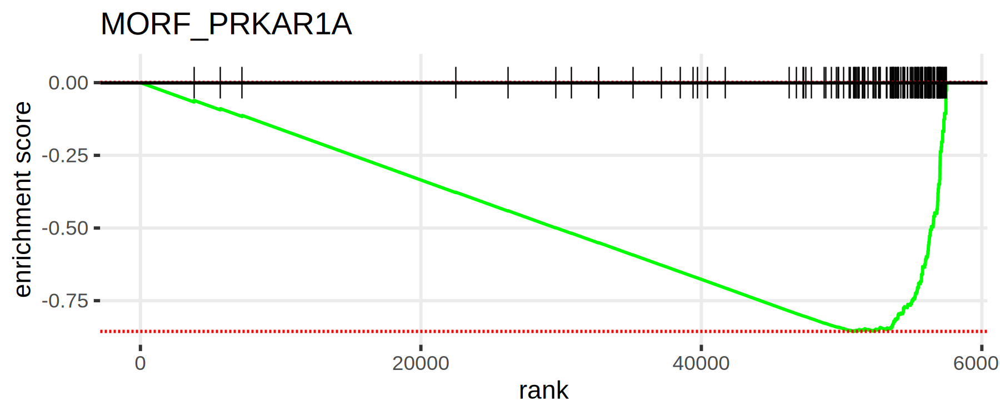

In [316]:
options(repr.plot.width = 6, repr.plot.height = 2.5, repr.plot.res = 300)
gs_name = 'MORF_PRKAR1A'
plotEnrichment(pathways[["MORF_PRKAR1A"]], rankings) + labs(title=gs_name)


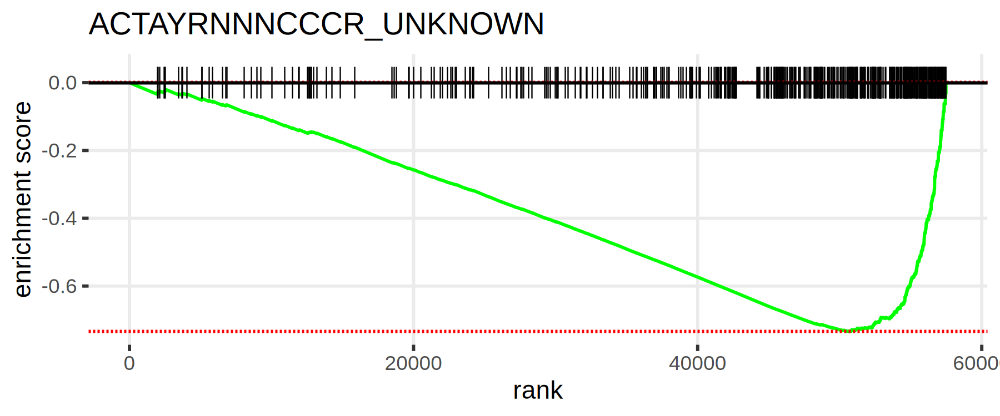

In [228]:
options(repr.plot.width = 6, repr.plot.height = 2.5, repr.plot.res = 300)
gs_name = 'ACTAYRNNNCCCR_UNKNOWN'
plotEnrichment(pathways[["ACTAYRNNNCCCR_UNKNOWN"]], rankings) + labs(title=gs_name)


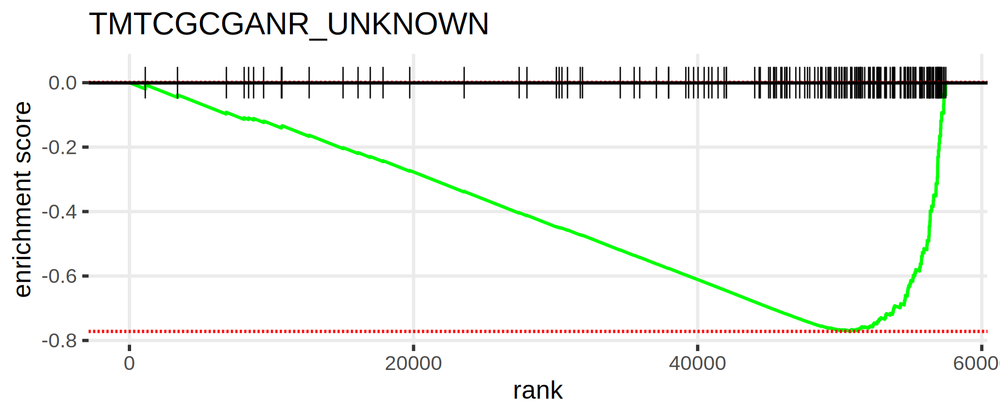

In [231]:
options(repr.plot.width = 6, repr.plot.height = 2.5, repr.plot.res = 300)
gs_name = 'TMTCGCGANR_UNKNOWN'
plotEnrichment(pathways[["TMTCGCGANR_UNKNOWN"]], rankings) + labs(title=gs_name)


In [ ]:
datatable(res_fgsea[ gs_subcat == 'TFT:TFT_Legacy', ])

In [286]:
motifs = fread('../PMID15735639.txt')
setnames(motifs, c('nn', 'motif', 'MCS', 'known', 'score_promoter', 'score_intron', 'score_tissue', 'position'))
motifs[known == '', motif_name := paste0(motif, '_UNKNOWN') ]
motifs[, if_known := 'known' ]
motifs[known == '', if_known := 'unknown' ]
head(motifs)


nn,motif,MCS,known,score_promoter,score_intron,score_tissue,position,motif_name,if_known
<int>,<chr>,<dbl>,<chr>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>
1,RCGCAnGCGY,107.8,NRF-1,0.49,0.09,15.0,-62,NA,known
2,CACGTG,85.3,MYC,0.47,0.01,8.8,-62,NA,known
3,SCGGAAGY,80.4,ELK-1,0.44,0.02,22.4,-24,NA,known
4,ACTAYRONNCCCR,69.5,,0.61,0.06,8.1,-89,ACTAYRONNCCCR_UNKNOWN,unknown
5,GATTGGY,64.6,NF-Y,0.51,0.04,9.8,-63,NA,known
6,GGGCGGR,63.9,SP1,0.21,0.02,11.4,-63,NA,known


In [287]:
table(motifs$if_known)


  known unknown 
    135      39 

In [293]:
# if the unknown motif regulating gene expression consistently between the TE PCA subtypes
plotdat = res_fgsea[ gs_subcat == 'TFT:TFT_Legacy', ]
plotdat[, xx := 1:nrow(plotdat) ]
plotdat[pathway %in% motifs[if_known == 'unknown', motif_name], ]

pathway,pval,padj,log2err,ES,NES,size,leadingEdge,gs_cat,gs_subcat,sel,xx
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<list>,<chr>,<chr>,<chr>,<int>
ACCTGTTG_UNKNOWN,6.499116e-03,1.372479e-02,0.4070179,-0.4352690,-1.374535,160,"SUMO2, G....",C3,TFT:TFT_Legacy,known,9
CYTAGCAAY_UNKNOWN,1.413514e-07,6.488705e-07,0.6901325,-0.6085762,-1.917425,152,"MGST3, M....",C3,TFT:TFT_Legacy,known,131
GTGGGTGK_UNKNOWN,NA,NA,NA,-0.4223350,NA,295,"GABARAP,....",C3,TFT:TFT_Legacy,known,241
GTTRYCATRR_UNKNOWN,1.747183e-05,5.986753e-05,0.5756103,-0.5289317,-1.670072,175,"GAPDH, C....",C3,TFT:TFT_Legacy,known,244
KTGGYRSGAA_UNKNOWN,2.745150e-02,4.978472e-02,0.3524879,-0.4727486,-1.332260,76,"R3HDM1, ....",C3,TFT:TFT_Legacy,known,293
RRAGTTGT_UNKNOWN,NA,NA,NA,-0.5448620,NA,256,"UBE2V1, ....",C3,TFT:TFT_Legacy,known,429
SMTTTTGT_UNKNOWN,NA,NA,NA,-0.5537056,NA,407,PRICKLE3....,C3,TFT:TFT_Legacy,known,446
SYATTGTG_UNKNOWN,5.559511e-07,2.361387e-06,0.6594444,-0.5280947,-1.695201,230,"CSNK2B, ....",C3,TFT:TFT_Legacy,known,484
TTCYRGAA_UNKNOWN,NA,NA,NA,-0.5430967,NA,338,"HSPB1, W....",C3,TFT:TFT_Legacy,known,525


In [282]:
res_fgsea[, sel := 'unknown' ]
res_fgsea[pathway %in% motifs[grep('UNK', motif_name), motif_name], sel := 'known' ]


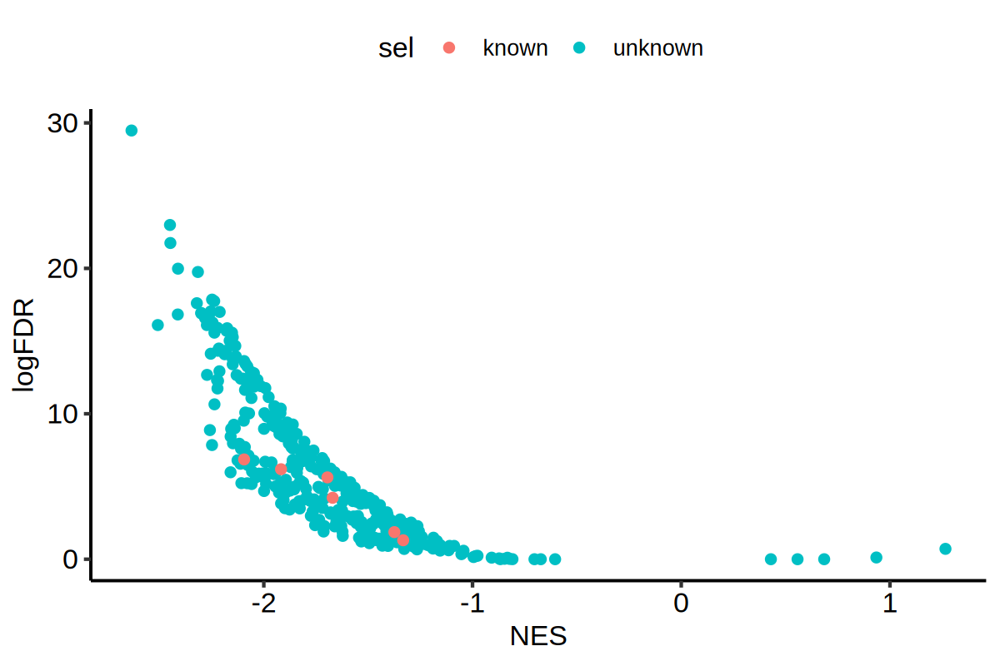

In [283]:
plotdat = res_fgsea[ gs_subcat == 'TFT:TFT_Legacy' & !is.na(pval), ]
plotdat = plotdat[order(padj), ]
plotdat[, logFDR := -log(padj, 10)]
plotdat[, xx := 1:nrow(plotdat) ]
plotdat = plotdat[order(sel, decreasing = T), ]
options(repr.plot.width = 6, repr.plot.height = 4, repr.plot.res = 200)
ggplot(plotdat, aes(x = NES, y = logFDR, color = sel)) + geom_point() + theme_pubr()

In [289]:
motifs[motif_name %in% plotdat$pathway, ]

nn,motif,MCS,known,score_promoter,score_intron,score_tissue,position,motif_name,if_known
<int>,<chr>,<dbl>,<chr>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>
34,CYTAGCAAY,26.1,,0.50,0.06,5.2,-142,CYTAGCAAY_UNKNOWN,unknown
37,GTTRYCATRR,25.3,,0.54,0.11,7.6,-56,GTTRYCATRR_UNKNOWN,unknown
57,ACCTGTTG,20.7,,0.38,0.03,4.1,-,ACCTGTTG_UNKNOWN,unknown
71,SYATTGTG,17.1,,0.40,0.03,4.2,-,SYATTGTG_UNKNOWN,unknown
109,YGTCCTTGR,12.7,,0.26,0.04,4.7,,YGTCCTTGR_UNKNOWN,unknown
112,KTGGYRSGAA,12.3,,0.26,0.02,5.1,,KTGGYRSGAA_UNKNOWN,unknown


In [284]:
table(plotdat$sel)


  known unknown 
      6     357 

In [288]:
head(plotdat)

pathway,pval,padj,log2err,ES,NES,size,leadingEdge,gs_cat,gs_subcat,sel,logFDR,xx
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<list>,<chr>,<chr>,<chr>,<dbl>,<int>
GABP_B,2.269875e-32,3.328792e-30,1.481568,-0.7929296,-2.633776,264,"KXD1, TA....",C3,TFT:TFT_Legacy,unknown,29.47771,1
E4F1_Q6,1.718289e-25,1.041224e-23,1.311015,-0.7281789,-2.449559,290,"TAF10, C....",C3,TFT:TFT_Legacy,unknown,22.98246,2
BACH1_01,3.664727e-24,1.809295e-22,1.270913,-0.7398381,-2.447621,262,"BBLN, RP....",C3,TFT:TFT_Legacy,unknown,21.74249,3
AP1_Q4_01,2.821786e-22,1.051656e-20,1.221054,-0.7258856,-2.411085,264,"BBLN, AL....",C3,TFT:TFT_Legacy,unknown,19.97813,4
YY1_Q6,4.937023e-22,1.778477e-20,1.212545,-0.7341683,-2.315704,251,"EMC6, AT....",C3,TFT:TFT_Legacy,unknown,19.74995,5
ELF1_Q6,5.244781e-20,1.409833e-18,1.160180,-0.7158688,-2.247820,249,"PABPC1, ....",C3,TFT:TFT_Legacy,unknown,17.85083,6


# DEG TEcount & coding 

In [477]:
dsn_jude = dsn[sample_name %in% colnames(count_te_jude_combat), ]
dim(dsn_jude) 


[1] 670  73

In [478]:
dge = DGEList(counts = count_te_jude_combat)
dge = calcNormFactors(dge)
dge = normLibSizes(dge)
logcpm_jude_te = cpm(dge, normalized.lib.sizes = T, log = F)
logcpm_jude_te = log2(logcpm_jude_te + 1)
head2(logcpm_jude_te) 


,SJ007022,SJ007030,SJ007034,SJ007110,SJ007122
(CATTC)n:Satellite:Satellite,3.6968335,3.536201,0.0000000,2.07384173,3.880822
(GAATG)n:Satellite:Satellite,5.0915067,4.843135,2.3055023,3.30434996,5.013093
7SLRNA:srpRNA:srpRNA,0.1988053,0.000000,0.2720795,0.09531577,2.524359


In [829]:
dim(logcpm_jude_te)

[1] 1310  670

In [479]:
dge = DGEList(counts = count_coding_jude_combat)
dge = calcNormFactors(dge)
dge = normLibSizes(dge)
logcpm_jude_coding = cpm(dge, normalized.lib.sizes = T, log = F)
logcpm_jude_coding = log2(logcpm_jude_coding + 1)
head2(logcpm_jude_coding)


,SJ007022,SJ007030,SJ007034,SJ007110,SJ007122
A1BG,3.79885758,3.55473585,4.190966,4.184987,3.811385
A1BG-AS1,3.25783800,2.79872833,2.282658,2.798903,2.864149
A1CF,0.02839024,0.02686492,0.000000,0.000000,0.000000


In [480]:
subtypes = names(table(dsn$subtype))


In [444]:
source('~/script/utils.r')

In [446]:
getwd()

[1] "/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/pediatrics"

[1] "APL"                "BCL11B"             "BCR-ABL1"           "CBFB-GDXY"          "CBFB-MYH11"         "CEBPA"              "DEK-NUP214"         "ETSfamily"         
 [9] "GATA1"              "GLISr"              "HOXr"               "KAT6Ar"             "KMT2A-PTD"          "KMT2Ar"             "MECOM/PRDM16"       "MNX1"              
[17] "NPM1"               "NUP98r"             "Other"              "PICALM-MLLT10"      "RBM15-MKL1"         "RUNX1-RUNX1T1"      "RUNX1-RUNX1T1-like" "UBTF"

In [511]:
subtypes = table(dsn_jude$subtype)
subtypes = subtypes[subtypes > 20]
subtypes = names(subtypes)
subtypes


[1] "CBFB-MYH11"    "CEBPA"         "GATA1"         "GLISr"         "KMT2Ar"        "NPM1"          "NUP98r"        "Other"         "RUNX1-RUNX1T1" "UBTF"

In [512]:
deg_te_list = lapply(1:length(subtypes), function(ii){
    type1 = subtypes[ii]
    dsn_jude[, group := 'other' ]
    dsn_jude[subtype %in% subtypes[ii], group := 'selected' ]
    dsn_jude[, group := factor(group, levels = c('other', 'selected') ) ]
    deg_fun2(dsn_jude, count_te_jude_combat)
}) 
names(deg_te_list) = subtypes 
deg_te_dt = rbindlist(deg_te_list, idcol = T)
deg_te_dt[, class_id  := unlist(strsplit(rn , ':'))[3], by = 1:nrow(deg_te_dt) ]
deg_te_dt[, family_id := unlist(strsplit(rn , ':'))[2], by = 1:nrow(deg_te_dt) ]
deg_te_dt[, gene_id   := unlist(strsplit(rn , ':'))[1], by = 1:nrow(deg_te_dt) ]

saveRDS(deg_te_dt, file = 'deg_jude_te_dt_combat.rds')


In [491]:
saveRDS(subtypes, file = 'subtypes.rds')
saveRDS(dsn_jude, file = 'dsn_jude.rds')


In [ ]:
library(edgeR)
library(BiocParallel)
library(data.table)
register(MulticoreParam(10))

source('~/script/utils.r')

subtypes = readRDS('subtypes.rds')
dsn_jude = readRDS('dsn_jude.rds')
count_coding_jude_combat = readRDS('count_coding_jude_combat.rds') 

deg_coding_list = lapply(1:length(subtypes), function(ii){
    type1 = subtypes[ii]
    dsn_jude[, group := 'other' ]
    dsn_jude[subtype %in% subtypes[ii], group := 'selected' ]
    dsn_jude[, group := factor(group, levels = c('other', 'selected') ) ]
    deg_fun2(dsn_jude, count_coding_jude_combat, if_filter = T)
})
names(deg_coding_list) = subtypes
deg_coding_dt = rbindlist(deg_coding_list, idcol = T)
saveRDS(deg_coding_dt, file = 'deg_coding_dt_combat.rds')


In [117]:
subtypes = readRDS('subtypes.rds')
dsn_jude = readRDS('dsn_jude.rds')
count_coding_jude_combat = readRDS('count_coding_jude_combat.rds') 
saveRDS(deg_coding_dt, file = 'deg_coding_dt_combat.rds')


In [493]:
head(deg_te_dt)


.id,rn,logFC,logCPM,PValue,FDR,class_id,family_id,gene_id
<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>
BCL11B,UCON61:Unknown:Unknown,3.455143,-0.4803771,1.238494e-16,1.622428e-13,Unknown,Unknown,UCON61
BCL11B,MER121B:hAT:DNA,3.691090,1.9712994,4.272343e-07,2.797929e-04,DNA,hAT,MER121B
BCL11B,CR1-1_Amn:CR1:LINE,3.488333,2.8241129,6.407471e-07,2.797929e-04,LINE,CR1,CR1-1_Amn
BCL11B,UCON40:TcMar-Mariner:DNA,1.405219,5.4573519,8.682098e-07,2.843387e-04,DNA,TcMar-Mariner,UCON40
BCL11B,UCON1:Unknown:Unknown,3.174353,2.3991095,3.110730e-06,8.150112e-04,Unknown,Unknown,UCON1
BCL11B,MER70-int:ERVL:LTR,3.476318,4.0687411,9.239195e-06,1.649542e-03,LTR,ERVL,MER70-int


In [642]:
subtypes = unique(dsn_jude$subtype)

In [ ]:
deg_telocal_list = lapply(1:length(subtypes), function(ii){
    type1 = subtypes[ii]
    dsn_jude[, group := 'other' ]
    dsn_jude[subtype %in% subtypes[ii], group := 'selected' ]
    dsn_jude[, group := factor(group, levels = c('other', 'selected') ) ]
    deg_fun2(dsn_jude, count_te_jude_combat)
}) 
names(deg_te_list) = subtypes 
deg_te_dt = rbindlist(deg_te_list, idcol = T)
deg_te_dt[, class_id  := unlist(strsplit(rn , ':'))[3], by = 1:nrow(deg_te_dt) ]
deg_te_dt[, family_id := unlist(strsplit(rn , ':'))[2], by = 1:nrow(deg_te_dt) ]
deg_te_dt[, gene_id   := unlist(strsplit(rn , ':'))[1], by = 1:nrow(deg_te_dt) ]

saveRDS(deg_te_dt, file = 'deg_jude_te_dt_combat.rds')


In [119]:
mtx = readRDS('/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/collab_Farhan/data/mtx_all_df.rds')
hsc_sel = c('HSC1', 'HSC2', 'HSC3', 'CMP1', 'CMP2', 'CMP3', 'GMP1', 'GMP2', 'GMP3')
mtx = mtx[rownames(count_df_te_combat), hsc_sel]
mtx = cbind(mtx, count_df_te_combat) 


# summary of TE DEG

In [494]:
table(deg_te_dt[FDR < 0.05, class_id])


           DNA           DNA?           LINE Low_complexity            LTR             RC     Retroposon      Satellite           SINE         srpRNA        Unknown 
          1205             19            576              1           2049             25             19            111            231              3            392 

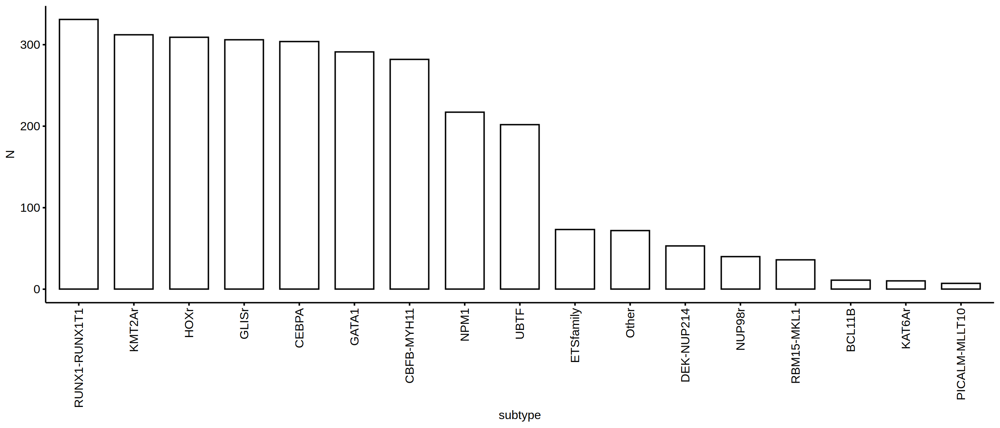

In [495]:
plotdat = as.data.table(table(deg_te_dt[FDR < 0.05 & class_id %in% c('LTR', 'LINE', 'SINE'), .id]), keep.rownames = T)
plotdat = plotdat[order(N, decreasing = T), ]
plotdat[, subtype := factor(V1, levels = plotdat$V1) ]
options(repr.plot.width = 14, repr.plot.height = 6, repr.plot.res = 200)
ggbarplot(plotdat, x = 'subtype', y = 'N') + rotate_x_text()


In [496]:
plotdat = melt(as.data.table(as.data.frame.matrix(table(deg_te_dt[FDR < 0.05 & class_id %in% c('LTR', 'LINE', 'SINE'), .(sign(logFC), .id)])), keep.rownames = T))
head(plotdat) 


Warning message in melt.data.table(as.data.table(as.data.frame.matrix(table(deg_te_dt[FDR < :
"id.vars and measure.vars are internally guessed when both are 'NULL'. All non-numeric/integer/logical type columns are considered id.vars, which in this case are columns [rn, ...]. Consider providing at least one of 'id' or 'measure' vars in future."


rn,variable,value
<chr>,<fct>,<int>
-1,BCL11B,0
1,BCL11B,11
-1,CBFB-MYH11,216
1,CBFB-MYH11,66
-1,CEBPA,113
1,CEBPA,191


In [497]:
table(dsn_sel$subtype)


               APL             BCL11B           BCR-ABL1          CBFB-GDXY         CBFB-MYH11              CEBPA         DEK-NUP214          ETSfamily              GATA1 
                 3                 13                  1                  4                 96                 48                 16                 16                 22 
             GLISr               HOXr             KAT6Ar          KMT2A-PTD             KMT2Ar       MECOM/PRDM16               MNX1               NPM1             NUP98r 
                28                 16                  7                 11                179                 10                  5                 69                 65 
             Other      PICALM-MLLT10         RBM15-MKL1      RUNX1-RUNX1T1 RUNX1-RUNX1T1-like               UBTF 
                71                  8                 10                108                  3                 47 

In [498]:
dsn_sel[file.exists(bam_file), subtype]

character(0)

In [428]:
head(plotdat)

variable,rn,value,nn,subtype,UpDn,N
<chr>,<chr>,<int>,<int>,<fct>,<chr>,<int>
BCL11B,-1,95,110,BCL11B,up,13
BCL11B,1,15,110,BCL11B,down,13
BCR-ABL1,-1,0,1,BCR-ABL1,up,1
BCR-ABL1,1,1,1,BCR-ABL1,down,1
CBFB-MYH11,-1,72,78,CBFB-MYH11,up,96
CBFB-MYH11,1,6,78,CBFB-MYH11,down,96


Warning message in melt.data.table(as.data.table(as.data.frame.matrix(table(deg_te_dt[FDR < :
“id.vars and measure.vars are internally guessed when both are 'NULL'. All non-numeric/integer/logical type columns are considered id.vars, which in this case are columns [rn, ...]. Consider providing at least one of 'id' or 'measure' vars in future.”


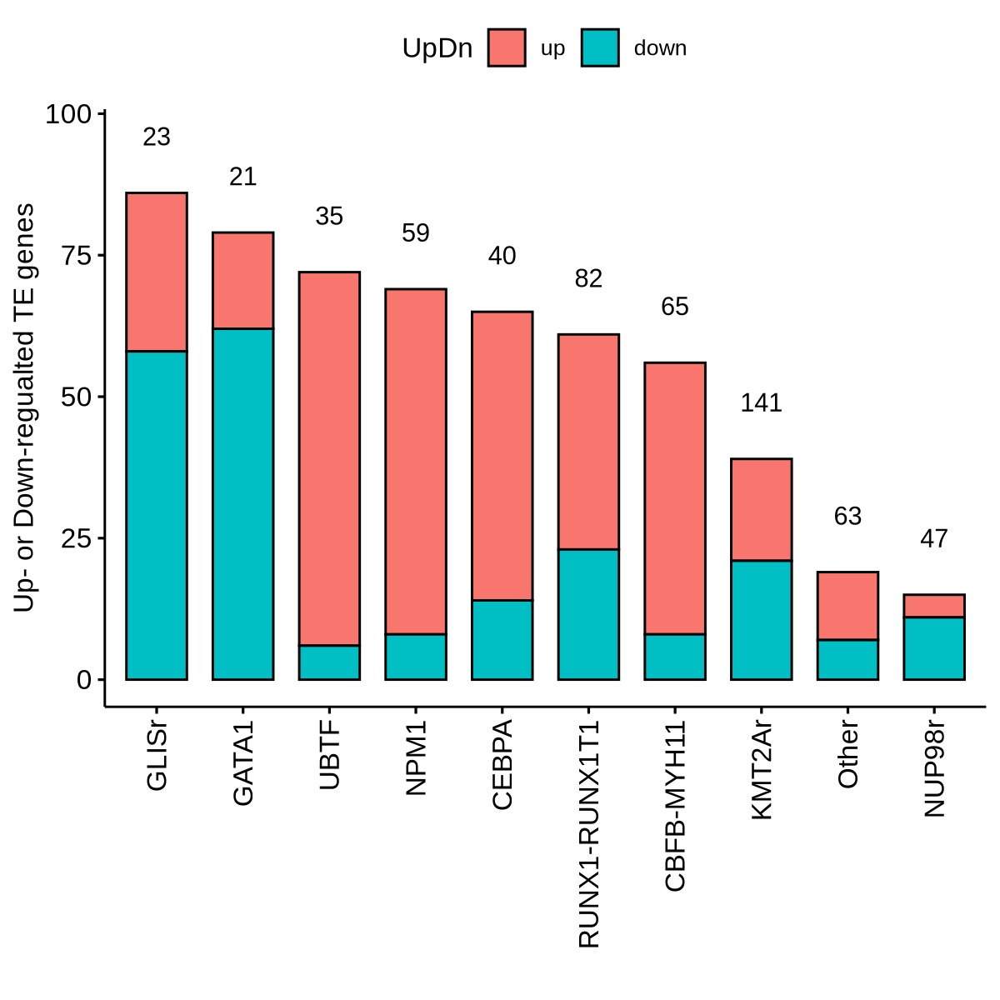

In [41]:
#plotdat = melt(as.data.table(as.data.frame.matrix(table(deg_te_dt[FDR < 0.05 & abs(logFC) > 1 & class_id %in% c('LTR', 'LINE', 'SINE'), .(sign(logFC), .id)])), keep.rownames = T))
plotdat = melt(as.data.table(as.data.frame.matrix(table(deg_te_dt[FDR < 0.05 & abs(logFC) > 1 & class_id %in% c('LTR'), .(sign(logFC), .id)])), keep.rownames = T))
plotdat[, nn := sum(.SD$value), by = 'variable' ]
lvl = plotdat[!duplicated(variable), ][order(nn, decreasing = T), variable]
plotdat[, subtype := factor(variable, levels = lvl) ]
plotdat[, UpDn := 'down' ]
plotdat[rn < 1, UpDn := 'up' ]
plotdat[, UpDn := factor(UpDn, levels = c('up', 'down'))]

tmp = as.data.table(table(dsn_jude[, subtype]), keep.rownames = T)

plotdat = merge(plotdat, tmp, by.x = 'variable', by.y = 'V1', all.x = T) 

options(repr.plot.width = 6, repr.plot.height = 6, repr.plot.res = 200)
lbl = plotdat[!duplicated(subtype), ][order(nn, decreasing = T), ]
lbl[, yy := nn + 10 ] 
ggbarplot(plotdat, x = 'subtype', y = 'value', fill = 'UpDn') + rotate_x_text() + xlab('') + ylab('Up- or Down-regualted TE genes') + 
geom_text(inherit.aes = F, data = lbl, aes(subtype, y = yy, label = N))


In [45]:
table(deg_te_dt[FDR < 0.05 & abs(logFC) > 1 & class_id %in% c('LINE'), .(sign(logFC), .id)])

    .id
V1   CBFB-MYH11 CEBPA GATA1 GLISr KMT2Ar NPM1 NUP98r Other RUNX1-RUNX1T1 UBTF
  -1         11    10     3     8      6   10      2     3             9    8
  1           2    18     6     8      2    2      1     3             5    3

In [47]:
plotdat = melt(as.data.table(as.data.frame.matrix(table(deg_te_dt[FDR < 0.05 & abs(logFC) > 1 & class_id %in% c('LINE'), .(sign(logFC), .id)])), keep.rownames = T))
plotdat[, nn := sum(.SD$value), by = 'variable' ]
plotdat


Warning message in melt.data.table(as.data.table(as.data.frame.matrix(table(deg_te_dt[FDR < :
“id.vars and measure.vars are internally guessed when both are 'NULL'. All non-numeric/integer/logical type columns are considered id.vars, which in this case are columns [rn, ...]. Consider providing at least one of 'id' or 'measure' vars in future.”


rn,variable,value,nn
<chr>,<fct>,<int>,<int>
-1,CBFB-MYH11,11,13
1,CBFB-MYH11,2,13
-1,CEBPA,10,28
1,CEBPA,18,28
-1,GATA1,3,9
1,GATA1,6,9
-1,GLISr,8,16
1,GLISr,8,16
-1,KMT2Ar,6,8


Warning message in melt.data.table(as.data.table(as.data.frame.matrix(table(deg_te_dt[FDR < :
“id.vars and measure.vars are internally guessed when both are 'NULL'. All non-numeric/integer/logical type columns are considered id.vars, which in this case are columns [rn, ...]. Consider providing at least one of 'id' or 'measure' vars in future.”


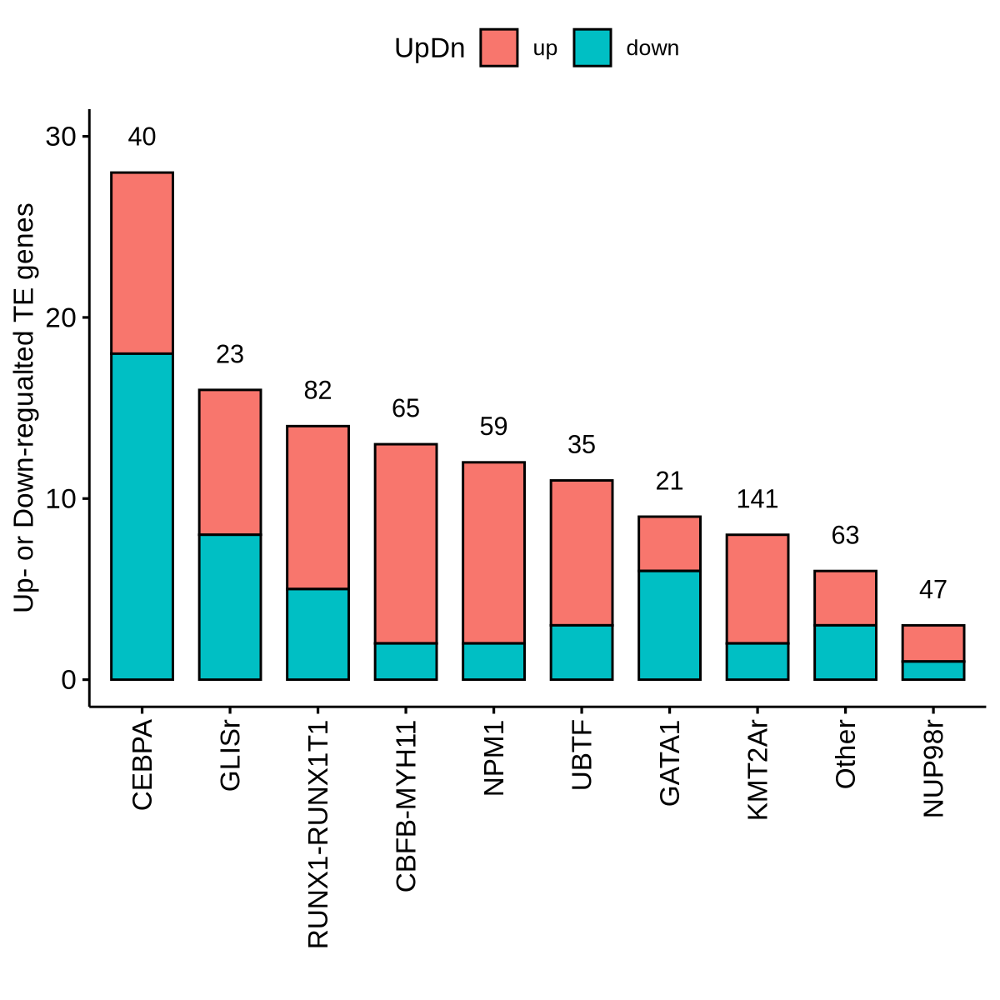

In [44]:
#plotdat = melt(as.data.table(as.data.frame.matrix(table(deg_te_dt[FDR < 0.05 & abs(logFC) > 1 & class_id %in% c('LTR', 'LINE', 'SINE'), .(sign(logFC), .id)])), keep.rownames = T))
plotdat = melt(as.data.table(as.data.frame.matrix(table(deg_te_dt[FDR < 0.05 & abs(logFC) > 1 & class_id %in% c('LINE'), .(sign(logFC), .id)])), keep.rownames = T))
plotdat[, nn := sum(.SD$value), by = 'variable' ]
lvl = plotdat[!duplicated(variable), ][order(nn, decreasing = T), variable]
plotdat[, subtype := factor(variable, levels = lvl) ]
plotdat[, UpDn := 'down' ]
plotdat[rn < 1, UpDn := 'up' ]
plotdat[, UpDn := factor(UpDn, levels = c('up', 'down'))]

tmp = as.data.table(table(dsn_jude[, subtype]), keep.rownames = T)

plotdat = merge(plotdat, tmp, by.x = 'variable', by.y = 'V1', all.x = T) 

options(repr.plot.width = 6, repr.plot.height = 6, repr.plot.res = 200)
lbl = plotdat[!duplicated(subtype), ][order(nn, decreasing = T), ]
lbl[, yy := nn + 2 ] 
ggbarplot(plotdat, x = 'subtype', y = 'value', fill = 'UpDn') + rotate_x_text() + xlab('') + ylab('Up- or Down-regualted TE genes') + 
geom_text(inherit.aes = F, data = lbl, aes(subtype, y = yy, label = N))


In [898]:
subtype_bar_sel = unique(plotdat$variable) 
subtype_bar_sel

[1] "CBFB-MYH11"    "CEBPA"         "GATA1"         "GLISr"         "KMT2Ar"        "NPM1"          "NUP98r"        "Other"         "RUNX1-RUNX1T1" "UBTF"

In [123]:
subtype_sel = c('CBFB-MYH11', 'CEBPA', 'GATA1', 'GLISr', 'KMT2Ar', 'NPM1', 'RUNX1-RUNX1T1' )
lvl = c('CBFB-MYH11', 'CEBPA', 'GATA1', 'GLISr', 'KMT2Ar', 'NPM1', 'RUNX1-RUNX1T1', 'Other' )

In [878]:
head(HSC_TE)

[1] "MLT2C1_dup571:ERVL-B4-int:ERVL:LTR" "L1MA5_dup293:L1MA5:L1:LINE"         "L1MA1_dup2306:L1MA1:L1:LINE"        "MER4A1_dup460:MER4-int:ERV1:LTR"   
[5] "LTR37B_dup1051:LTR37-int:ERV1:LTR"  "L1MEf_dup889:L1MEf:L1:LINE"

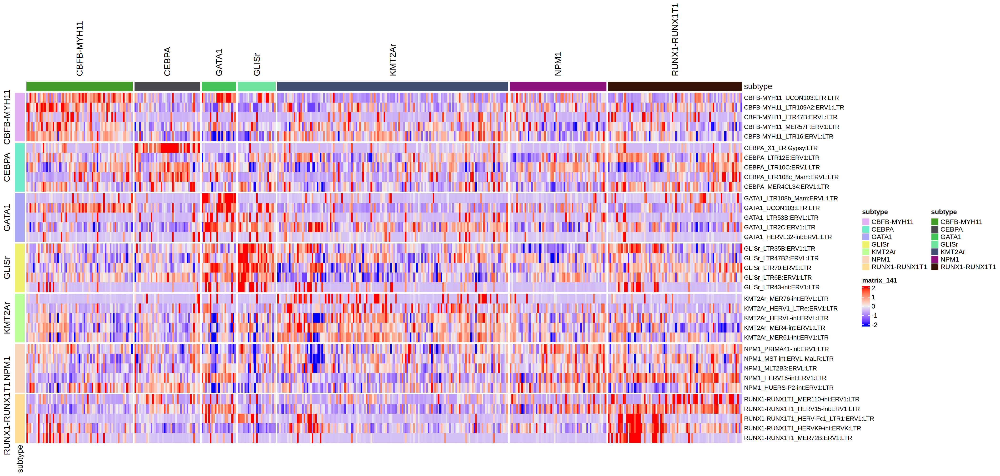

In [887]:
sel = deg_te_dt[class_id %in% c('LTR') & logFC > 0 & FDR < .1 & .id %in% subtype_sel & rn %in% HSC_TE, ] %>% group_by(.id) %>% slice_min(FDR, n = 5) %>% as.data.table()
sel[, subtype := .id]
row_ann = sel[, .(rn, subtype, class_id)]
row_ann[, rname := paste0(subtype, '_', rn) ]
row_ann[, subtype := factor(subtype, levels = subtype_sel)]
row_ann = row_ann[order(subtype), ]
row_ann_df = setDF(row_ann[, 2:ncol(row_ann)], rownames = row_ann$rname)
col_ann = dsn_jude[subtype %in% subtype_sel, .(sample_name, subtype)]
col_ann[, subtype := factor(subtype, levels = subtype_sel) ]
col_ann = col_ann[order(subtype), ]
col_ann_df =  setDF(col_ann[, 2:ncol(col_ann)], rownames = col_ann$sample_name) 

plotdat = logcpm_jude_te_combat[row_ann$rn, rownames(col_ann_df)]
rownames(plotdat) = rownames(row_ann_df)
plotdat = scale_fun(plotdat)
plotdat[plotdat > 2] = 2
plotdat[plotdat < -2] = -2
column_ha = HeatmapAnnotation(df = col_ann_df)
row_ha    = rowAnnotation(df = row_ann_df[, 'subtype', drop = F])
args = list(matrix = plotdat, top_annotation = column_ha,  column_split = factor(col_ann_df$subtype, levels = subtype_sel), show_column_names = F, 
            show_row_names = T, show_column_dend = F, cluster_columns = F,  cluster_rows = F, row_names_gp = grid::gpar(fontsize = 9), 
            show_row_dend = F, column_title_rot = 90, left_annotation = row_ha, row_split = factor(row_ann_df$subtype, levels = (subtype_sel)))
hp = do.call(Heatmap, args)
options(repr.plot.width = 21, repr.plot.height = 10, repr.plot.res = 200)
draw(hp)


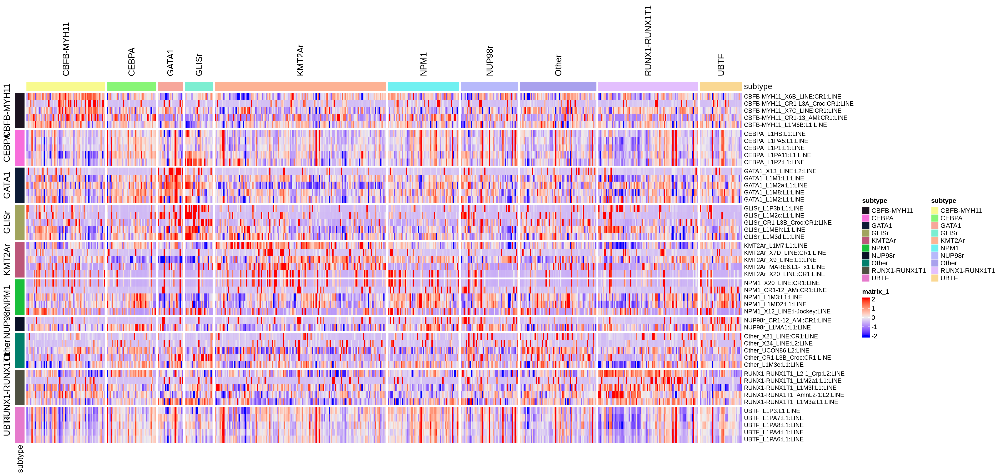

In [60]:
sel = deg_te_dt[class_id %in% c('LINE') & logFC > 0 & FDR < .1 & .id %in% subtype_sel, ] %>% group_by(.id) %>% slice_min(FDR, n = 5) %>% as.data.table()
sel[, subtype := .id]
row_ann = sel[, .(rn, subtype, class_id)]
row_ann[, rname := paste0(subtype, '_', rn) ]
row_ann[, subtype := factor(subtype, levels = subtype_sel)]
row_ann = row_ann[order(subtype), ]
row_ann_df = setDF(row_ann[, 2:ncol(row_ann)], rownames = row_ann$rname)
col_ann = dsn_jude[subtype %in% subtype_sel, .(sample_name, subtype)]
col_ann[, subtype := factor(subtype, levels = subtype_sel) ]
col_ann = col_ann[order(subtype), ]
col_ann_df =  setDF(col_ann[, 2:ncol(col_ann)], rownames = col_ann$sample_name) 

plotdat = logcpm_jude_te_combat[row_ann$rn, rownames(col_ann_df)]
rownames(plotdat) = rownames(row_ann_df)
plotdat = scale_fun(plotdat)
plotdat[plotdat > 2] = 2
plotdat[plotdat < -2] = -2
column_ha = HeatmapAnnotation(df = col_ann_df)
row_ha    = rowAnnotation(df = row_ann_df[, 'subtype', drop = F])
args = list(matrix = plotdat, top_annotation = column_ha,  column_split = factor(col_ann_df$subtype, levels = subtype_sel), show_column_names = F, 
            show_row_names = T, show_column_dend = F, cluster_columns = F,  cluster_rows = F, row_names_gp = grid::gpar(fontsize = 9), 
            show_row_dend = F, column_title_rot = 90, left_annotation = row_ha, row_split = factor(row_ann_df$subtype, levels = (subtype_sel)))
hp = do.call(Heatmap, args)
options(repr.plot.width = 21, repr.plot.height = 10, repr.plot.res = 200)
draw(hp)


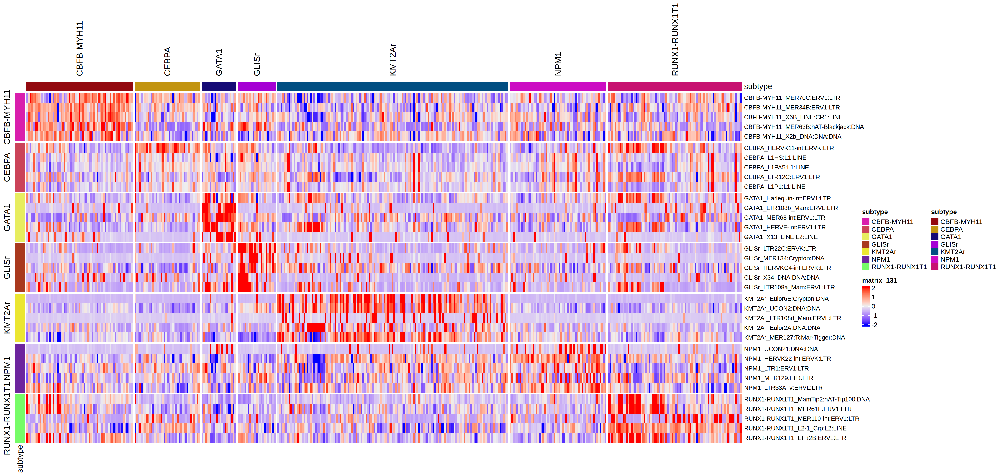

In [841]:
sel = deg_te_dt[class_id %in% c('LTR', 'LINE', 'DNA', 'SINE') & logFC > 0 & FDR < .1 & .id %in% subtype_sel, ] %>% group_by(.id) %>% slice_min(FDR, n = 5) %>% as.data.table()
sel[, subtype := .id]
row_ann = sel[, .(rn, subtype, class_id)]
row_ann[, rname := paste0(subtype, '_', rn) ]
row_ann[, subtype := factor(subtype, levels = subtype_sel)]
row_ann = row_ann[order(subtype), ]
row_ann_df = setDF(row_ann[, 2:ncol(row_ann)], rownames = row_ann$rname)
col_ann = dsn_jude[subtype %in% subtype_sel, .(sample_name, subtype)]
col_ann[, subtype := factor(subtype, levels = subtype_sel) ]
col_ann = col_ann[order(subtype), ]
col_ann_df =  setDF(col_ann[, 2:ncol(col_ann)], rownames = col_ann$sample_name) 

plotdat = logcpm_jude_te_combat[row_ann$rn, rownames(col_ann_df)]
rownames(plotdat) = rownames(row_ann_df)
plotdat = scale_fun(plotdat)
plotdat[plotdat > 2] = 2
plotdat[plotdat < -2] = -2
column_ha = HeatmapAnnotation(df = col_ann_df)
row_ha    = rowAnnotation(df = row_ann_df[, 'subtype', drop = F])
args = list(matrix = plotdat, top_annotation = column_ha,  column_split = factor(col_ann_df$subtype, levels = subtype_sel), show_column_names = F, 
            show_row_names = T, show_column_dend = F, cluster_columns = F,  cluster_rows = F, row_names_gp = grid::gpar(fontsize = 9), 
            show_row_dend = F, column_title_rot = 90, left_annotation = row_ha, row_split = factor(row_ann_df$subtype, levels = (subtype_sel)))
hp = do.call(Heatmap, args)
options(repr.plot.width = 21, repr.plot.height = 10, repr.plot.res = 200)
draw(hp)


In [49]:
#sel = deg_te_dt[class_id %in% c('LTR', 'LINE', 'DNA', 'SINE') & logFC > 1 & FDR < .1 & .id %in% subtype_sel, ] %>% group_by(.id) %>% slice_min(FDR, n = 5) %>% as.data.table()
sel = deg_te_dt[class_id %in% c('LINE') & logFC > 1 & FDR < .1 & .id %in% subtype_sel, ] %>% group_by(.id) %>% slice_min(FDR, n = 5) %>% as.data.table()
sel[, subtype := .id]
row_ann = sel[, .(rn, subtype, class_id)]
row_ann[, rname := paste0(subtype, '_', rn) ]
row_ann[, subtype := factor(subtype, levels = subtype_sel)]
row_ann = row_ann[order(subtype), ]
row_ann_df = setDF(row_ann[, 2:ncol(row_ann)], rownames = row_ann$rname)
col_ann = dsn_jude[, .(sample_name, subtype)]
col_ann[, subtype2 := subtype ]
col_ann[! subtype %in% subtype_sel, subtype2 := 'Other']
col_ann[, subtype2 := factor(subtype2, levels = lvl)]
col_ann = col_ann[order(subtype), ]
col_ann_df =  setDF(col_ann[, 2:ncol(col_ann)], rownames = col_ann$sample_name) 

plotdat = logcpm_jude_te_combat[row_ann$rn, rownames(col_ann_df)]
rownames(plotdat) = rownames(row_ann_df)
plotdat = scale_fun(plotdat)
plotdat[plotdat > 2] = 2
plotdat[plotdat < -2] = -2
column_ha = HeatmapAnnotation(df = col_ann_df[, 'subtype2', drop = F])
row_ha    = rowAnnotation(df = row_ann_df[, 'subtype', drop = F])
args = list(matrix = plotdat, top_annotation = column_ha,  column_split = factor(col_ann_df$subtype2, levels = lvl), show_column_names = F, 
            show_row_names = T, show_column_dend = F, cluster_columns = F,  cluster_rows = F, row_names_gp = grid::gpar(fontsize = 9), 
            show_row_dend = F, column_title_rot = 90, left_annotation = row_ha, row_split = factor(row_ann_df$subtype, levels = (subtype_sel)))
hp = do.call(Heatmap, args)
options(repr.plot.width = 21, repr.plot.height = 10, repr.plot.res = 200)
draw(hp)


ERROR: Error in eval(stub[[3L]], x, enclos): object 'subtype_sel' not found


In [50]:
table(deg_te_dt[class_id %in% c('LINE') & logFC > 1 & FDR < .1 , .id])
subtype_sel = names(table(deg_te_dt[class_id %in% c('LINE') & logFC > 0 & FDR < .1 , .id]))


   CBFB-MYH11         CEBPA         GATA1         GLISr        KMT2Ar 
            2            18             7             8             2 
         NPM1        NUP98r         Other RUNX1-RUNX1T1          UBTF 
            2             1             3             5             3 

In [708]:
#subtype_sel = c('CBFB-MYH11', 'GATA1', 'GLISr', 'RUNX1-RUNX1T1', 'KMT2Ar')

In [846]:
subtype_sel

[1] "CBFB-MYH11"    "CEBPA"         "GATA1"         "GLISr"         "KMT2Ar"        "NPM1"          "RUNX1-RUNX1T1"

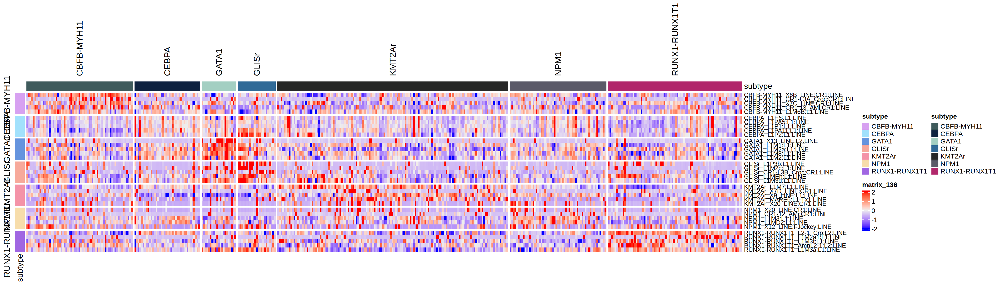

In [847]:
sel = deg_te_dt[class_id %in% c('LINE') & logFC > 0 & FDR < .1 & .id %in% subtype_sel, ] %>% group_by(.id) %>% slice_min(FDR, n = 5) %>% as.data.table()
sel[, subtype := .id]
row_ann = sel[, .(rn, subtype, class_id)]
row_ann[, rname := paste0(subtype, '_', rn) ]
row_ann[, subtype := factor(subtype, levels = subtype_sel)]
row_ann = row_ann[order(subtype), ]
row_ann_df = setDF(row_ann[, 2:ncol(row_ann)], rownames = row_ann$rname)
col_ann = dsn_jude[subtype %in% subtype_sel, .(sample_name, subtype)]
col_ann[, subtype := factor(subtype, levels = subtype_sel) ]
col_ann = col_ann[order(subtype), ]
col_ann_df =  setDF(col_ann[, 2:ncol(col_ann)], rownames = col_ann$sample_name) 

plotdat = logcpm_jude_te_combat[row_ann$rn, rownames(col_ann_df)]
rownames(plotdat) = rownames(row_ann_df)
plotdat = scale_fun(plotdat)
plotdat[plotdat > 2] = 2
plotdat[plotdat < -2] = -2
column_ha = HeatmapAnnotation(df = col_ann_df)
row_ha    = rowAnnotation(df = row_ann_df[, 'subtype', drop = F])
args = list(matrix = plotdat, top_annotation = column_ha,  column_split = factor(col_ann_df$subtype, levels = subtype_sel), show_column_names = F, 
            show_row_names = T, show_column_dend = F, cluster_columns = F,  cluster_rows = F, row_names_gp = grid::gpar(fontsize = 9), 
            show_row_dend = F, column_title_rot = 90, left_annotation = row_ha, row_split = factor(row_ann_df$subtype, levels = (subtype_sel)))
hp = do.call(Heatmap, args)
options(repr.plot.width = 21, repr.plot.height = 6, repr.plot.res = 200)
draw(hp)


In [51]:
sel = deg_te_dt[class_id %in% c('LINE') & logFC > 0 & FDR < .1 & .id %in% subtype_sel, ] %>% group_by(.id) %>% slice_min(FDR, n = 5) %>% as.data.table()
sel[, subtype := .id]
row_ann = sel[, .(rn, subtype, class_id)]
row_ann[, rname := paste0(subtype, '_', rn) ]
row_ann[, subtype := factor(subtype, levels = subtype_sel)]
row_ann = row_ann[order(subtype), ]
row_ann_df = setDF(row_ann[, 2:ncol(row_ann)], rownames = row_ann$rname)
col_ann = dsn_jude[, .(sample_name, subtype)]
col_ann[, subtype2 := subtype ]
col_ann[! subtype %in% subtype_sel, subtype2 := 'Other']
col_ann[, subtype2 := factor(subtype2, levels = lvl)]
col_ann = col_ann[order(subtype), ]
col_ann_df =  setDF(col_ann[, 2:ncol(col_ann)], rownames = col_ann$sample_name) 

plotdat = logcpm_jude_te_combat[row_ann$rn, rownames(col_ann_df)]
rownames(plotdat) = rownames(row_ann_df)
plotdat = scale_fun(plotdat)
plotdat[plotdat > 2] = 2
plotdat[plotdat < -2] = -2
column_ha = HeatmapAnnotation(df = col_ann_df[, 'subtype2', drop = F])
row_ha    = rowAnnotation(df = row_ann_df[, 'subtype', drop = F])
args = list(matrix = plotdat, top_annotation = column_ha,  column_split = factor(col_ann_df$subtype2, levels = lvl), show_column_names = F, 
            show_row_names = T, show_column_dend = F, cluster_columns = F,  cluster_rows = F, row_names_gp = grid::gpar(fontsize = 9), 
            show_row_dend = F, column_title_rot = 90, left_annotation = row_ha, row_split = factor(row_ann_df$subtype, levels = (subtype_sel)))
hp = do.call(Heatmap, args)
options(repr.plot.width = 21, repr.plot.height = 6, repr.plot.res = 200)
draw(hp)


ERROR: Error: object 'logcpm_jude_te_combat' not found


In [608]:
table(deg_te_dt[class_id %in% c('DNA') & logFC > 0 & FDR < .1 , .id])
subtype_sel = names( table(deg_te_dt[class_id %in% c('DNA') & logFC > 0 & FDR < .1 , .id]) )
subtype_sel




   CBFB-MYH11         CEBPA         GATA1         GLISr        KMT2Ar          NPM1        NUP98r         Other RUNX1-RUNX1T1          UBTF 
           71            43            49            36            74            31            12            20            52            24 

[1] "CBFB-MYH11"    "CEBPA"         "GATA1"         "GLISr"         "KMT2Ar"        "NPM1"          "NUP98r"        "Other"         "RUNX1-RUNX1T1" "UBTF"

In [605]:
subtype_sel = c('CEBPA', 'UBTF')

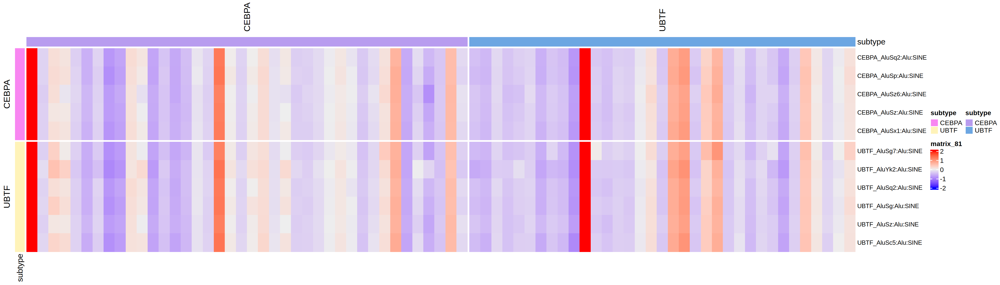

In [606]:
sel = deg_te_dt[class_id %in% c('SINE') & logFC > 0 & FDR < .1 & .id %in% subtype_sel, ] %>% group_by(.id) %>% slice_min(FDR, n = 5) %>% as.data.table()
sel[, subtype := .id]
row_ann = sel[, .(rn, subtype, class_id)]
row_ann[, rname := paste0(subtype, '_', rn) ]
row_ann[, subtype := factor(subtype, levels = subtype_sel)]
row_ann = row_ann[order(subtype), ]
row_ann_df = setDF(row_ann[, 2:ncol(row_ann)], rownames = row_ann$rname)
col_ann = dsn_jude[subtype %in% subtype_sel, .(sample_name, subtype)]
col_ann[, subtype := factor(subtype, levels = subtype_sel) ]
col_ann = col_ann[order(subtype), ]
col_ann_df =  setDF(col_ann[, 2:ncol(col_ann)], rownames = col_ann$sample_name) 

plotdat = logcpm_jude_te_combat[row_ann$rn, rownames(col_ann_df)]
rownames(plotdat) = rownames(row_ann_df)
plotdat = scale_fun(plotdat)
plotdat[plotdat > 2] = 2
plotdat[plotdat < -2] = -2
column_ha = HeatmapAnnotation(df = col_ann_df)
row_ha    = rowAnnotation(df = row_ann_df[, 'subtype', drop = F])
args = list(matrix = plotdat, top_annotation = column_ha,  column_split = factor(col_ann_df$subtype, levels = subtype_sel), show_column_names = F, 
            show_row_names = T, show_column_dend = F, cluster_columns = F,  cluster_rows = F, row_names_gp = grid::gpar(fontsize = 9), 
            show_row_dend = F, column_title_rot = 90, left_annotation = row_ha, row_split = factor(row_ann_df$subtype, levels = (subtype_sel)))
hp = do.call(Heatmap, args)
options(repr.plot.width = 21, repr.plot.height = 6, repr.plot.res = 200)
draw(hp)


In [614]:
table(deg_te_dt[class_id %in% c('DNA') & logFC > 0 & FDR < .1 , .id])
subtype_sel = names( table(deg_te_dt[class_id %in% c('DNA') & logFC > 0 & FDR < .1 , .id]) )
subtype_sel = c('CBFB-MYH11', 'CEBPA', 'GATA1', 'GLISr', 'KMT2Ar', 'RUNX1-RUNX1T1', 'UBTF')
subtype_sel
lvl = c(subtype_sel, 'Other')



   CBFB-MYH11         CEBPA         GATA1         GLISr        KMT2Ar          NPM1        NUP98r         Other RUNX1-RUNX1T1          UBTF 
           71            43            49            36            74            31            12            20            52            24 

[1] "CBFB-MYH11"    "CEBPA"         "GATA1"         "GLISr"         "KMT2Ar"        "RUNX1-RUNX1T1" "UBTF"

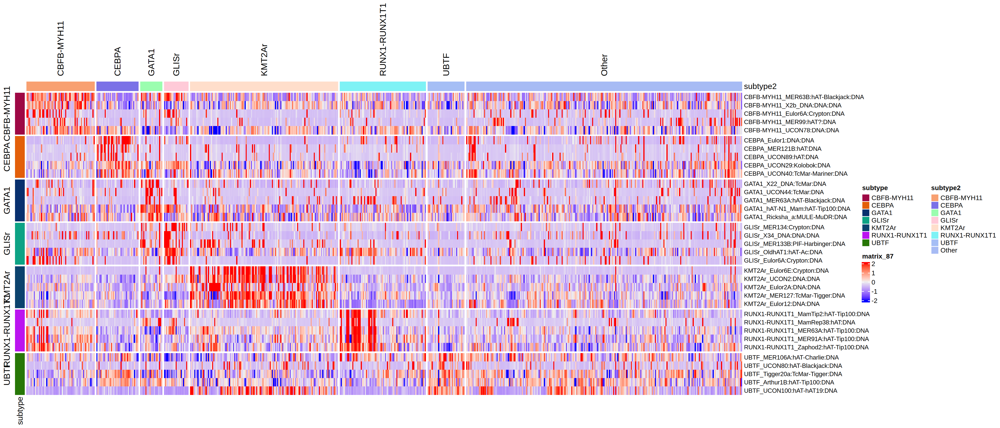

In [617]:
sel = deg_te_dt[class_id %in% c('DNA') & logFC > 0 & FDR < .1 & .id %in% subtype_sel, ] %>% group_by(.id) %>% slice_min(FDR, n = 5) %>% as.data.table()
sel[, subtype := .id]
row_ann = sel[, .(rn, subtype, class_id)]
row_ann[, rname := paste0(subtype, '_', rn) ]
row_ann[, subtype := factor(subtype, levels = subtype_sel)]
row_ann = row_ann[order(subtype), ]
row_ann_df = setDF(row_ann[, 2:ncol(row_ann)], rownames = row_ann$rname)
col_ann = dsn_jude[, .(sample_name, subtype)]
col_ann[, subtype2 := subtype ]
col_ann[! subtype %in% subtype_sel, subtype2 := 'Other']
col_ann[, subtype2 := factor(subtype2, levels = lvl)]
col_ann = col_ann[order(subtype), ]
col_ann_df =  setDF(col_ann[, 2:ncol(col_ann)], rownames = col_ann$sample_name) 

plotdat = logcpm_jude_te_combat[row_ann$rn, rownames(col_ann_df)]
rownames(plotdat) = rownames(row_ann_df)
plotdat = scale_fun(plotdat)
plotdat[plotdat > 2] = 2
plotdat[plotdat < -2] = -2
column_ha = HeatmapAnnotation(df = col_ann_df[, 'subtype2', drop = F])
row_ha    = rowAnnotation(df = row_ann_df[, 'subtype', drop = F])
args = list(matrix = plotdat, top_annotation = column_ha,  column_split = factor(col_ann_df$subtype2, levels = lvl), show_column_names = F, 
            show_row_names = T, show_column_dend = F, cluster_columns = F,  cluster_rows = F, row_names_gp = grid::gpar(fontsize = 9), 
            show_row_dend = F, column_title_rot = 90, left_annotation = row_ha, row_split = factor(row_ann_df$subtype, levels = (subtype_sel)))
hp = do.call(Heatmap, args)
options(repr.plot.width = 21, repr.plot.height = 9, repr.plot.res = 200)
draw(hp)


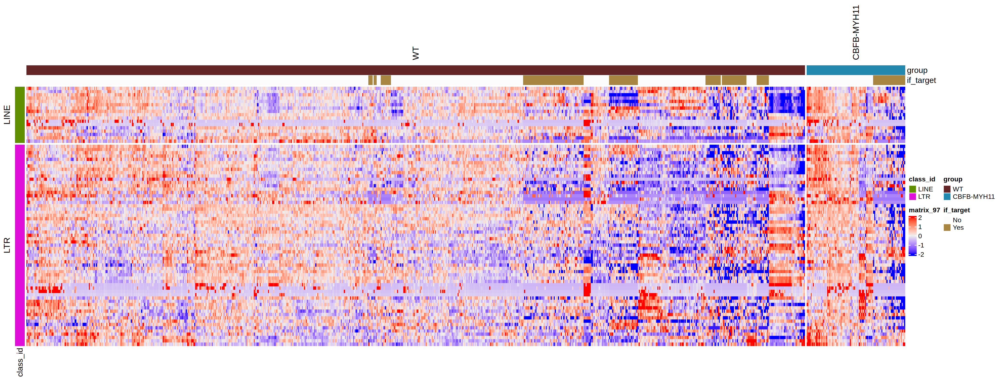

In [630]:
sel = unique(deg_te_dt[.id == 'CBFB-MYH11' & (logFC) > 0 & FDR < 0.1 & class_id %in% c('LTR', 'LINE'),]) 
te_sel = unique(sel$rn)
row_ann = sel[!duplicated(rn), .(rn, class_id)]
row_ann_df = setDF(row_ann[, 2:ncol(row_ann)], rownames = row_ann$rn)
dsn_sel[, group := 'WT'] 
dsn_sel[subtype == 'CBFB-MYH11', group := 'CBFB-MYH11'] 
dsn_sel_df = setDF(dsn_sel[, .(group, if_target)], rownames = dsn_sel$sample_name) 

plotdat = logcpm_jude_te_combat[te_sel, rownames(dsn_sel_df)]
plotdat = scale_fun(plotdat)
plotdat[plotdat > 2] = 2
plotdat[plotdat < -2] = -2
column_ha = HeatmapAnnotation(df = dsn_sel_df)
row_ha    = rowAnnotation(df = row_ann_df)
args = list(matrix = plotdat, top_annotation = column_ha,  column_split = factor(dsn_sel$group), show_column_names = F, 
            show_row_names = F, show_column_dend = F, cluster_columns = T,  cluster_rows = T, row_names_gp = grid::gpar(fontsize = 7), 
            show_row_dend = F, column_title_rot = 90, left_annotation = row_ha, row_split = row_ann_df$class_id)
hp = do.call(Heatmap, args)
options(repr.plot.width = 21, repr.plot.height = 8, repr.plot.res = 200)
draw(hp)


In [462]:
dsn_sel[, if_target := 'No' ]
dsn_sel[grep('TARGET', sample_name), if_target := 'Yes' ]

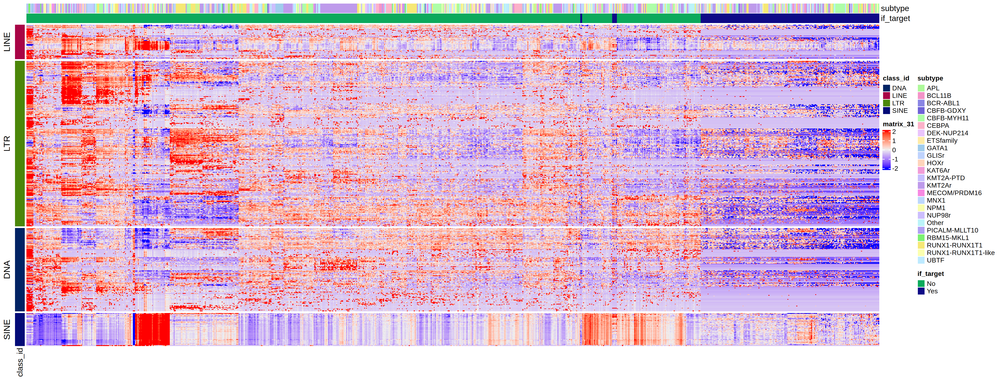

In [463]:
sel = unique(deg_te_dt[abs(logFC) > 1 & FDR < 0.05 & class_id %in% c('LTR', 'LINE', 'DNA', 'SINE'),]) 
te_sel = unique(sel$rn)
row_ann = sel[!duplicated(rn), .(rn, class_id)]
row_ann_df = setDF(row_ann[, 2:ncol(row_ann)], rownames = row_ann$rn)
dsn_sel_df = setDF(dsn_sel[, .(subtype, if_target)], rownames = dsn_sel$sample_name) 

plotdat = logcpm_jude_te_combat[te_sel, rownames(dsn_sel_df)]
plotdat = scale_fun(plotdat)
plotdat[plotdat > 2] = 2
plotdat[plotdat < -2] = -2
column_ha = HeatmapAnnotation(df = dsn_sel_df)
row_ha    = rowAnnotation(df = row_ann_df)
args = list(matrix = plotdat, top_annotation = column_ha,  show_column_names = F, 
            show_row_names = F, show_column_dend = F, cluster_columns = T,  cluster_rows = T, row_names_gp = grid::gpar(fontsize = 7), 
            show_row_dend = F, column_title_rot = 90, left_annotation = row_ha, row_split = row_ann_df$class_id)
hp = do.call(Heatmap, args)
options(repr.plot.width = 21, repr.plot.height = 8, repr.plot.res = 200)
draw(hp)


In [411]:
te_sel = deg_te_dt[FDR < 0.1,] %>% group_by(.id) %>% slice_min(order_by = FDR, n = 10)
head(te_sel)

.id,rn,logFC,logCPM,PValue,FDR,class_id,family_id,gene_id
<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>
BCL11B,LTR46-int:ERV1:LTR,2.811806,5.8370337,3.083825e-20,4.039811e-17,LTR,ERV1,LTR46-int
BCL11B,UCON61:Unknown:Unknown,2.821590,-0.4795172,7.406643e-16,4.851351e-13,Unknown,Unknown,UCON61
BCL11B,MER65A:ERV1:LTR,0.975523,7.6168240,1.560690e-12,6.815012e-10,LTR,ERV1,MER65A
BCL11B,LTR12B:ERV1:LTR,2.428438,5.0466167,1.913458e-09,5.126604e-07,LTR,ERV1,LTR12B
BCL11B,Helitron3Na_Mam:Helitron:RC,1.023021,7.6751356,1.956719e-09,5.126604e-07,RC,Helitron,Helitron3Na_Mam
BCL11B,MSR1:Satellite:Satellite,1.382190,7.4023375,3.797578e-07,7.748693e-05,Satellite,Satellite,MSR1


In [422]:
subtypes

[1] "APL"                "BCL11B"             "BCR-ABL1"           "CBFB-GDXY"          "CBFB-MYH11"         "CEBPA"              "DEK-NUP214"         "ETSfamily"         
 [9] "GATA1"              "GLISr"              "HOXr"               "KAT6Ar"             "KMT2A-PTD"          "KMT2Ar"             "MECOM/PRDM16"       "MNX1"              
[17] "NPM1"               "NUP98r"             "Other"              "PICALM-MLLT10"      "RBM15-MKL1"         "RUNX1-RUNX1T1"      "RUNX1-RUNX1T1-like" "UBTF"

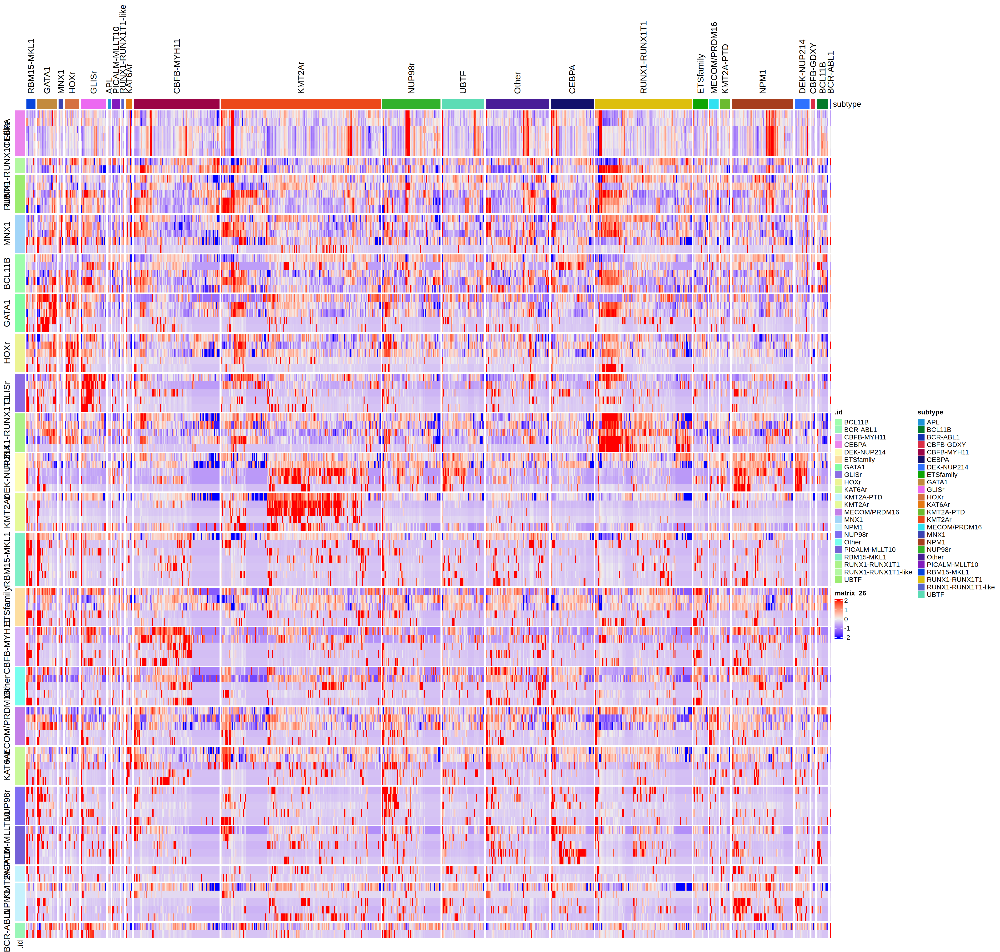

In [430]:
te_sel = as.data.frame(deg_te_dt[FDR < 0.1 & logFC > 1,] %>% group_by(.id) %>% slice_min(order_by = FDR, n = 5))
te_sel$row_name = paste0(te_sel$.id , '_', te_sel$rn) 
te_sel$.id = factor(te_sel$.id, levels = subtypes)
rownames(te_sel) = te_sel$row_name
dsn_sel_df = setDF(dsn_sel[, .(subtype)], rownames = dsn_sel$sample_name)
dsn_sel_df$subtype = factor(dsn_sel_df$subtype, levels = subtypes)
plotdat = logcpm_jude_te_combat[te_sel$rn, rownames(dsn_sel_df)]
plotdat = scale_fun(plotdat)
plotdat[plotdat > 2] = 2
plotdat[plotdat < -2] = -2
rownames(plotdat) = te_sel$row_name 
column_ha = HeatmapAnnotation(df = dsn_sel_df)
row_ha    = rowAnnotation(df = te_sel[, '.id', drop = F])
args = list(matrix = plotdat, top_annotation = column_ha,  column_split = factor(dsn_sel$subtype), show_column_names = F, 
            show_row_names = F, show_column_dend = F, cluster_columns = T,  cluster_rows = T, row_names_gp = grid::gpar(fontsize = 7), 
            show_row_dend = F, column_title_rot = 90, left_annotation = row_ha, row_split = te_sel$.id, row_title_rot = 90)
hp = do.call(Heatmap, args)
options(repr.plot.width = 21, repr.plot.height = 20, repr.plot.res = 200)
draw(hp)


In [404]:
dim(plotdat)

[1] 594 856

# load TElocal & DEG

## TElocal DEG

In [14]:
dsn_sel[, telocal_file := paste0(sample_dir, 'telocal.cntTable')]


In [15]:
dsn_sel[1, telocal_file]

[1] "/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/pediatrics/data/SJ007022/telocal.cntTable"

In [ ]:
telocal_dt = fread(dsn[1, telocal_file])
setnames(telocal_dt, 1, 'gene')
setnames(telocal_dt, 2, dsn[1, sample_name])

inv = lapply(2:nrow(dsn), function(ii){
    tmp = fread(dsn[1, telocal_file])
    setnames(tmp, 1, 'gene')
    setnames(tmp, 2, dsn[ii, sample_name])
    telocal_dt = merge(telocal_dt, tmp, by = 'gene')
})

In [656]:
telocal_list = lapply(1:nrow(dsn_sel), function (ii) {
    fname = dsn_sel[ii, telocal_file]
    sample_name = dsn_sel[ii, sample_name]
    tmp = fread(fname)
    setnames(tmp, 1, 'gene')
    setnames(tmp, 2, sample_name)
    tmp
})

message('mergeing data')

fun = function(x, y){ merge(x, y, by = 'gene') }
count_telocal_dt = Reduce(f = fun, telocal_list)
count_telocal_df = setDF(count_telocal_dt[, 2:ncol(count_telocal_dt)], rownames = count_telocal_dt$gene)
saveRDS(count_telocal_df, file = 'pAML_telocal_df.rds') 


In [143]:
count_telocal_df = readRDS(file = 'pAML_telocal_df.rds') 


In [145]:
logcpm_telocal_full = logcpm_fun(count_telocal_df)


In [147]:
saveRDS(logcpm_telocal_full, file = 'logcpm_telocal_full.rds')


In [146]:
head(logcpm_telocal_full)

,SJ007022,SJ007030,SJ007034,SJ007110,SJ007122,SJ030118,SJ030324,SJ045742,SJ031259,SJ031302,⋯,TARGET-21-PASSLT,TARGET-21-PASTZK,TARGET-21-PASVJS,TARGET-21-PASYWA,TARGET-21-PATAIJ,TARGET-21-PATISD,TARGET-21-PATJMY,TARGET-21-PATKBK,TARGET-21-PATKKJ,TARGET-21-PASFLG
(CATTC)n:(CATTC)n:Satellite:Satellite,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,⋯,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579
(CATTC)n_dup100:(CATTC)n:Satellite:Satellite,-2.741619,-4.222579,-4.222579,-4.222579,-3.761222,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,⋯,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579
(CATTC)n_dup101:(CATTC)n:Satellite:Satellite,-2.340125,-3.422398,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,⋯,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579
(CATTC)n_dup102:(CATTC)n:Satellite:Satellite,-3.299869,-4.222579,-4.222579,-4.222579,-3.761222,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,⋯,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579
(CATTC)n_dup103:(CATTC)n:Satellite:Satellite,-4.222579,-3.422398,-4.222579,-4.222579,-3.761222,-4.222579,-4.222579,-4.222579,-3.209204,-4.222579,⋯,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579
(CATTC)n_dup104:(CATTC)n:Satellite:Satellite,-2.741619,-2.235157,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,-3.040786,-4.222579,-3.518441,⋯,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579,-4.222579


In [811]:
tmp = rownames(count_telocal_df)
tmp = unlist(lapply(tmp, function(xx){unlist(strsplit(xx, ':'))[4]}))
table(tmp)

tmp
           DNA           DNA?           LINE Low_complexity            LTR             RC     Retroposon      Satellite           SINE         srpRNA        Unknown 
        459141             76        1005777             17         545315           1877           6728          39070        1707406             16          22526 

In [812]:
mtx1 = count_telocal_df[grep(':DNA$|:LTR$|:LINE$|:SINE$', rownames(count_telocal_df)), dsn_jude$sample_name]
dim(mtx1)
row_sum = rowSums(mtx1, 1) 
mtx2 = mtx1[row_sum > ncol(mtx1) * 1, ] 
nrow(mtx2) / nrow(mtx1)


[1] 3717639     670

[1] 0.1704719

In [813]:
te_sel = deg_te_dt[FDR < .1, rn]
mtx3 = mtx2[sub('(.*?):(.*)', '\\2', rownames(mtx2)) %in% te_sel, ]
dim(mtx3) 


[1] 619968    670

In [814]:
tmp = rownames(mtx3)
tmp = unlist(lapply(tmp, function(xx){unlist(strsplit(xx, ':'))[4]}))
table(tmp)

tmp
   DNA   LINE    LTR   SINE 
 61902 209311  65589 283166 

In [714]:
# as the above for TEcount DEG analysis:
subtype_sel = c('CBFB-MYH11', 'CEBPA', 'GATA1', 'GLISr', 'KMT2Ar', 'NPM1', 'RUNX1-RUNX1T1' )
lvl = c('CBFB-MYH11', 'CEBPA', 'GATA1', 'GLISr', 'KMT2Ar', 'NPM1', 'RUNX1-RUNX1T1', 'Other' )

In [694]:
all(colnames(mtx3) == dsn_jude$sample_name)

[1] TRUE

In [699]:
logcpm_telocal = logcpm_fun(mtx3)

In [702]:
saveRDS(logcpm_telocal, file = 'logcpm_jude_telocal.rds')


In [743]:
subtypes

[1] "CBFB-MYH11"         "RUNX1-RUNX1T1"      "KMT2Ar"             "NPM1"               "RUNX1-RUNX1T1-like" "UBTF"               "GATA1"              "Other"             
 [9] "HOXr"               "GLISr"              "NUP98r"             "KAT6Ar"             "RBM15-MKL1"         "MNX1"               "BCR-ABL1"           "CEBPA"             
[17] "DEK-NUP214"         "KMT2A-PTD"          "ETSfamily"          "CBFB-GDXY"          "MECOM/PRDM16"       "APL"                "PICALM-MLLT10"      "BCL11B"

In [817]:
save(subtypes, mtx3, dsn_jude, deg_fun2, file = 'run.rdata')


In [705]:
library(data.table)
library(edgeR)
load('run.rdata')

deg_telocal_list = lapply(1:length(subtypes), function(ii){
    dsn_jude[, group := 'other' ]
    dsn_jude[subtype %in% subtypes[ii], group := 'selected' ]
    dsn_jude[, group := factor(group, levels = c('other', 'selected') ) ]
    deg_fun2(dsn_jude, mtx3[, dsn_jude$sample_name])
}) 
names(deg_telocal_list) = subtypes 
deg_telocal_dt = rbindlist(deg_telocal_list, idcol = T)
deg_telocal_dt[, class_id  := unlist(strsplit(rn , ':'))[4], by = 1:nrow(deg_telocal_dt) ]
deg_telocal_dt[, family_id := unlist(strsplit(rn , ':'))[3], by = 1:nrow(deg_telocal_dt) ]
deg_telocal_dt[, gene_id   := unlist(strsplit(rn , ':'))[2], by = 1:nrow(deg_telocal_dt) ]
deg_telocal_dt[, tx_id     := unlist(strsplit(rn , ':'))[1], by = 1:nrow(deg_telocal_dt) ]
saveRDS(deg_telocal_dt, file = 'deg_jude_telocal_dt_4classes.rds')


In [774]:
deg_jude_telocal_dt[, class_id  := unlist(strsplit(rn , ':'))[4], by = 1:nrow(deg_jude_telocal_dt) ]
deg_jude_telocal_dt[, family_id := unlist(strsplit(rn , ':'))[3], by = 1:nrow(deg_jude_telocal_dt) ]
deg_jude_telocal_dt[, gene_id   := unlist(strsplit(rn , ':'))[2], by = 1:nrow(deg_jude_telocal_dt) ]
deg_jude_telocal_dt[, tx_id     := unlist(strsplit(rn , ':'))[1], by = 1:nrow(deg_jude_telocal_dt) ]


In [775]:
saveRDS(deg_jude_telocal_dt, file = 'deg_jude_telocal_dt.rds')


In [140]:
deg_jude_telocal_dt = readRDS('deg_jude_telocal_dt.rds')

In [141]:
dim(deg_jude_telocal_dt)
head(deg_jude_telocal_dt)

[1] 8083248      10

.id,rn,logFC,logCPM,PValue,FDR,class_id,family_id,gene_id,tx_id
<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>
CBFB-MYH11,LTR90B_dup437:LTR90B:LTR:LTR,3.961352,0.22298796,3.378347e-75,1.137834e-69,LTR,LTR,LTR90B,LTR90B_dup437
CBFB-MYH11,MER51A_dup52:MER51A:ERV1:LTR,4.069559,0.01015551,1.353068e-69,2.278580e-64,LTR,ERV1,MER51A,MER51A_dup52
CBFB-MYH11,L1MCa_dup2511:L1MCa:L1:LINE,3.951593,3.02363543,2.088757e-67,2.344992e-62,LINE,L1,L1MCa,L1MCa_dup2511
CBFB-MYH11,L3_dup4132:L3:CR1:LINE,3.504512,2.49698398,5.802855e-64,4.886033e-59,LINE,CR1,L3,L3_dup4132
CBFB-MYH11,L1PA7_dup4273:L1PA7:L1:LINE,2.905918,6.94637811,2.704159e-63,1.821532e-58,LINE,L1,L1PA7,L1PA7_dup4273
CBFB-MYH11,MLT1A_dup4514:MLT1A:ERVL-MaLR:LTR,3.178018,1.46363839,1.739011e-62,9.761705e-58,LTR,ERVL-MaLR,MLT1A,MLT1A_dup4514


Warning message in melt.data.table(as.data.table(as.data.frame.matrix(table(deg_jude_telocal_dt[FDR < :
"id.vars and measure.vars are internally guessed when both are 'NULL'. All non-numeric/integer/logical type columns are considered id.vars, which in this case are columns [rn, ...]. Consider providing at least one of 'id' or 'measure' vars in future."


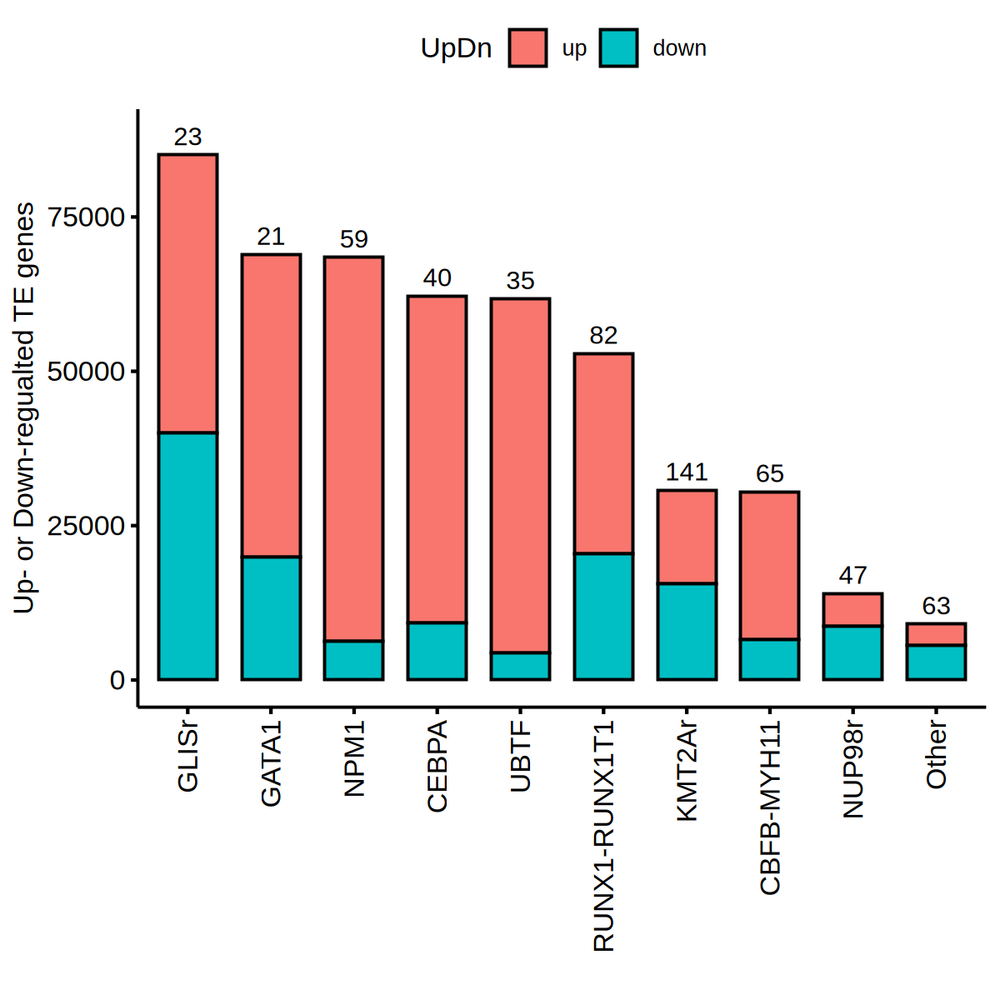

In [902]:
plotdat = melt(as.data.table(as.data.frame.matrix(table(deg_jude_telocal_dt[FDR < 0.05 & abs(logFC) > 1 & class_id %in% c('LTR', 'LINE', 'DNA'), .(sign(logFC), .id)])), keep.rownames = T))
plotdat[, nn := sum(.SD$value), by = 'variable' ]
lvl = plotdat[!duplicated(variable), ][order(nn, decreasing = T), variable]
plotdat[, subtype := factor(variable, levels = lvl) ]
plotdat[, UpDn := 'down' ]
plotdat[rn < 1, UpDn := 'up' ]
plotdat[, UpDn := factor(UpDn, levels = c('up', 'down'))]
plotdat = plotdat[variable %in% subtype_bar_sel, ]

tmp = as.data.table(table(dsn_jude[, subtype]), keep.rownames = T)

plotdat = merge(plotdat, tmp, by.x = 'variable', by.y = 'V1', all.x = T) 

options(repr.plot.width = 6, repr.plot.height = 6, repr.plot.res = 200)
lbl = plotdat[!duplicated(subtype), ][order(nn, decreasing = T), ]
lbl[, yy := nn + 3000 ] 
ggbarplot(plotdat, x = 'subtype', y = 'value', fill = 'UpDn') + rotate_x_text() + xlab('') + ylab('Up- or Down-regualted TE genes') + 
geom_text(inherit.aes = F, data = lbl, aes(subtype, y = yy, label = N))


In [ ]:
plotdat = plotdat[variable %in% c(), ]

In [895]:
head(plotdat)

variable,rn,value,nn,subtype,UpDn,N
<chr>,<chr>,<int>,<int>,<fct>,<fct>,<int>
APL,-1,1,335,APL,up,3
APL,1,334,335,APL,down,3
BCL11B,-1,1243,3398,BCL11B,up,6
BCL11B,1,2155,3398,BCL11B,down,6
BCR-ABL1,-1,0,3,BCR-ABL1,up,1
BCR-ABL1,1,3,3,BCR-ABL1,down,1


In [903]:
head(deg_telocal_dt)

.id,rn,logFC,logCPM,PValue,FDR,class_id,family_id,gene_id,tx_id
<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>
CBFB-MYH11,LTR90B_dup437:LTR90B:LTR:LTR,3.961352,0.22298796,3.378347e-75,1.137834e-69,LTR,LTR,LTR90B,LTR90B_dup437
CBFB-MYH11,MER51A_dup52:MER51A:ERV1:LTR,4.069559,0.01015551,1.353068e-69,2.278580e-64,LTR,ERV1,MER51A,MER51A_dup52
CBFB-MYH11,L1MCa_dup2511:L1MCa:L1:LINE,3.951593,3.02363543,2.088757e-67,2.344992e-62,LINE,L1,L1MCa,L1MCa_dup2511
CBFB-MYH11,L3_dup4132:L3:CR1:LINE,3.504512,2.49698398,5.802855e-64,4.886033e-59,LINE,CR1,L3,L3_dup4132
CBFB-MYH11,L1PA7_dup4273:L1PA7:L1:LINE,2.905918,6.94637811,2.704159e-63,1.821532e-58,LINE,L1,L1PA7,L1PA7_dup4273
CBFB-MYH11,MLT1A_dup4514:MLT1A:ERVL-MaLR:LTR,3.178018,1.46363839,1.739011e-62,9.761705e-58,LTR,ERVL-MaLR,MLT1A,MLT1A_dup4514


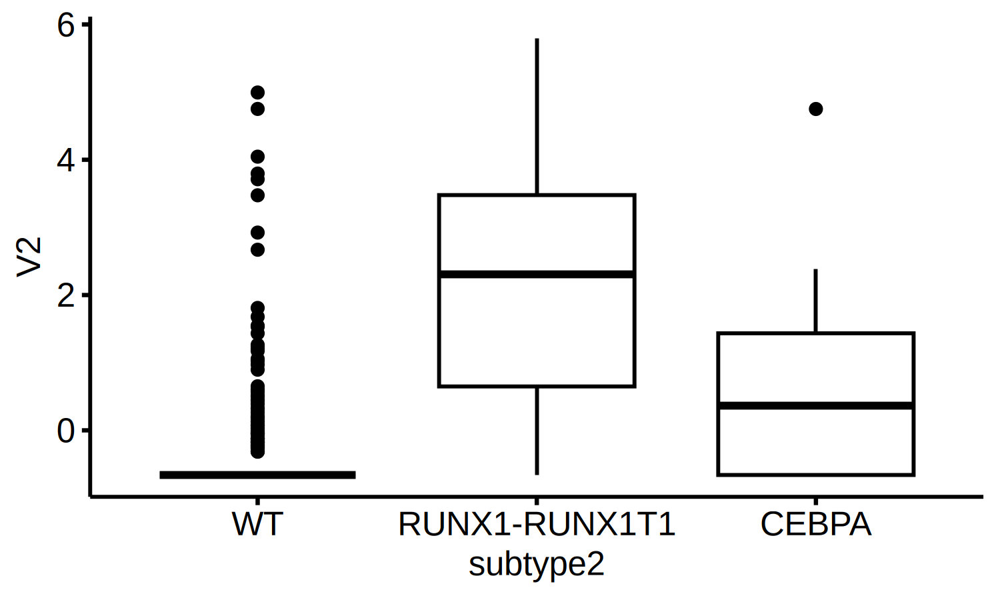

In [751]:
plotdat = merge(as.data.table(logcpm_telocal['MamRep1151_dup674:MamRep1151:LTR:LTR',], keep.rownames = T), dsn_jude[, .(sample_name, subtype)], by.x = 'V1', by.y = 'sample_name')
plotdat[, subtype2 := 'WT']
plotdat[subtype == 'CEBPA', subtype2 := 'CEBPA']
plotdat[subtype == 'RUNX1-RUNX1T1', subtype2 := 'RUNX1-RUNX1T1']
options(repr.plot.width = 5, repr.plot.height = 3, repr.plot.res = 300)
ggboxplot(plotdat, x = 'subtype2', y = 'V2')

In [ ]:
sel = deg_telocal_dt[class_id %in% c('LTR', 'LINE', 'DNA') & logFC > 0 & FDR < .1 & .id %in% subtype_sel & rn %in% HSC_TElocal, ] %>% group_by(.id) %>% slice_min(FDR, n = 10) %>% as.data.table()
sel[, subtype := .id]
row_ann = sel[, .(rn, subtype, class_id)]
row_ann[, rname := paste0(subtype, '_', rn) ]
row_ann[, subtype := factor(subtype, levels = subtype_sel)]
row_ann = row_ann[order(subtype), ]
row_ann_df = setDF(row_ann[, 2:ncol(row_ann)], rownames = row_ann$rname)
col_ann = dsn_jude[, .(sample_name, subtype)]
col_ann[, subtype2 := subtype ]
col_ann[! subtype %in% subtype_sel, subtype2 := 'Other']
col_ann[, subtype2 := factor(subtype2, levels = lvl)]
col_ann = col_ann[order(subtype), ]
col_ann_df =  setDF(col_ann[, 2:ncol(col_ann)], rownames = col_ann$sample_name) 

plotdat = logcpm_telocal[row_ann$rn, rownames(col_ann_df)]
rownames(plotdat) = rownames(row_ann_df) 
plotdat = scale_fun(plotdat)
plotdat[plotdat > 2] = 2
plotdat[plotdat < -2] = -2
column_ha = HeatmapAnnotation(df = col_ann_df[, 'subtype2', drop = F])
row_ha    = rowAnnotation(df = row_ann_df[, 'subtype', drop = F])
args = list(matrix = plotdat, top_annotation = column_ha,  column_split = factor(col_ann_df$subtype2, levels = lvl), show_column_names = F, 
            show_row_names = T, show_column_dend = F, cluster_columns = F,  cluster_rows = F, row_names_gp = grid::gpar(fontsize = 6), 
            show_row_dend = F, column_title_rot = 90, left_annotation = row_ha, row_split = factor(row_ann_df$subtype, levels = (subtype_sel)))
hp = do.call(Heatmap, args)
options(repr.plot.width = 21, repr.plot.height = 9, repr.plot.res = 200)
draw(hp)


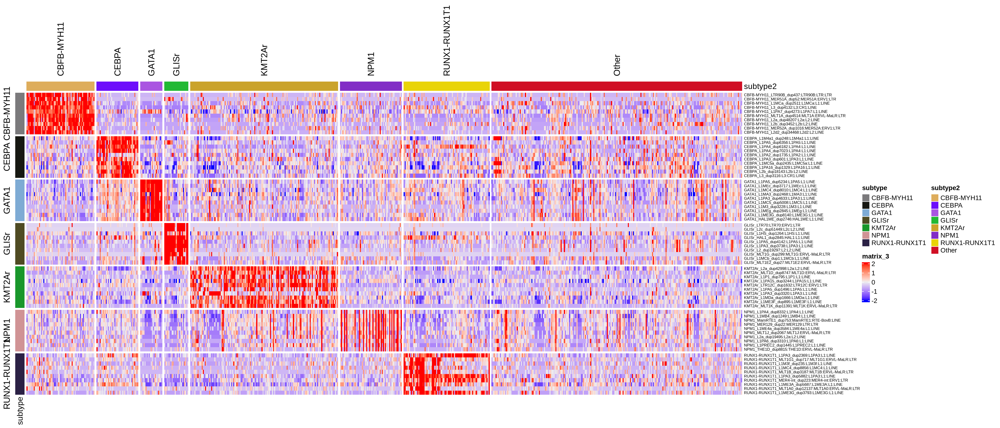

In [124]:
sel = deg_telocal_dt[class_id %in% c('LTR', 'LINE') & logFC > 0 & FDR < .1 & .id %in% subtype_sel, ] %>% group_by(.id) %>% slice_min(FDR, n = 10) %>% as.data.table()
sel[, subtype := .id]
row_ann = sel[, .(rn, subtype, class_id)]
row_ann[, rname := paste0(subtype, '_', rn) ]
row_ann[, subtype := factor(subtype, levels = subtype_sel)]
row_ann = row_ann[order(subtype), ]
row_ann_df = setDF(row_ann[, 2:ncol(row_ann)], rownames = row_ann$rname)
col_ann = dsn_jude[, .(sample_name, subtype)]
col_ann[, subtype2 := subtype ]
col_ann[! subtype %in% subtype_sel, subtype2 := 'Other']
col_ann[, subtype2 := factor(subtype2, levels = lvl)]
col_ann = col_ann[order(subtype), ]
col_ann_df =  setDF(col_ann[, 2:ncol(col_ann)], rownames = col_ann$sample_name) 

plotdat = logcpm_telocal[row_ann$rn, rownames(col_ann_df)]
rownames(plotdat) = rownames(row_ann_df) 
plotdat = scale_fun(plotdat)
plotdat[plotdat > 2] = 2
plotdat[plotdat < -2] = -2
column_ha = HeatmapAnnotation(df = col_ann_df[, 'subtype2', drop = F])
row_ha    = rowAnnotation(df = row_ann_df[, 'subtype', drop = F])
args = list(matrix = plotdat, top_annotation = column_ha,  column_split = factor(col_ann_df$subtype2, levels = lvl), show_column_names = F, 
            show_row_names = T, show_column_dend = F, cluster_columns = F,  cluster_rows = F, row_names_gp = grid::gpar(fontsize = 6), 
            show_row_dend = F, column_title_rot = 90, left_annotation = row_ha, row_split = factor(row_ann_df$subtype, levels = (subtype_sel)))
hp = do.call(Heatmap, args)
options(repr.plot.width = 21, repr.plot.height = 9, repr.plot.res = 200)
draw(hp)


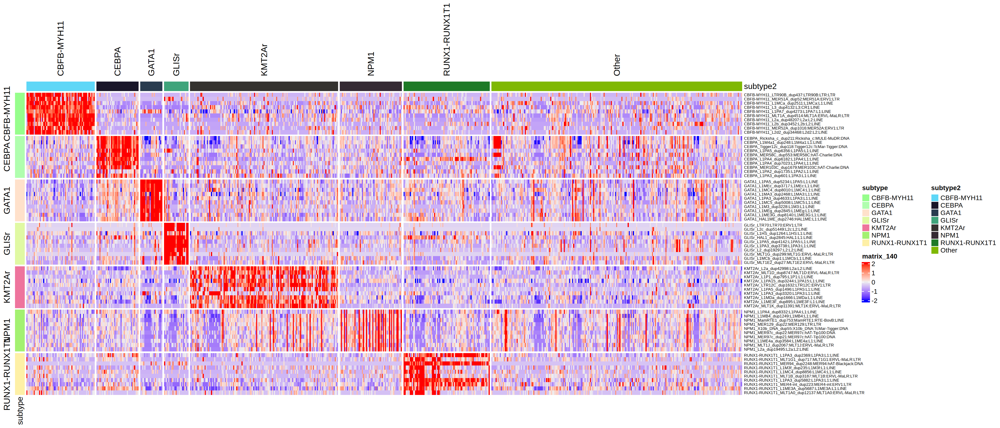

In [851]:
sel = deg_telocal_dt[class_id %in% c('LTR', 'LINE', 'DNA') & logFC > 0 & FDR < .1 & .id %in% subtype_sel, ] %>% group_by(.id) %>% slice_min(FDR, n = 10) %>% as.data.table()
sel[, subtype := .id]
row_ann = sel[, .(rn, subtype, class_id)]
row_ann[, rname := paste0(subtype, '_', rn) ]
row_ann[, subtype := factor(subtype, levels = subtype_sel)]
row_ann = row_ann[order(subtype), ]
row_ann_df = setDF(row_ann[, 2:ncol(row_ann)], rownames = row_ann$rname)
col_ann = dsn_jude[, .(sample_name, subtype)]
col_ann[, subtype2 := subtype ]
col_ann[! subtype %in% subtype_sel, subtype2 := 'Other']
col_ann[, subtype2 := factor(subtype2, levels = lvl)]
col_ann = col_ann[order(subtype), ]
col_ann_df =  setDF(col_ann[, 2:ncol(col_ann)], rownames = col_ann$sample_name) 

plotdat = logcpm_telocal[row_ann$rn, rownames(col_ann_df)]
rownames(plotdat) = rownames(row_ann_df) 
plotdat = scale_fun(plotdat)
plotdat[plotdat > 2] = 2
plotdat[plotdat < -2] = -2
column_ha = HeatmapAnnotation(df = col_ann_df[, 'subtype2', drop = F])
row_ha    = rowAnnotation(df = row_ann_df[, 'subtype', drop = F])
args = list(matrix = plotdat, top_annotation = column_ha,  column_split = factor(col_ann_df$subtype2, levels = lvl), show_column_names = F, 
            show_row_names = T, show_column_dend = F, cluster_columns = F,  cluster_rows = F, row_names_gp = grid::gpar(fontsize = 6), 
            show_row_dend = F, column_title_rot = 90, left_annotation = row_ha, row_split = factor(row_ann_df$subtype, levels = (subtype_sel)))
hp = do.call(Heatmap, args)
options(repr.plot.width = 21, repr.plot.height = 9, repr.plot.res = 200)
draw(hp)


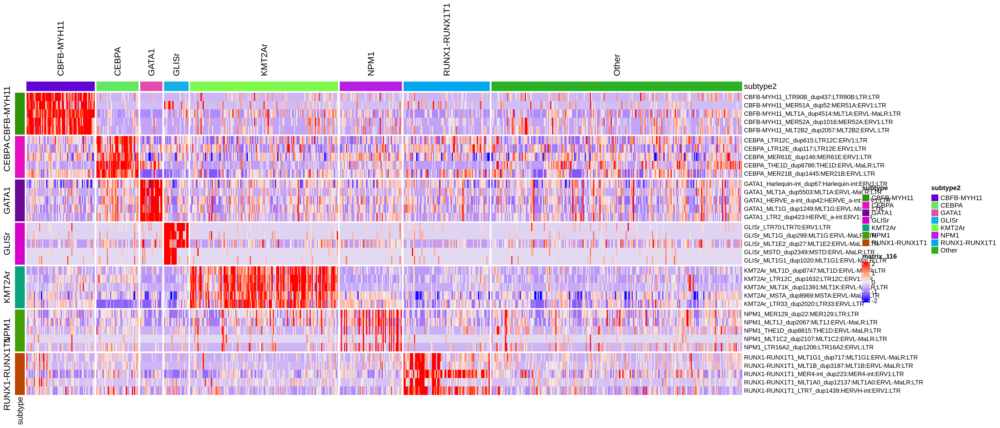

In [779]:
sel = deg_telocal_dt[class_id %in% c('LTR') & logFC > 0 & FDR < .1 & .id %in% subtype_sel, ] %>% group_by(.id) %>% slice_min(FDR, n = 5) %>% as.data.table()
sel[, subtype := .id]
row_ann = sel[, .(rn, subtype, class_id)]
row_ann[, rname := paste0(subtype, '_', rn) ]
row_ann[, subtype := factor(subtype, levels = subtype_sel)]
row_ann = row_ann[order(subtype), ]
row_ann_df = setDF(row_ann[, 2:ncol(row_ann)], rownames = row_ann$rname)
col_ann = dsn_jude[, .(sample_name, subtype)]
col_ann[, subtype2 := subtype ]
col_ann[! subtype %in% subtype_sel, subtype2 := 'Other']
col_ann[, subtype2 := factor(subtype2, levels = lvl)]
col_ann = col_ann[order(subtype), ]
col_ann_df =  setDF(col_ann[, 2:ncol(col_ann)], rownames = col_ann$sample_name) 

plotdat = logcpm_telocal[row_ann$rn, rownames(col_ann_df)]
rownames(plotdat) = rownames(row_ann_df)
plotdat = scale_fun(plotdat)
plotdat[plotdat > 2] = 2
plotdat[plotdat < -2] = -2
column_ha = HeatmapAnnotation(df = col_ann_df[, 'subtype2', drop = F])
row_ha    = rowAnnotation(df = row_ann_df[, 'subtype', drop = F])
args = list(matrix = plotdat, top_annotation = column_ha,  column_split = factor(col_ann_df$subtype2, levels = lvl), show_column_names = F, 
            show_row_names = T, show_column_dend = F, cluster_columns = F,  cluster_rows = F, row_names_gp = grid::gpar(fontsize = 9), 
            show_row_dend = F, column_title_rot = 90, left_annotation = row_ha, row_split = factor(row_ann_df$subtype, levels = (subtype_sel)))
hp = do.call(Heatmap, args)
options(repr.plot.width = 21, repr.plot.height = 9, repr.plot.res = 200)
draw(hp)


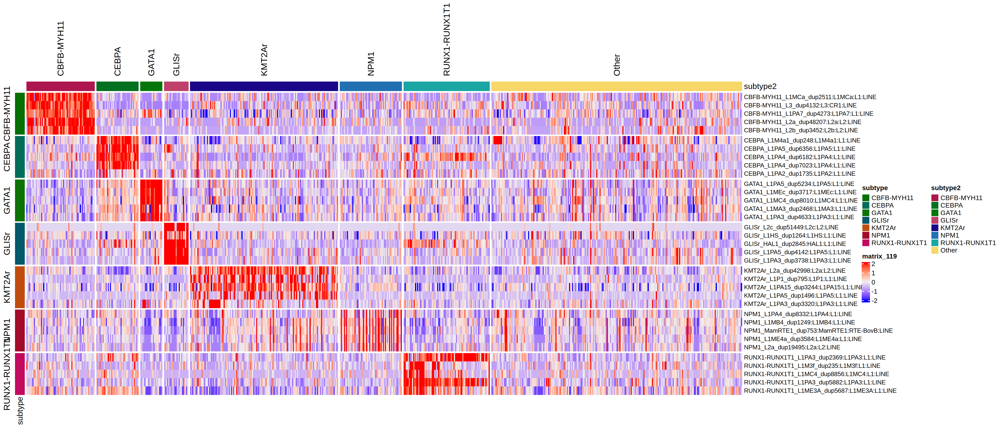

In [783]:
sel = deg_telocal_dt[class_id %in% c('LINE') & logFC > 0 & FDR < .1 & .id %in% subtype_sel, ] %>% group_by(.id) %>% slice_min(FDR, n = 5) %>% as.data.table()
sel[, subtype := .id]
row_ann = sel[, .(rn, subtype, class_id)]
row_ann[, rname := paste0(subtype, '_', rn) ]
row_ann[, subtype := factor(subtype, levels = subtype_sel)]
row_ann = row_ann[order(subtype), ]
row_ann_df = setDF(row_ann[, 2:ncol(row_ann)], rownames = row_ann$rname)
col_ann = dsn_jude[, .(sample_name, subtype)]
col_ann[, subtype2 := subtype ]
col_ann[! subtype %in% subtype_sel, subtype2 := 'Other']
col_ann[, subtype2 := factor(subtype2, levels = lvl)]
col_ann = col_ann[order(subtype), ]
col_ann_df =  setDF(col_ann[, 2:ncol(col_ann)], rownames = col_ann$sample_name) 

plotdat = logcpm_telocal[row_ann$rn, rownames(col_ann_df)]
rownames(plotdat) = rownames(row_ann_df)
plotdat = scale_fun(plotdat)
plotdat[plotdat > 2] = 2
plotdat[plotdat < -2] = -2
column_ha = HeatmapAnnotation(df = col_ann_df[, 'subtype2', drop = F])
row_ha    = rowAnnotation(df = row_ann_df[, 'subtype', drop = F])
args = list(matrix = plotdat, top_annotation = column_ha,  column_split = factor(col_ann_df$subtype2, levels = lvl), show_column_names = F, 
            show_row_names = T, show_column_dend = F, cluster_columns = F,  cluster_rows = F, row_names_gp = grid::gpar(fontsize = 9), 
            show_row_dend = F, column_title_rot = 90, left_annotation = row_ha, row_split = factor(row_ann_df$subtype, levels = (subtype_sel)))
hp = do.call(Heatmap, args)
options(repr.plot.width = 21, repr.plot.height = 9, repr.plot.res = 200)
draw(hp)


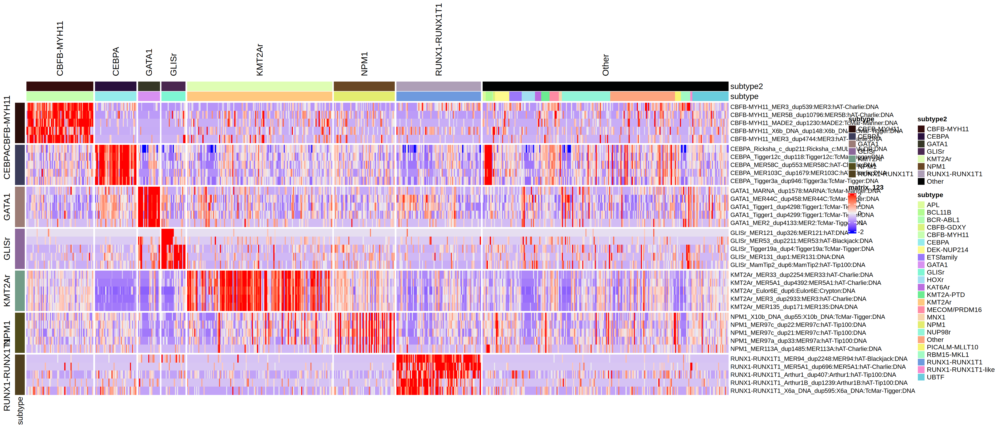

In [791]:
sel = deg_telocal_dt[class_id %in% c('DNA') & logFC > 0 & FDR < .1 & .id %in% subtype_sel, ] %>% group_by(.id) %>% slice_min(FDR, n = 5) %>% as.data.table()
sel[, subtype := .id]
row_ann = sel[, .(rn, subtype, class_id)]
row_ann[, rname := paste0(subtype, '_', rn) ]
row_ann[, subtype := factor(subtype, levels = subtype_sel)]
row_ann = row_ann[order(subtype), ]
row_ann_df = setDF(row_ann[, 2:ncol(row_ann)], rownames = row_ann$rname)
col_ann = dsn_jude[, .(sample_name, subtype)]
col_ann[, subtype2 := subtype ]
col_ann[! subtype %in% subtype_sel, subtype2 := 'Other']
col_ann[, subtype2 := factor(subtype2, levels = lvl)]
col_ann = col_ann[order(subtype), ]
col_ann_df =  setDF(col_ann[, 2:ncol(col_ann)], rownames = col_ann$sample_name) 

plotdat = logcpm_telocal[row_ann$rn, rownames(col_ann_df)]
rownames(plotdat) = rownames(row_ann_df)
plotdat = scale_fun(plotdat)
plotdat[plotdat > 2] = 2
plotdat[plotdat < -2] = -2
column_ha = HeatmapAnnotation(df = col_ann_df[, c('subtype2', 'subtype'), drop = F])
row_ha    = rowAnnotation(df = row_ann_df[, 'subtype', drop = F])
args = list(matrix = plotdat, top_annotation = column_ha,  column_split = factor(col_ann_df$subtype2, levels = lvl), show_column_names = F, 
            show_row_names = T, show_column_dend = F, cluster_columns = F,  cluster_rows = F, row_names_gp = grid::gpar(fontsize = 9), 
            show_row_dend = F, column_title_rot = 90, left_annotation = row_ha, row_split = factor(row_ann_df$subtype, levels = (subtype_sel)))
hp = do.call(Heatmap, args)
options(repr.plot.width = 21, repr.plot.height = 9, repr.plot.res = 200)
draw(hp)


In [796]:
datatable(plotdat[, 1:10])


HTML widgets cannot be represented in plain text (need html)

## annotation of telocal DEG

In [798]:
te_dt = readRDS('/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/collab_Farhan/data/te_dt_may08.rds')
head(te_dt)


chr,rmsk,exon,start,end,width,strand,score,gene_id,transcript_id,family_id,class_id,idd,idd_2
<chr>,<chr>,<chr>,<int>,<int>,<int>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
chr1,UCSC_rmsk,exon,2710,4402,5119,-,.,TAR1,TAR1_dup164,subtelo,Satellite,TAR1_dup164:TAR1:subtelo:Satellite,chr1_2710_4402__TAR1_dup164:TAR1:subtelo:Satellite
chr1,UCSC_rmsk,exon,4083,4533,962,-,.,LTR60B,LTR60B_dup190,ERV1,LTR,LTR60B_dup190:LTR60B:ERV1:LTR,chr1_4083_4533__LTR60B_dup190:LTR60B:ERV1:LTR
chr1,UCSC_rmsk,exon,4534,4660,505,-,.,LTR60B,LTR60B_dup191,ERV1,LTR,LTR60B_dup191:LTR60B:ERV1:LTR,chr1_4534_4660__LTR60B_dup191:LTR60B:ERV1:LTR
chr1,UCSC_rmsk,exon,4664,5263,1304,+,.,L1MC3,L1MC3_dup5932,L1,LINE,L1MC3_dup5932:L1MC3:L1:LINE,chr1_4664_5263__L1MC3_dup5932:L1MC3:L1:LINE
chr1,UCSC_rmsk,exon,5275,5528,1403,+,.,MER34C_v,MER34C_v_dup375,ERV1,LTR,MER34C_v_dup375:MER34C_v:ERV1:LTR,chr1_5275_5528__MER34C_v_dup375:MER34C_v:ERV1:LTR
chr1,UCSC_rmsk,exon,5529,5686,3544,+,.,L1MC3,L1MC3_dup5932,L1,LINE,L1MC3_dup5932:L1MC3:L1:LINE,chr1_5529_5686__L1MC3_dup5932:L1MC3:L1:LINE


In [803]:
txdb = readRDS(file = '~/workspace/t2t_txdb.rds')

In [808]:
getwd()

[1] "/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/pediatrics"

In [818]:
te_sel = deg_telocal_dt[class_id %in% c('LINE') & logFC > 0 & FDR < .1, ]
te_sel = te_dt[idd %in% te_sel$rn, ]
tmp = data.frame(seqname = te_sel$chr, start = te_sel$start, end = te_sel$end, name = te_sel$idd_2)
gr = GRanges(tmp)
saveRDS(gr, file = '/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/pediatrics/gr_line.rds')

te_sel = deg_telocal_dt[class_id %in% c('LTR') & logFC > 0 & FDR < .1, ]
te_sel = te_dt[idd %in% te_sel$rn, ]
tmp = data.frame(seqname = te_sel$chr, start = te_sel$start, end = te_sel$end, name = te_sel$idd_2)
gr = GRanges(tmp)
saveRDS(gr, file = '/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/pediatrics/gr_LTR.rds')

te_sel = deg_telocal_dt[class_id %in% c('DNA') & logFC > 0 & FDR < .1, ]
te_sel = te_dt[idd %in% te_sel$rn, ]
tmp = data.frame(seqname = te_sel$chr, start = te_sel$start, end = te_sel$end, name = te_sel$idd_2)
gr = GRanges(tmp)
saveRDS(gr, file = '/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/pediatrics/gr_dna.rds')

# go to nb_txdbmaker_t2t.ipybn
#gr_anno = annotatePeak(gr, TxDb=txdb, tssRegion=c(-3000, 3000), verbose=FALSE, annoDb = 'org.Hs.eg.db', addFlankGeneInfo = T)
#telocal_anno_dt = as.data.table(gr_anno@anno, keep.rownames = T)
#options(repr.plot.width = 5, repr.plot.height = 3, repr.plot.res = 200)
#plotAnnoBar(gr_anno)

# HSC blueprint DEG telocal and pAML telocal


In [904]:
gr_anno = readRDS(file = '/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/collab_Farhan/data/deg_teloccal_cmp_anno.rds')

In [910]:
plotdat = as.data.table(gr_anno@anno)
plotdat1 = plotdat[annotation == 'Distal Intergenic', ]
plotdat2 = plotdat[annotation != 'Distal Intergenic', ]

In [909]:
tmp1 = deg_telocal_dt[abs(logFC) > 1 & FDR < .1 & rn %in% plotdat1$name, ]
tmp2 = deg_telocal_dt[abs(logFC) > 1 & FDR < .1 & rn %in% plotdat2$name, ]

In [911]:
dim(tmp1)
dim(tmp2)
 

[1] 4290   10

[1] 12723    10

In [912]:
table(tmp1$class_id)
table(tmp2$class_id)


 DNA LINE  LTR 
 103 3556  631 


  DNA  LINE   LTR 
 1216 10129  1378 

In [920]:
t1 = as.data.table(table(tmp1$.id), keep.rownames = T) 
setnames(t1, c('v1', 'DistalIntergenic'))
t2 = as.data.table(table(tmp2$.id), keep.rownames = T) 
setnames(t2, c('v1', 'GeneRegion'))
tt = merge(t1, t2, by = 'v1')
tt[v1 %in% subtype_bar_sel, ]

v1,DistalIntergenic,GeneRegion
<chr>,<int>,<int>
CBFB-MYH11,146,371
CEBPA,372,1102
GATA1,456,1102
GLISr,386,1617
KMT2Ar,199,359
NPM1,303,1596
NUP98r,227,309
Other,77,124
RUNX1-RUNX1T1,308,730


In [907]:
head(deg_telocal_dt)

.id,rn,logFC,logCPM,PValue,FDR,class_id,family_id,gene_id,tx_id
<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>
CBFB-MYH11,LTR90B_dup437:LTR90B:LTR:LTR,3.961352,0.22298796,3.378347e-75,1.137834e-69,LTR,LTR,LTR90B,LTR90B_dup437
CBFB-MYH11,MER51A_dup52:MER51A:ERV1:LTR,4.069559,0.01015551,1.353068e-69,2.278580e-64,LTR,ERV1,MER51A,MER51A_dup52
CBFB-MYH11,L1MCa_dup2511:L1MCa:L1:LINE,3.951593,3.02363543,2.088757e-67,2.344992e-62,LINE,L1,L1MCa,L1MCa_dup2511
CBFB-MYH11,L3_dup4132:L3:CR1:LINE,3.504512,2.49698398,5.802855e-64,4.886033e-59,LINE,CR1,L3,L3_dup4132
CBFB-MYH11,L1PA7_dup4273:L1PA7:L1:LINE,2.905918,6.94637811,2.704159e-63,1.821532e-58,LINE,L1,L1PA7,L1PA7_dup4273
CBFB-MYH11,MLT1A_dup4514:MLT1A:ERVL-MaLR:LTR,3.178018,1.46363839,1.739011e-62,9.761705e-58,LTR,ERVL-MaLR,MLT1A,MLT1A_dup4514


# stem cell TE in Jude cohort

In [62]:
deg_telocal_MEPCMP = readRDS(file = '/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/collab_Farhan/data/deg_telocal_MEPCMP.rds')
deg_MEPCMP = fread(file = '/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/collab_Farhan/data/deg_MEPCMP15Jul.tsv')


## expressioin of stem cell DEG TE in Jude cohort

In [72]:
library(venn)

In [834]:
te_sel = te_dt[idd %in% deg_telocal_MEPCMP[FDR  < .1 & batch == 'CMP', rn], ]


In [881]:
HSC_TElocal  = unique(deg_telocal_MEPCMP[FDR  < .1 & batch == 'CMP' & class_id %in% c('LTR', 'LINE', 'SINE', 'DNA'), rn])
pAML_TElocal = unique(deg_telocal_dt[FDR < .1 & class_id %in% c('LTR', 'LINE', 'SINE', 'DNA'), rn])


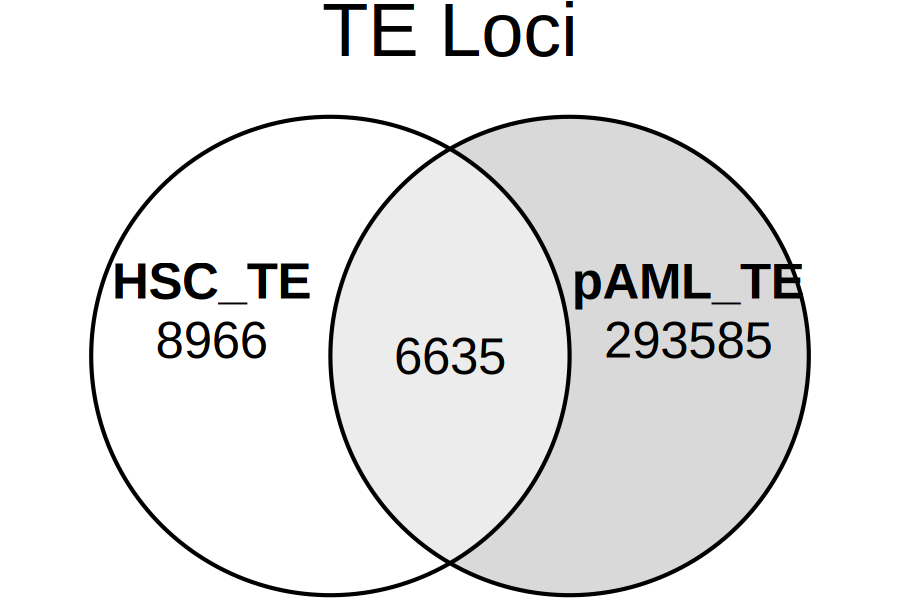

In [882]:
vv = list(HSC_TE  = HSC_TElocal, pAML_TE = pAML_TElocal)
options(repr.plot.width = 3, repr.plot.height = 2, repr.plot.res = 300)
plot(venn(vv), main = 'TE Loci')
#plot(euler(vv, shape = "ellipse"), quantities = FALSE)


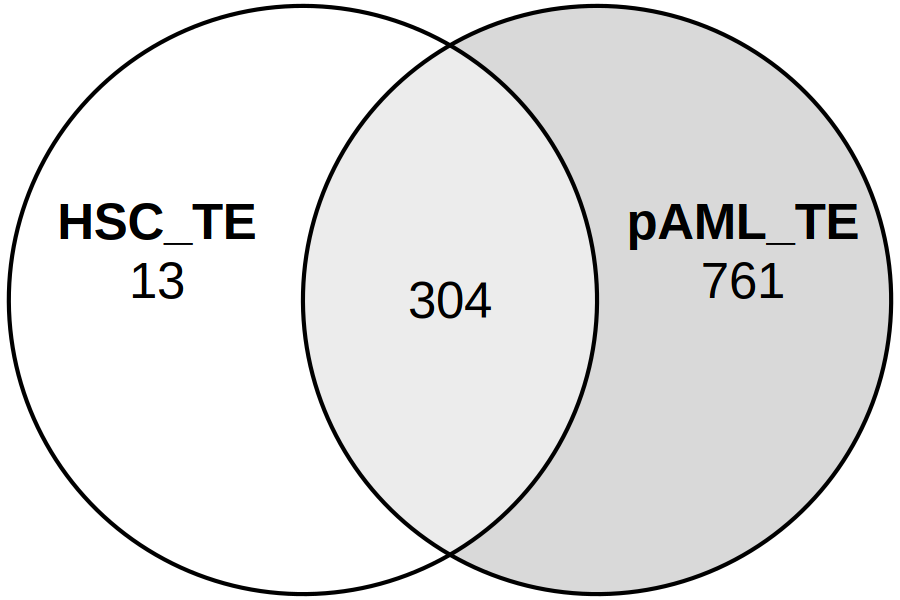

In [931]:
HSC_TE  = unique(deg_MEPCMP[FDR  < .1 & batch == 'CMP' & class_id %in% c('LTR', 'LINE', 'DNA'), rn])
pAML_TE = unique(deg_te_dt[FDR < .1 & class_id %in% c('LTR', 'LINE', 'DNA'), rn])

vv = list(HSC_TE  = HSC_TE, pAML_TE = pAML_TE)
options(repr.plot.width = 3, repr.plot.height = 2, repr.plot.res = 300)
plot(venn(vv)  )
#plot(euler(vv, shape = "ellipse"), quantities = TRUE)


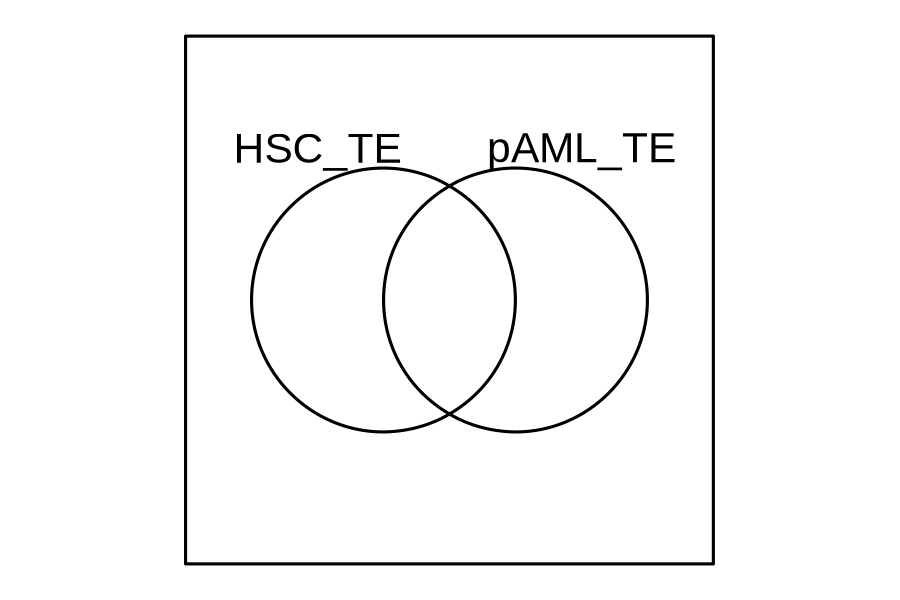

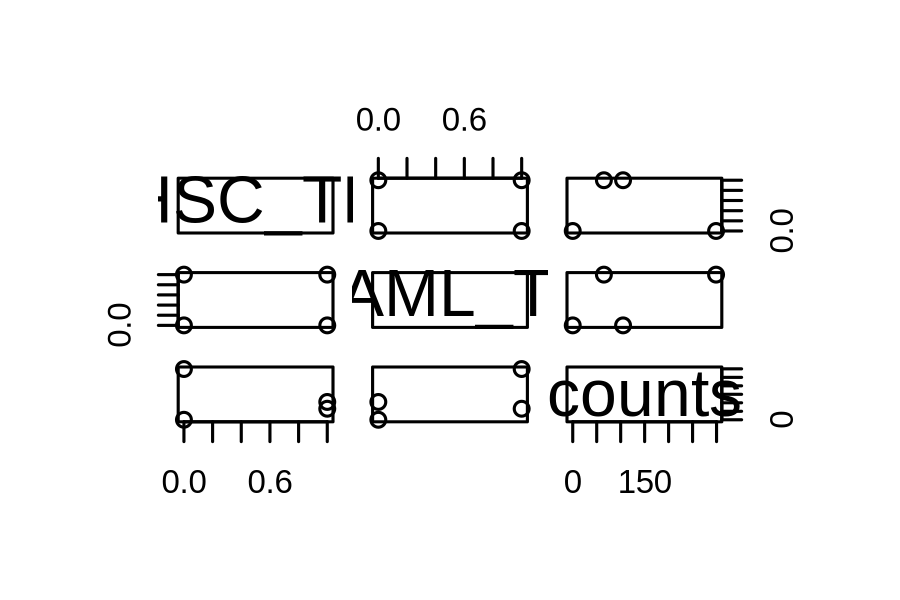

In [73]:
HSC_TE  = unique(deg_MEPCMP[FDR  < .1 & batch == 'CMP' & class_id %in% c('LTR', 'LINE', 'DNA') & abs(logFC) > 1, rn])
pAML_TE = unique(deg_te_dt[FDR < .1 & class_id %in% c('LTR', 'LINE', 'DNA') & abs(logFC) > 1, rn])
vv = list(HSC_TE  = HSC_TE, pAML_TE = pAML_TE)
options(repr.plot.width = 3, repr.plot.height = 2, repr.plot.res = 300)
plot(venn(vv)  )
#plot(euler(vv, shape = "ellipse"), quantities = TRUE)


In [930]:
venn(vv)  

,h,k,a,b,phi
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
HSC_TE,-0.5,0,1,1,1
pAML_TE,0.5,0,1,1,1


In [928]:
pAML_TE = unique(deg_te_dt[FDR < .1 & class_id %in% c('LTR', 'LINE', 'DNA'),])
head(pAML_TE)

.id,rn,logFC,logCPM,PValue,FDR,class_id,family_id,gene_id
<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>
CBFB-MYH11,MER57C1:ERV1:LTR,-8.012651,4.704370,5.195696e-22,6.806362e-19,LTR,ERV1,MER57C1
CBFB-MYH11,MER133A:PIF-Harbinger:DNA,-5.972426,2.671462,1.182422e-20,7.744864e-18,DNA,PIF-Harbinger,MER133A
CBFB-MYH11,Eulor6E:Crypton:DNA,-6.033919,2.737902,3.017031e-20,1.317437e-17,DNA,Crypton,Eulor6E
CBFB-MYH11,MER75B:PiggyBac:DNA,-5.618691,2.487085,3.216321e-19,1.053345e-16,DNA,PiggyBac,MER75B
CBFB-MYH11,LTR22:ERVK:LTR,-6.147317,3.666006,4.832101e-19,1.266010e-16,LTR,ERVK,LTR22
CBFB-MYH11,LTR108d_Mam:ERVL:LTR,-5.970660,2.633814,2.448347e-18,4.824926e-16,LTR,ERVL,LTR108d_Mam


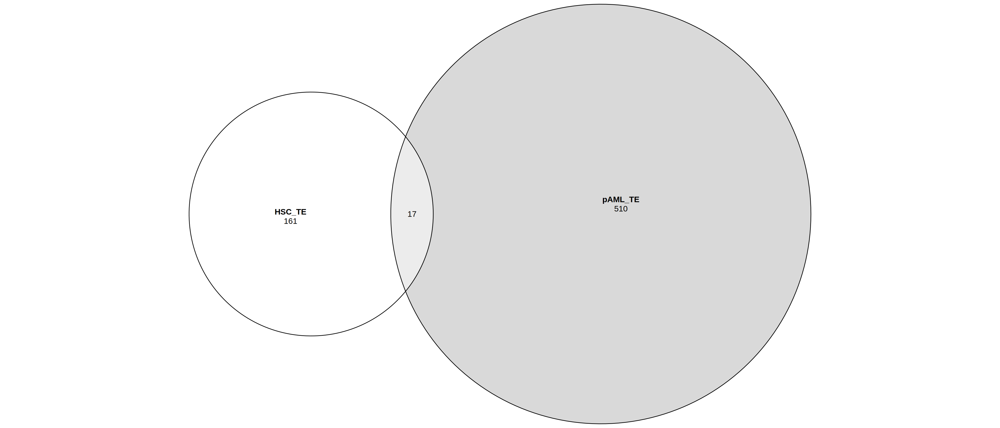

In [865]:
vv = list(HSC_TE  = unique(deg_MEPCMP[FDR  < .1 & batch == 'CMP' & logFC > 0, rn]),
          pAML_TE = unique(deg_te_dt[FDR < .1 & abs(logFC) > 1, rn]))
plot(euler(vv, shape = "ellipse"), quantities = TRUE)


In [74]:
library(eulerr)


Registered S3 method overwritten by 'eulerr':
  method    from  
  plot.venn gplots


Attaching package: ‘eulerr’


The following object is masked from ‘package:venn’:

    venn




In [ ]:
set.seed(1)

s2 <- c(A = 1, B = 2)

plot(venn(s2))
plot(euler(s2), quantities = TRUE)


In [840]:
hsc_te  = deg_telocal_MEPCMP[FDR  < .1 & batch == 'CMP', rn]
paml_te = deg_telocal_dt[FDR < .1, rn]
length(intersect(hsc_te, paml_te))
length(hsc_te)
length(paml_te)


[1] 6635

[1] 15605

[1] 1191536

In [63]:
te_sel = deg_MEPCMP[FDR < .1 & class_id %in% c('LTR', 'LINE', 'DNA'), ]


In [70]:
dim(dsn_sel)

[1] 856  70

In [77]:
head(logcpm_jude_te_combat)

,SJ007022,SJ007030,SJ007034,SJ007110,SJ007122,SJ030118,SJ030324,SJ045742,SJ031259,SJ031302,⋯,SJ062997,SJ061260,SJ063002,SJ067620,SJ001441,SJ045737,SJ000089,SJ001018,SJ031254,SJ061263
(CATTC)n:Satellite:Satellite,3.6968335,3.5362009,0.0000000,2.07384173,3.88082242,1.8242943,2.0107011,3.9824433,2.3431419,3.7162240,⋯,5.8563764,6.90871103,6.1112661,9.1424803,6.1189142,0.0000000,1.2265885,2.2571307,0.9874680,1.79429725
(GAATG)n:Satellite:Satellite,5.0915067,4.8431352,2.3055023,3.30434996,5.01309341,2.3883445,3.0124769,5.1050894,4.2352400,4.8078541,⋯,6.8605243,7.89816550,7.2373414,9.8223483,7.4881855,0.1021066,2.3516700,3.9155758,2.5234936,3.00207067
7SLRNA:srpRNA:srpRNA,0.1988053,0.0000000,0.2720795,0.09531577,2.52435865,0.1905332,0.0000000,0.1146571,0.2063160,1.0153368,⋯,0.1408919,0.02385035,0.5864811,0.9777581,0.2285736,0.1021066,0.1160428,0.4261816,0.1135563,0.03739665
A-rich:Low_complexity:Low_complexity,0.0000000,0.0000000,0.2720795,0.00000000,0.00000000,0.1905332,0.0000000,0.0000000,0.1068429,0.0000000,⋯,0.1408919,0.07039981,0.1158278,1.7459961,0.2285736,0.0000000,0.1160428,0.0000000,0.0000000,0.03739665
ACRO1:acro:Satellite,0.1988053,0.1375183,0.5008981,0.09531577,0.09222955,0.1905332,0.2654193,0.1146571,0.1068429,0.1550835,⋯,0.1408919,0.58503589,0.1158278,5.1806170,0.2285736,0.0000000,0.1160428,1.4427379,0.1135563,0.03739665
ALR/Alpha:centr:Satellite,9.0743992,8.9255678,5.7966209,7.81479391,7.13773506,8.6825075,6.9401333,7.7024537,6.1346131,7.3462272,⋯,8.2775124,8.66045326,7.4391530,10.0979839,9.6961124,7.4079279,8.3859693,7.9387043,8.3484931,8.85092545


In [97]:
dim(dsn_sel_df)
dim(logcpm_jude_te_combat)

[1] 856   1

[1] 1310  670

In [100]:
ov = intersect(colnames(logcpm_jude_te_combat), rownames(dsn_sel_df)) 

In [101]:
te_sel = as.data.frame(deg_te_dt[FDR < 0.1 & logFC > 1,] %>% group_by(.id) %>% slice_min(order_by = FDR, n = 5))
dsn_sel_df = setDF(dsn_sel[, .(subtype)], rownames = dsn_sel$sample_name)
dsn_sel_df$subtype = factor(dsn_sel_df$subtype, levels = subtypes)

plotdat = logcpm_jude_te_combat[te_sel$rn, ov]
plotdat = scale_fun(plotdat)
plotdat[plotdat > 2] = 2
plotdat[plotdat < -2] = -2
#rownames(plotdat) = te_sel$row_name 
column_ha = HeatmapAnnotation(df = dsn_jude_df[, 'subtype', drop = F])
#row_ha    = rowAnnotation(df = te_sel[, '.id', drop = F])
args = list(matrix = plotdat, top_annotation = column_ha, show_column_names = F, #column_split = factor(dsn_sel$subtype), 
            show_row_names = F, show_column_dend = F, cluster_columns = T,  cluster_rows = T, row_names_gp = grid::gpar(fontsize = 7), 
            show_row_dend = F, column_title_rot = 90)#, left_annotation = row_ha) #, row_split = te_sel$.id, row_title_rot = 90)
hp = do.call(Heatmap, args)
options(repr.plot.width = 21, repr.plot.height = 10, repr.plot.res = 200)
draw(hp)


ERROR: Error: object 'dsn_jude_df' not found


# cNMF clustering 

In [185]:
library(NMF)

In [186]:
nmfSeed('nndsvd')

<object of class:  NMFSeed >
name:	 nndsvd 
method:	 <function> 

In [187]:
meth <- nmfAlgorithm(version='R')
meth <- c(names(meth), meth)
meth

brunet         lee      offset       nsNMF 
   "brunet"       "lee"    "offset"     "nsNMF" ".R#brunet"    ".R#lee" ".R#offset"  ".R#nsNMF"

In [218]:
row_sd = apply(logcpm_jude_te, 1, sd) 
summary(row_sd)
plotdat = logcpm_jude_te[row_sd > .65, ]


   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
 0.0000  0.6593  1.0531  1.1210  1.5092  3.2550 

In [219]:
res <- nmf(plotdat, 500, meth, seed=123456)

Compute NMF method 'brunet' [1/8] ... OK
Compute NMF method 'lee' [2/8] ... OK
Compute NMF method 'offset' [3/8] ... OK
Compute NMF method 'nsNMF' [4/8] ... OK
Compute NMF method '.R#brunet' [5/8] ... OK
Compute NMF method '.R#lee' [6/8] ... OK
Compute NMF method '.R#offset' [7/8] ... OK
Compute NMF method '.R#nsNMF' [8/8] ... OK


In [221]:
res

<Object of class: NMFList >
Length: 8 
Method(s): brunet, lee, offset, nsNMF, .R#brunet, .R#lee, .R#offset, .R#nsNMF 
Total timing:
    user   system  elapsed 
19223.38 17053.50 12623.40 

# RIGI

In [168]:
table(dsn_jude$subtype)


               APL             BCL11B           BCR-ABL1          CBFB-GDXY 
                 3                  6                  1                  2 
        CBFB-MYH11              CEBPA         DEK-NUP214          ETSfamily 
                65                 40                 14                 12 
             GATA1              GLISr               HOXr             KAT6Ar 
                21                 23                 13                  6 
         KMT2A-PTD             KMT2Ar       MECOM/PRDM16               MNX1 
                 8                141                  9                  3 
              NPM1             NUP98r              Other      PICALM-MLLT10 
                59                 47                 63                  6 
        RBM15-MKL1      RUNX1-RUNX1T1 RUNX1-RUNX1T1-like               UBTF 
                 9                 82                  2                 35 

[1]   6 670

pdf 
  2

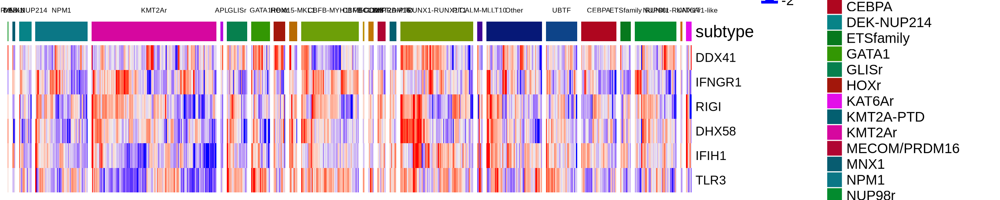

In [167]:
#logcpm_all[rownames(logcpm_all) %in% c('MDA5', 'RIGI', 'LGP2'), , drop = F]
plotdat = logcpm_coding[rownames(logcpm_coding) %in% c('IFIH1', 'RIGI', 'DHX58', 'DDX41', 'TLR3', 'IFNGR1'), dsn_jude$sample_name, drop = F]
dim(plotdat)
plotdat = scale_fun(plotdat) 
plotdat[plotdat > 2] = 2
plotdat[plotdat < -2] = -2
col_ha = HeatmapAnnotation(df = dsn_jude[, 'subtype', drop = F])
hp = Heatmap(plotdat, top_annotation = col_ha, row_names_gp = grid::gpar(fontsize = 9), show_row_names = T, show_column_names = F, column_title_gp = gpar(fontsize = 5), 
        show_column_dend = F, show_row_dend = F, column_split = factor(dsn_jude$subtype))
options(repr.plot.width = 10, repr.plot.height = 2, repr.plot.res = 250)
draw(hp)
fname = '~/WenhuoHu/collab_Farhan/plot/jude_subtype_sensor.pdf'
pdf(file = fname, width = 10, height = 2)
Heatmap(plotdat, top_annotation = col_ha, row_names_gp = grid::gpar(fontsize = 9), show_row_names = T, show_column_names = F, column_title_gp = gpar(fontsize = 5), 
        show_column_dend = F, show_row_dend = F, column_split = factor(dsn_jude$subtype))
dev.off()


# INFGR1 vs LTR

In [150]:
setnames(dsn_jude, 2, 'patientid')

In [159]:
plotdat = as.data.table(t(logcpm_telocal_full[c('IFNGR1', 'THE1A_dup1758:THE1A:ERVL-MaLR:LTR'), ]), keep.rownames = T) 
setnames(plotdat, 3, 'THE1A')
plotdat = merge(plotdat, dsn_jude, by.x = 'rn', by.y = 'patientid', all.x = T)
table(plotdat$THE1A < -4)



FALSE  TRUE 
  284   572 

In [158]:
head(plotdat)

rn,IFNGR1,THE1A,CompBio sampleID,TBID,sample source,SJUID,Subject SJUID,Molecular-class,Defining alteration,⋯,telocal_oo,telocal_eo,telocal_cmd,flagstat_jobname,flagstat_oo,flagstat_eo,flagstat_out,flagstat_cmd,read_nn,group
<chr>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,⋯,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<fct>
SJ000089,6.582147,-4.2225790,SJCBF000089_D2,TB-88-0220,Bone Marrow,SJHBBBHKQ8X,SJHBBGXWF,CBFB-MYH11,CBFB-MYH11,⋯,/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/pediatrics/data/SJ000089/SJ000089_telocal_out,/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/pediatrics/data/SJ000089/SJ000089_telocal_err,"bsub -J telocal_SJ000089 -n 10 -o /research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/pediatrics/data/SJ000089/SJ000089_telocal_out -e /research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/pediatrics/data/SJ000089/SJ000089_telocal_err -P beat -R ""rusage[mem=5GB]"" -W 999:00 "" cd /research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/pediatrics/data/SJ000089/ && /home/whu78/conda3/envs/te/bin/TElocal --sortByPos -b /research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/pediatrics/data/SJ000089/SJ000089_Aligned.sortedByCoord.out.bam --GTF /research/groups/jxugrp/home/common/Lab_Members/SyedAhmad/Projects_Main_Farhan/trimmed_copy_leukemia_samples/testig_new_T2T_GTF/hs1.ncbiRefSeq.gtf --TE /research/groups/jxugrp/home/common/Data_Public/RNA_seq/Blueprint_EGA_Data_EGAD00001000745_Transcriptional_Diversity_Human_Blood_progenitors_Chen_etal_Science_2014/T2T_CHM13_v2_rmsk_TE.gtf.locInd --stranded reverse --project telocal """,flagstat_SJ000089,/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/pediatrics/data/SJ000089/SJ000089flagstat_out,/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/pediatrics/data/SJ000089/SJ000089flagstat_err,/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/pediatrics/data/SJ000089/SJ000089_flagstat,"bsub -J flagstat_SJ000089 -o /research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/pediatrics/data/SJ000089/SJ000089flagstat_out -e /research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/pediatrics/data/SJ000089/SJ000089flagstat_err -P beat -n 30 -R ""rusage[mem=5GB]"" -R span[hosts=1] -W 1:00 "" samtools flagstat /rgs01/reference/restricted/PCGP/GRCh38/PanpAML/FINAL/TRANSCRIPTOME/v2.0.0/BAM/SJCBF000089_D2.RNA-Seq.bam > /research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/pediatrics/data/SJ000089/SJ000089_flagstat """,138051924 + 0 in total (QC-passed reads + QC-failed reads),other
SJ001018,5.626531,0.3361004,SJCBF001018_D1,unknown,unk,unknown,unknown,RUNX1-RUNX1T1,RUNX1-RUNX1T1,⋯,/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/pediatrics/data/SJ001018/SJ001018_telocal_out,/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/pediatrics/data/SJ001018/SJ001018_telocal_err,"bsub -J telocal_SJ001018 -n 10 -o /research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/pediatrics/data/SJ001018/SJ001018_telocal_out -e /research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/pediatrics/data/SJ001018/SJ001018_telocal_err -P beat -R ""rusage[mem=5GB]"" -W 999:00 "" cd /research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/pediatrics/data/SJ001018/ && /home/whu78/conda3/envs/te/bin/TElocal --sortByPos -b /research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/dataset/pediatrics/data/SJ001018/SJ001018_Aligned.sortedByCoord.out.bam --GTF /research/groups/jxugrp/home/common/Lab_Members/SyedAhmad/Projects_Main_Farhan/trimmed_copy_leukemia_samples/testig_new_T2T_GTF/hs1.ncbiRefSeq.gtf --TE /research/group

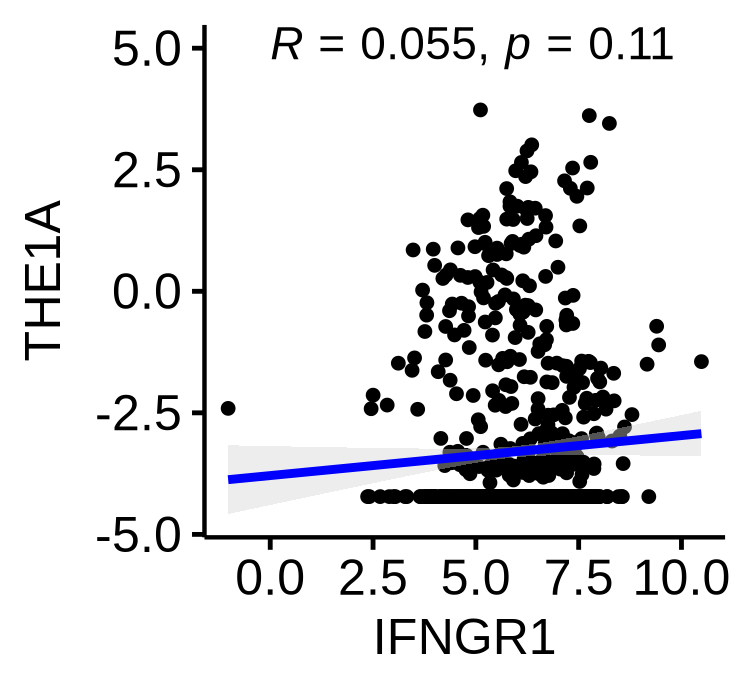

In [162]:
gg = ggscatter(plotdat, x = "IFNGR1", y = "THE1A", size = 1, add = "reg.line",   add.params = list(color = "blue", fill = "lightgray"),  conf.int = TRUE  ) + 
stat_cor(method = "pearson", label.x = 0, label.y = 5) 
gg


In [ ]:
options(repr.plot.width = 2.5, repr.plot.height = 2.3, repr.plot.res = 300)
gg = ggscatter(plotdat[THE1A> -2, ], x = "IFNGR1", y = "THE1A", size = 1, add = "reg.line", add.params = list(color = "blue", fill = "lightgray"),  conf.int = TRUE  ) + 
stat_cor(method = "pearson", label.x = 0, label.y = 5) 
gg


# export data

In [6]:
dsn_jude = readRDS('dsn_jude.rds')

In [9]:
deg_telocal_dt = readRDS('deg_jude_telocal_dt.rds')


In [ ]:
#dsn = fread(file = 'jude_dsn_856cases_sept5.tsv')


In [215]:
fwrite(dsn_sel,                file = 'jude_dsn_856cases_sept5.tsv', sep = '\t')
saveRDS(deg_subtypePCA_coding, file = 'deg_subtypePCA_coding_856cases_subtypePCA.rds') 
saveRDS(deg_subtypePCA_te,     file = 'deg_subtypePCA_te_856cases_subtypePCA.rds') 
saveRDS(deg_te_dt,             file = 'deg_te_dt_856cases_subtypes.rds') 
saveRDS(count_df,              file = 'count_df_856cases.rds')


In [11]:
deg_coding_dt = readRDS('deg_coding_dt_combat.rds')
deg_te_dt = readRDS(file = 'deg_jude_te_dt_combat.rds')
subtypes = readRDS(file = 'subtypes.rds')
dsn_jude = readRDS(file = 'dsn_jude.rds')

deg_coding_dt = readRDS(file = 'deg_coding_dt_combat.rds')
deg_te_dt   = readRDS(file = 'deg_jude_te_dt_combat.rds')

mtx = readRDS('/research_jude/rgs01_jude/groups/jxugrp/home/common/Lab_Members/WenhuoHu/collab_Farhan/data/mtx_all_df.rds')


In [ ]:
saveRDS(count_te_jude_combat, file = 'count_te_jude_combat.rds')
saveRDS(count_coding_jude_combat, file = 'count_coding_jude_combat.rds')


In [13]:
deg_subtypePCA_coding = readRDS('deg_subtypePCA_coding_856cases_subtypePCA.rds')
deg_subtypePCA_te = readRDS('deg_subtypePCA_te_856cases_subtypePCA.rds')
deg_te_dt = readRDS('deg_te_dt_856cases_subtypes.rds')
count_df = readRDS('count_df_856cases.rds')


In [14]:
count_df_te_combat = readRDS(file = 'count_te_jude_combat.rds')
count_coding_jude_combat = readRDS('count_coding_jude_combat.rds') 


In [129]:
logcpm_te = logcpm_fun(count_te_jude_combat) 
logcpm_coding = logcpm_fun(count_coding_jude_combat) 


In [130]:
saveRDS(logcpm_te, file = 'logcpm_te_jude.rds')
saveRDS(logcpm_coding, file = 'logcpm_coding.rds')


In [15]:
logcpm_telocal = readRDS(file = 'logcpm_jude_telocal.rds')


In [16]:
table(dsn_jude$subtype)


               APL             BCL11B           BCR-ABL1          CBFB-GDXY 
                 3                  6                  1                  2 
        CBFB-MYH11              CEBPA         DEK-NUP214          ETSfamily 
                65                 40                 14                 12 
             GATA1              GLISr               HOXr             KAT6Ar 
                21                 23                 13                  6 
         KMT2A-PTD             KMT2Ar       MECOM/PRDM16               MNX1 
                 8                141                  9                  3 
              NPM1             NUP98r              Other      PICALM-MLLT10 
                59                 47                 63                  6 
        RBM15-MKL1      RUNX1-RUNX1T1 RUNX1-RUNX1T1-like               UBTF 
                 9                 82                  2                 35 

In [12]:
dim(dsn_jude)
head2(dsn_jude)

[1] 670  74

CompBio sampleID,CompBio PatientID,TBID,sample source,SJUID
<chr>,<chr>,<chr>,<chr>,<chr>
SJCBF022_D,SJ007022,TB-03-2566,Peripheral Blood,SJHBBBCNKJK
SJCBF030_D,SJ007030,TB-97-1197,Bone Marrow,SJHBBBHD3NS
SJCBF034_D,SJ007034,TB-03-1660,Bone Marrow,SJHBBBJ96HD


In [13]:
saveRDS(dsn_jude[, .(`CompBio sampleID`, bam_file_id)], file = 'jude_670cases_bam.rds')